## Imports

In [1]:
%load_ext autoreload
%autoreload 2

import cleanlab
from cleanlab.rank import get_label_quality_scores, get_label_quality_ensemble_scores
from cleanlab.internal.label_quality_utils import get_normalized_entropy
import sys
import numpy as np
import pandas as pd
from pathlib import Path
from sklearn.metrics import roc_auc_score, f1_score, precision_score, recall_score, precision_recall_curve, accuracy_score, log_loss, auc
from matplotlib import pyplot as plt
import copy

sys.path.insert(0, "../")
from eval_metrics import lift_at_k
from active_learning_scores import least_confidence
from experimental_scores import probability_mass_above_given_label_score

# experimental version of label quality ensemble scores with additional weighting schemes
from label_quality_ensemble_scores_experimental import get_label_quality_ensemble_scores_experimental

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

### Models

In [2]:
models = [
    "resnet18",
    "resnet50d",
    "efficientnet_b1",
    "twins_pcpvt_base",
    "swin_base_patch4_window7_224",
]

### Dictionaries to map to display names

In [3]:
# dictionaries to map to display name

method_adjust_pred_probs_display_dict = {
    "self_confidence-False": "Self Confidence",
    "self_confidence-True": "Adjusted Self Confidence",
    "normalized_margin-False": "Normalized Margin",
    "normalized_margin-True": "Adjusted Normalized Margin",
    "confidence_weighted_entropy-False": "Confidence Weighted Entropy",
    "entropy-False": "Entropy",
    "least_confidence-False": "Least Confidence",
    "magl-False": "Mass Above Given Label",
    "penalized_confidence-False": "Penalized Confidence",
    "rank_penalized_confidence-False": "Rank Penalized Confidence",
    "balanced_entropic_confidence-False": "Balanced Entropic Confidence",
    "entropic_confidence-False": "Entropic Confidence",
    "openset_score-False": "Openset Score",
    "openset_score-True": "Adjusted Openset Score",
    "mutual_info-False": "MI Confidence"
}

model_display_name_dict = {
    "swin_base_patch4_window7_224": "Swin Transformer",
    "twins_pcpvt_base": "Twins PCPVT",
    "efficientnet_b1": "EfficientNet-B1",
    "resnet50d": "ResNet-50d",
    "resnet18": "ResNet-18",
}

## Load files from experiments
**Note:** we can refactor the code later to make it more concise but for now it reads the .npy files for each dataset within the for-loop

In [39]:
# TODO Add food-verified-train import

In [40]:
# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/cifar-10n-agg/results/cifar-10n-aggregate.zip'
# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/cifar-10n-agg/xval-results/cifar-10n-aggregate-xval.zip'

# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/cifar-10n-worst/results/cifar-10n-worst.zip'
# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/cifar-10n-worst/xval-results/cifar-10n-worst-xval.zip'

# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/cifar-10s/results/cifar-10s.zip'
# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/cifar-10s/xval-results/cifar-10s-xval.zip'

# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/roman-numeral/results/roman-numeral.zip'
# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/roman-numeral/xval-results/roman-numeral-xval.zip'

# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/food-101n/results/food-101n.zip'
# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/food-101n/xval-results/food-101n-xval.zip'

# !wget -nc 'https://cleanlab-public.s3.amazonaws.com/LabelErrorDetectionBenchmarks/food-101n/data/verified_train.tsv'

In [41]:
# !unzip -d cifar-10n-aggregate cifar-10n-aggregate.zip
# !unzip -d cifar-10n-aggregate-xval cifar-10n-aggregate-xval.zip
# !unzip -d cifar-10n-worst cifar-10n-worst.zip
# !unzip -d cifar-10n-worst-xval cifar-10n-worst-xval.zip
# !unzip -d cifar-10s cifar-10s.zip
# !unzip -d cifar-10s-xval cifar-10s-xval.zip
# !unzip -d roman-numeral roman-numeral.zip
# !unzip -d roman-numeral-xval roman-numeral-xval.zip
# !unzip -d food-101n food-101n.zip
# !unzip -d food-101n-xval food-101n-xval.zip

In [4]:
%%time

experiments = []

for xval in ["-xval"]:
    for model in models:
        print(model, xval)

        #### Andrew Ng DCAI Roman Numerals ####

        # read numpy files
        numpy_out_folder = f"./roman-numeral{xval}/roman-numeral_train_val_dataset_cv_{model}/"
        pred_probs = np.load(numpy_out_folder + "pred_probs.npy")
        labels = np.load(numpy_out_folder + "noisy_labels.npy")
        images = np.load(numpy_out_folder + "images.npy", allow_pickle=True)
        label_errors_mask = np.load(numpy_out_folder + "label_errors_mask.npy")

        # store results of experiment
        experiment_results = {
            "dataset": "roman-numeral",
            "model": model,
            "pred_probs": pred_probs,
            "labels": labels,
            "images": images,
            "label_errors_mask": label_errors_mask,
            "type_train": xval,
        }
        experiments.append(experiment_results)


        #### Cifar-10n-worst

        # read numpy files
        numpy_out_folder = f"./cifar-10n-worst{xval}/cifar-10n-png_noise_type_worst_cv_{model}/"
        pred_probs = np.load(numpy_out_folder + "pred_probs.npy")
        labels = np.load(numpy_out_folder + "noisy_labels.npy")
        true_labels = np.load(numpy_out_folder + "true_labels.npy")
        images = np.load(numpy_out_folder + "images.npy", allow_pickle=True)

        label_errors_mask = (true_labels != labels) # boolean mask of label errors

        # store results of experiment
        experiment_results = {
            "dataset": "cifar-10n-worst",
            "model": model,
            "pred_probs": pred_probs,
            "labels": labels,
            "images": images,
            "label_errors_mask": label_errors_mask,
            "type_train": xval,
        }
        experiments.append(experiment_results)


        #### Cifar-10n-aggregate

        # read numpy files
        numpy_out_folder = f"./cifar-10n-aggregate{xval}/cifar-10n-png_noise_type_aggre_cv_{model}/"
        pred_probs = np.load(numpy_out_folder + "pred_probs.npy")
        labels = np.load(numpy_out_folder + "noisy_labels.npy")
        true_labels = np.load(numpy_out_folder + "true_labels.npy")
        images = np.load(numpy_out_folder + "images.npy", allow_pickle=True)

        label_errors_mask = (true_labels != labels) # boolean mask of label errors

        # store results of experiment
        experiment_results = {
            "dataset": "cifar-10n-aggregate",
            "model": model,
            "pred_probs": pred_probs,
            "labels": labels,
            "images": images,
            "label_errors_mask": label_errors_mask,
            "type_train": xval,
        }
        experiments.append(experiment_results)


        #### Cifar-10

        # synthetic noise amount 20% and sparsity 40% (as defined in confident learning paper)

        # read numpy files
        numpy_out_folder = f"./cifar-10s{xval}/cifar10_train_dataset_noise_amount_0.2_sparsity_0.4_cv_{model}/"
        pred_probs = np.load(numpy_out_folder + "pred_probs.npy")
        labels = np.load(numpy_out_folder + "noisy_labels.npy")
        true_labels = np.load(numpy_out_folder + "true_labels.npy")
        images = np.load(numpy_out_folder + "images.npy", allow_pickle=True)

        label_errors_mask = (true_labels != labels) # boolean mask of label errors

        # store results of experiment
        experiment_results = {
            "dataset": "cifar-10",
            "model": model,
            "pred_probs": pred_probs,
            "labels": labels,
            "images": images,
            "label_errors_mask": label_errors_mask,
            "type_train": xval,
        }
        experiments.append(experiment_results)


        #### Food-101n

        # we only have verified labels for ~50K images so we have to evaluate within this subset

        # read numpy files
        numpy_out_folder = f"./food-101n{xval}/food-101n_cv_{model}/"
        pred_probs = np.load(numpy_out_folder + "pred_probs.npy")
        labels = np.load(numpy_out_folder + "noisy_labels.npy")
        images = np.load(numpy_out_folder + "images.npy", allow_pickle=True)

        # read verified training labels
#         path_verified_train = "./food-101n/verified_train.tsv"
        path_verified_train = "./verified_train.tsv"
        df_verified_train = pd.read_csv(path_verified_train, sep='\t')

        # instantiate DataFrame with all training data
        df_image_paths = pd.DataFrame({
            "class_name/key": pd.Series(images).map(lambda f: "/".join(Path(f).parts[-2:]))
        })

        # join to append verification_label column
        df_image_paths_w_verified = df_image_paths.merge(df_verified_train, on="class_name/key", how="left")

        # subset of data with verified labels
        verified_subset_mask = ~df_image_paths_w_verified.verification_label.isnull().values

        # filter on verified subset
        pred_probs = pred_probs[verified_subset_mask]
        labels = labels[verified_subset_mask]
        images = images[verified_subset_mask]
        
        if max(labels) > 100:
            labels = np.array([label - 1 if label > 59 else label for label in labels])

        # boolean mask of label errors
        label_errors_mask = df_image_paths_w_verified["verification_label"].values[verified_subset_mask] == 0

        # store results of experiment
        experiment_results = {
            "dataset": "food-101n",
            "model": model,
            "pred_probs": pred_probs,
            "labels": labels,
            "images": images,
            "label_errors_mask": label_errors_mask,
            "type_train": xval,
        }
        experiments.append(experiment_results)

resnet18 -xval
resnet50d -xval
efficientnet_b1 -xval
twins_pcpvt_base -xval
swin_base_patch4_window7_224 -xval
CPU times: user 9.06 s, sys: 875 ms, total: 9.94 s
Wall time: 9.93 s


In [5]:
xval_experiments = experiments[:len(experiments)//2].copy()
noxval_experiments = experiments[len(experiments)//2:].copy()

## Evaluate all results from individual models

In [6]:
# Idea present MAGL as good and then two alternative ways taking into account where ranking of label confidence is counted

# Present agaist MAGL/Self-confidence

# Real Start

In [7]:
from cleanlab.internal.label_quality_utils import get_normalized_entropy
from sklearn.metrics import mutual_info_score
from scipy.stats import chi2_contingency #mi

def penalized_confidence(labels, pred_probs, adjust_pred_probs=False):
#     self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
#     given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
#     given_label_prob = np.repeat(given_label_prob[:,np.newaxis], pred_probs.shape[1], axis=1)
#     more_likeley = pred_probs >= given_label_prob # >= accounts for J+1 
#     J = np.sum(more_likeley, axis=1)
#     return self_confidence / J

    alpha=0.50
    mask = pred_probs.copy()
    mask[np.arange(mask.shape[0]), labels] = -1
    pred_probs_prime = mask[mask != -1]
    pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))
    normalized_entropy = get_normalized_entropy(pred_probs_prime)
    
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
    given_label_prob = np.repeat(given_label_prob[:,np.newaxis], pred_probs.shape[1], axis=1)
    more_likeley = pred_probs >= given_label_prob # >= accounts for J+1 
    J = np.sum(more_likeley, axis=1)
    K = len(set(labels))
    rank  = ((K - J) / K ) * normalized_entropy
    return alpha * self_confidence + (1 - alpha) * rank
    

def rank_penalized_confidence(labels, pred_probs, adjust_pred_probs=False, alpha=0.50):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
    given_label_prob = np.repeat(given_label_prob[:,np.newaxis], pred_probs.shape[1], axis=1)
    more_likeley = pred_probs >= given_label_prob # >= accounts for J+1 
    J = np.sum(more_likeley, axis=1)
    K = len(set(labels))
    rank  = (K - J) / K
    return alpha * self_confidence + (1 - alpha) * rank

# def ratio_confidence(labels, pred_probs, adjust_pred_probs=False):
#     self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
#     given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
#     next_most_likeley_label_prob = 
#     J = given_label_prob / next_most_likeley_label_prob
#     given_label_prob = np.repeat(given_label_prob[:,np.newaxis], pred_probs.shape[1], axis=1)
#     more_likeley = pred_probs >= given_label_prob # >= accounts for J+1 
#     J = np.sum(more_likeley, axis=1)
#     return self_confidence / J

def mutual_info(labels, pred_probs, adjust_pred_probs=False):
    print(pred_probs.shape, np.min(pred_probs), np.max(pred_probs))
    mi = mutual_info_score(labels_true=labels, labels_pred=pred_probs.argmax(axis=1), contingency=None)
    print(mi.shape, np.min(mi), np.max(mi))
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)    
    return self_confidence / mi

# Use self_confidence of p^ where for each example: 
# p^ = (K+1)-dimensional vector, first K entries correspond to our K classes, final entry correponds to an “other” class.
# For i-th example: 
# first K entries of p^ = pred_probs[i]*p_in & final entry = (1-p_in)
# Here p_in = probability that one of the K classes is appropriate, so 1-p_in = probability that none are (class should be “other”).  
# For now, can use heuristic that p_in = max(pred_probs[i]) which is a common choice in open-set cognition

def openset_score(labels, pred_probs, adjust_pred_probs=False):
    p_in = np.amax(pred_probs, axis=1)
    p_hat = np.zeros((pred_probs.shape[0], pred_probs.shape[1]+1))
    p_hat[:,:-1] = pred_probs * p_in[:,np.newaxis]
    p_hat[:,-1] = 1 - p_in
    self_confidence = get_label_quality_scores(labels, p_hat, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    print(np.min(self_confidence),np.max(self_confidence), np.mean(self_confidence))
    return self_confidence

def openset_entropy_score(labels, pred_probs, adjust_pred_probs=False):
    # conf weighted entropy but stronger adj
    p_in = 1.0 - get_normalized_entropy(pred_probs)
    p_hat = np.zeros((pred_probs.shape[0], pred_probs.shape[1]+1))
    p_hat[:,:-1] = pred_probs * p_in[:,np.newaxis]
    p_hat[:,-1] = 1 - p_in
    self_confidence = get_label_quality_scores(labels, p_hat, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    return self_confidence
#     mask = pred_probs.copy()
#     mask[np.arange(mask.shape[0]), labels] = -1
#     pred_probs_prime = mask[mask != -1]
#     pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))

#     p_in = np.amax(pred_probs, axis=1)
    
#     p_hat = np.zeros((pred_probs.shape[0], pred_probs.shape[1]+1))
#     p_hat[:,:-1] = pred_probs * p_in[:,np.newaxis]
#     p_hat[:,-1] = 1 - p_in
    
#     self_confidence = get_label_quality_scores(labels, p_hat, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    
#     normalized_entropy = get_normalized_entropy(pred_probs_prime)
#     x = np.abs(0.5 - normalized_entropy)
#     self_confidence = (self_confidence / x ) * 0.5
#     print(np.min(self_confidence),np.max(self_confidence), np.mean(self_confidence))
#     return self_confidence

# Idea we are allowing an extra set that encompasses both the true prediction and none of the above
def openset_entropy_prime_score(labels, pred_probs, adjust_pred_probs=False):
    mask = pred_probs.copy()
    mask[np.arange(mask.shape[0]), labels] = -1
    pred_probs_prime = mask[mask != -1]
    pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))
    
    p_in = np.amax(pred_probs, axis=1)
    
    p_hat = np.zeros((pred_probs_prime.shape[0], pred_probs_prime.shape[1]+1))
    p_hat[:,:-1] = pred_probs_prime * p_in[:,np.newaxis]
    p_hat[:,-1] = 1 - p_in
    
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    
    normalized_entropy = get_normalized_entropy(p_hat)
    x = np.abs(0.5 - normalized_entropy)
    self_confidence = (self_confidence / x ) * 0.5
    print(np.min(self_confidence),np.max(self_confidence), np.mean(self_confidence))
    
    return self_confidence

def entropic_confidence(labels, pred_probs, adjust_pred_probs=False):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    mask = pred_probs.copy()
    mask[np.arange(mask.shape[0]), labels] = -1
    pred_probs_prime = mask[mask != -1]
    pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))
    pred_probs_prime = pred_probs_prime / np.sum(pred_probs_prime, axis=1)[:,np.newaxis]

    normalized_entropy = get_normalized_entropy(pred_probs_prime)
    return self_confidence / normalized_entropy
#     x = np.abs(0.5 - normalized_entropy)
#     return (self_confidence / x ) * 0.5

# p_y + A * c(p') where:
# p_y = the probability of given label in original pred_prob vector
#  p' = the renormalized probability vector for this example after removing the given label y from the pred_prob for this example
#  c(p') = min { H(p'), 1-H(p') }
# with H= normalized_entropy
# A  = hyperparameter, say try: 0.001, 0.01, 0.1, 1 
                          
def balanced_entropic_confidence(labels, pred_probs, adjust_pred_probs=False, alpha=1):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    mask = pred_probs.copy()
    mask[np.arange(mask.shape[0]), labels] = -1
    pred_probs_prime = mask[mask != -1]
    pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))
    pred_probs_prime = pred_probs_prime / np.sum(pred_probs_prime, axis=1)[:,np.newaxis]

    normalized_entropy = get_normalized_entropy(pred_probs_prime)
    
    given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
    c = np.amin([normalized_entropy, 1 - normalized_entropy], axis=0)
    return given_label_prob + alpha * c

# def likelihood_ratio(labels, pred_probs, adjust_pred_probs=False):
#     # p_k = p(marginal over classes k), p_y = pred probs
#     p_k = np.array([np.sum(labels == k)/len(labels) for k in set(labels)])
#     p_k = np.repeat(p_k[np.newaxis], repeats=len(labels), axis=0)
#     p_k = np.log(p_k)
#     likeleyhood_ratio_score = p_k - np.log(pred_probs)
#     return np.mean(likeleyhood_ratio_score, axis=1)

In [8]:
from sklearn.base import BaseEstimator, ClassifierMixin
from mapie.classification import MapieClassifier
from sklearn.model_selection import train_test_split
from sklearn.utils.validation import check_X_y, check_array, check_is_fitted
from sklearn.utils.multiclass import unique_labels

class FakeClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, pred_probs=None):
        self.pred_probs = pred_probs

    def predict(self, X):
        print('predict called')
        return self.pred_probs
        
    def fit(self, X, y):
        print('fit called')
        X, y = check_X_y(X, y)
        self.classes_ = unique_labels(y)

        self.X_ = X
        self.y_ = y
        return self

    def predict_proba(self, X):
        print(f'predict_proba called {X.shape}, {self.pred_probs.shape}')
        return self.pred_probs

In [9]:
def conformal_score_adjust(labels, pred_probs, adjust_pred_probs=False, alpha=0.01):
    centers = [(0, 3.5), (-2, 0), (2, 0)]
    covs = [np.eye(2), np.eye(2)*2, np.diag([5, 1])]
    x_min, x_max, y_min, y_max, step = -6, 8, -6, 8, 0.1
    n_samples = len(labels)
    n_classes = pred_probs.shape[1]
    np.random.seed(42)
    X = np.random.random((n_samples,n_classes))
    y = np.random.randint(low=0, high=10, size=(n_samples,))

    X_train_cal, X_test, y_train_cal, y_test = X, X.copy(), y, y.copy()
    X_train, X_cal, y_train, y_cal = X, X.copy(), y, y.copy()

    xx, yy = np.meshgrid(
        np.arange(x_min, x_max, step), np.arange(x_min, x_max, step)
    )
    X_test_mesh = np.stack([xx.ravel(), yy.ravel()], axis=1)

    clf = FakeClassifier(pred_probs)
    clf.fit(pred_probs, labels)
    mapie_score = MapieClassifier(estimator=clf, cv="prefit", method="score")
    mapie_score.fit(X_cal, y_cal)
    alpha2 = np.arange(0.02, 0.98, 0.02)
    _, y_ps_score2 = mapie_score.predict(X_test, alpha=alpha2)
    
    widths_score = np.sum(y_ps_score2, axis=1)
    widths_score = np.mean(widths_score, axis=1)
    
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    
    return self_confidence + alpha * widths_score

def conformal_score(labels, pred_probs, adjust_pred_probs=False):
    # fake data copy paste for conformal score (to pass mapie internal checks)
    centers = [(0, 3.5), (-2, 0), (2, 0)]
    covs = [np.eye(2), np.eye(2)*2, np.diag([5, 1])]
    x_min, x_max, y_min, y_max, step = -6, 8, -6, 8, 0.1
    n_samples = len(labels)
    n_classes = pred_probs.shape[1]
    np.random.seed(42)
    X = np.random.random((n_samples,n_classes))
    y = np.random.randint(low=0, high=10, size=(n_samples,))

    X_train_cal, X_test, y_train_cal, y_test = X, X.copy(), y, y.copy()
    X_train, X_cal, y_train, y_cal = X, X.copy(), y, y.copy()

    xx, yy = np.meshgrid(
        np.arange(x_min, x_max, step), np.arange(x_min, x_max, step)
    )
    X_test_mesh = np.stack([xx.ravel(), yy.ravel()], axis=1)
    
    # actual conformal score
    clf = FakeClassifier(pred_probs)
    clf.fit(pred_probs, labels)
    mapie_score = MapieClassifier(estimator=clf, cv="prefit", method="score")
    mapie_score.fit(X_cal, y_cal)
    alpha2 = np.arange(0.02, 0.98, 0.02)
    _, y_ps_score2 = mapie_score.predict(X_test, alpha=alpha2)
    
    widths_score = np.sum(y_ps_score2, axis=1)
    widths_score = np.mean(widths_score, axis=1)
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    
    return self_confidence * widths_score


In [10]:
from mapie.metrics import classification_mean_width_score
from sklearn.metrics.pairwise import euclidean_distances

def magl_mult(labels, pred_probs, adjust_pred_probs=False):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    magl = np.sum(np.clip(pred_probs - self_confidence[:,np.newaxis], a_min=0, a_max=None), axis=1)
    return self_confidence * (1 - magl)

def magl_adjust(labels, pred_probs, adjust_pred_probs=False, alpha=0.0003):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    magl = np.sum(np.clip(pred_probs - self_confidence[:,np.newaxis], a_min=0, a_max=None), axis=1)
    return (1-alpha) * self_confidence + alpha * (1-magl)

def likelihood_ratio(labels, pred_probs, adjust_pred_probs=False):
    p_y = pred_probs[np.arange(pred_probs.shape[0]), labels]
    p_y = np.repeat(p_y[:,np.newaxis], pred_probs.shape[1], axis=1)
    likeleyhood_ratio_score = np.log(pred_probs) - np.log(p_y)
    return 1 - np.mean(likeleyhood_ratio_score, axis=1)

def likelihood_confidence_ratio(labels, pred_probs, adjust_pred_probs=False, alpha=0.0003):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    likeleyhood_ratio_score = likelihood_ratio(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
    return (1-alpha) * self_confidence + alpha * (1 - likeleyhood_ratio_score)

def confidence_with_noclass(labels, pred_probs, adjust_pred_probs=False):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    p_k = np.array([np.sum(labels == k)/len(labels) for k in set(labels)])
    p_none = np.prod(1 - p_k)
    return self_confidence * (1 - p_none)

def confidence_with_noclass_entropy(labels, pred_probs, adjust_pred_probs=False):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    normalized_entropy = get_normalized_entropy(pred_probs)
    c = np.mean(np.max(pred_probs, axis=1)) / np.mean(1 - normalized_entropy)
    p_none = normalized_entropy * c
    return self_confidence * (1 - p_none)

def confidence_with_noclass_gap(labels, pred_probs, adjust_pred_probs=False):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    normalized_entropy = get_normalized_entropy(pred_probs)
    c = np.mean(np.max(pred_probs, axis=1)) / np.mean(1 - normalized_entropy)
    p_diff = np.partition(pred_probs, -2, axis=1)[:,-2:]
    p_none = c * (p_diff[:,1] - p_diff[:,0])
    return self_confidence * (p_none)

def centroid_distance(labels, pred_probs, adjust_pred_probs=False):
    J = [np.where(labels == k)[0] for k in range(len(set(labels)))]
    J_y = [J[int(label)] for label in labels]
    vector_y = np.array([np.mean(pred_probs[J_y[i]], axis=0) for i in range(len(labels))])
    score = -1 * np.linalg.norm(pred_probs-vector_y, axis=1)
    return score

def epistemic_uncertainty(labels, pred_probs_list, adjust_pred_probs=False, alpha=0.1):
    # e_uncertainty = disagreement between individual models’ pred_probs
    self_confidence_list = []
    pred_probs_avg = np.squeeze(np.array(pred_probs_list).mean(axis=0))
    e_uncertainty = []
    
    for pred_probs in pred_probs_list:
        self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
        self_confidence_list.append(self_confidence)
        e_uncertainty.append(euclidean_distances(pred_probs_avg, pred_probs))
        
    self_confidence_list = np.array(self_confidence_list)
    self_confidence = self_confidence_list.mean(axis=1)
    
    e_uncertainty = np.array(e_uncertainty)
    e_uncertainty = e_uncertainty.mean(axis=1)
    
    score = self_confidence + alpha * (0.5 - self_confidence) * e_uncertainty
    return score
    

In [11]:
# dictionaries to map to display name
method_adjust_pred_probs_display_dict = {
    "self_confidence-False": "Self Confidence",
    "self_confidence-True": "Adjusted Self Confidence",
    "normalized_margin-False": "Normalized Margin",
    "normalized_margin-True": "Adjusted Normalized Margin",
    "confidence_weighted_entropy-False": "Confidence Weighted Entropy",
    "entropy-False": "Entropy",
    "least_confidence-False": "Least Confidence",
    "magl-False": "Mass Above Given Label",
    "penalized_confidence-False": "Penalized Confidence",
    "rank_penalized_confidence-False": "Rank Penalized Confidence",
    "balanced_entropic_confidence-False": "Balanced Entropic Confidence",
    "entropic_confidence-False": "Entropic Confidence",
    "openset_score-False": "Openset Score",
    "openset_entropy_score-False": "Openset Entropy Score",
    "openset_entropy_prime_score-False": "Openset Entropy Prime Score",
    "mutual_info-False": "MI Confidence",
    "magl_mult-False": "MAGL mult",
    "magl_adjust-False": "MAGL adjust",
    "likelihood_ratio-False": "Likelihood Ratio",
    "likelihood_confidence_ratio-False": "Likelihood Confidence Ratio",
    "confidence_with_noclass-False": "CWNC",
    "confidence_with_noclass_entropy-False": "CWNC Entropy",
    "confidence_with_noclass_gap-False": "CWNC Gap",
    "centroid_distance-False": "Centroid Distance",
    "conformal_score-False": "Conformal Score",
    "conformal_score_adjust-False": "Conformal Score Adjust",
    "epistemic_uncertainty-False": "Epistemic Uncertainty",
}

model_display_name_dict = {
    "swin_base_patch4_window7_224": "Swin Transformer",
    "twins_pcpvt_base": "Twins PCPVT",
    "efficientnet_b1": "EfficientNet-B1",
    "resnet50d": "ResNet-50d",
    "resnet18": "ResNet-18",
}

In [25]:
%%time

def eval_exp(experiments, score_params):
    evaluations = []
    precision_recall_curves = [] # store this separately
    accuracy_list = []

    for experiment in experiments:
        
        # experiment results
        dataset = experiment["dataset"]
        model = experiment["model"]
        print(dataset, model)
        pred_probs = experiment["pred_probs"]
        labels = experiment["labels"]
        images = experiment["images"]
        label_errors_target = experiment["label_errors_mask"]
        type_train = experiment["type_train"]

        accuracy = {
            "dataset": dataset,
            "model": model,
            "cv_accuracy": (pred_probs.argmax(axis=1) == labels).mean()
        }

        accuracy_list.append(accuracy)

        # finding label issues (score param agnostic)
        find_label_issues = cleanlab.filter.find_label_issues(labels, pred_probs, filter_by='confident_learning')
        num_label_issues = cleanlab.count.num_label_issues(labels, pred_probs)

        for score_param in score_params:        
            # compute scoring method
            method, adjust_pred_probs, alpha = score_param
            
            if method == "epistemic_uncertainty":
                continue #ensemble methods

            if method == "magl":
                label_quality_scores = probability_mass_above_given_label_score(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=alpha)
            elif method == "penalized_confidence":
                label_quality_scores = penalized_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method == "entropic_confidence":
                label_quality_scores = entropic_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif "balanced_entropic_confidence" in method:
                label_quality_scores = balanced_entropic_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=alpha)
            elif "rank_penalized_confidence" in method:
                label_quality_scores = rank_penalized_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=alpha)
            elif method == "openset_score":
                label_quality_scores = openset_score(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method == "openset_entropy_score":
                label_quality_scores = openset_entropy_score(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method == "openset_entropy_prime_score":
                label_quality_scores = openset_entropy_prime_score(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method =="mutual_info":
                label_quality_scores = mutual_info(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method =="magl_mult":
                label_quality_scores = magl_mult(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method=="magl_adjust":
                label_quality_scores = magl_adjust(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method=="likelihood_ratio":
                label_quality_scores = likelihood_ratio(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method=="likelihood_confidence_ratio":
                label_quality_scores = likelihood_confidence_ratio(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method=="confidence_with_noclass":
                label_quality_scores = confidence_with_noclass(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method=="confidence_with_noclass_entropy":
                label_quality_scores = confidence_with_noclass_entropy(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method=="confidence_with_noclass_gap":
                label_quality_scores = confidence_with_noclass_gap(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method=="centroid_distance":
                label_quality_scores = centroid_distance(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            elif method=="conformal_score_adjust":
                label_quality_scores = conformal_score_adjust(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=alpha)
            elif method=="conformal_score":
                label_quality_scores = conformal_score(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
            else:
                label_quality_scores = get_label_quality_scores(labels=labels, pred_probs=pred_probs, method=method, adjust_pred_probs=adjust_pred_probs)

            # compute accuracy of detecting label errors
            auroc = roc_auc_score(label_errors_target, 1 - label_quality_scores)

            # compute precision-recall curve using label quality scores
            precision, recall, thresholds = precision_recall_curve(label_errors_target, 1 - label_quality_scores)

            # compute prc auc scores
            auprc = auc(recall, precision)

            # lift at K where K = number of label errors
            lift_at_num_label_errors = lift_at_k(label_errors_target, 1 - label_quality_scores, k=label_errors_target.sum())

            # lift at k=100
            lift_at_100 = lift_at_k(label_errors_target, 1 - label_quality_scores, k=100)

            evaluation_results = {
                "method": method,
                "adjust_pred_probs": adjust_pred_probs,
                "dataset": dataset,
                "model": model,
                "dataset_num_samples": labels.shape[0],
                "dataset_num_label_errors": label_errors_target.sum(),
                "auroc": auroc,
                "auprc": auprc,
                "MAE_label_issues": np.sum(np.abs(find_label_issues ^ label_errors_target)) / len(find_label_issues),
                "confident_MAD": np.abs(np.sum(find_label_issues) - np.sum(label_errors_target)),
                "estimated_MAD": np.abs(num_label_issues - np.sum(label_errors_target)),
                "lift_at_num_label_errors": lift_at_num_label_errors,
                "lift_at_100": lift_at_100,
                "type_train": type_train,
            }

            # store evaluation results
            evaluations.append(evaluation_results)

            precision_recall_curve_results = {
                "method": method,
                "adjust_pred_probs": adjust_pred_probs,
                "dataset": dataset,
                "model": model,
                "label_quality_scores": label_quality_scores,
                "precision": precision,
                "recall": recall,
                "thresholds": thresholds,
                "type_train": type_train,
            }

            # store precision-recall curve results
            precision_recall_curves.append(precision_recall_curve_results)
            
    return evaluations, precision_recall_curves, accuracy_list


CPU times: user 7 µs, sys: 0 ns, total: 7 µs
Wall time: 10.3 µs


In [13]:
%%time

def build_ensemble_eval(experiments):
    ensemble_experiments = {}

    for experiment in experiments:

        # experiment results
        dataset = experiment["dataset"]
        if dataset not in ensemble_experiments.keys():
            ensemble_experiments[dataset] = []
        ensemble_experiments[dataset].append(experiment)
    return ensemble_experiments

def ensemble_eval(ensemble_experiments, score_params, evaluations=[], precision_recall_curves=[], accuracy_list=[]):
    ensemble_experiments = build_ensemble_eval(experiments)
    
    for dataset, ensemble_experiment in ensemble_experiments.items():
        model = "ensemble"
        pred_probs_list = []
        labels = ensemble_experiment[0]["labels"]
        images = ensemble_experiment[0]["images"]
        label_errors_target = ensemble_experiment[0]["label_errors_mask"]
        type_train = ensemble_experiment[0]["type_train"]
        
        accuracies = []
        
        for experiment in ensemble_experiment:
            pred_probs = experiment["pred_probs"]
            pred_probs_list.append(pred_probs)
            accuracies.append((pred_probs.argmax(axis=1) == labels).mean())
        
        accuracy = {
            "dataset": dataset,
            "model": "ensemble",
            "cv_accuracy": np.array(accuracies).mean()
        }

        accuracy_list.append(accuracy)
        
        for score_param in score_params:        
            # compute scoring method
            method, adjust_pred_probs, alpha = score_param

            if method == "epistemic_uncertainty":
                label_quality_scores = epistemic_uncertainty(labels, pred_probs_list, adjust_pred_probs=adjust_pred_probs, alpha=alpha)
            
            # compute accuracy of detecting label errors
            auroc = roc_auc_score(label_errors_target, 1 - label_quality_scores)

            # compute precision-recall curve using label quality scores
            precision, recall, thresholds = precision_recall_curve(label_errors_target, 1 - label_quality_scores)

            # compute prc auc scores
            auprc = auc(recall, precision)

            # lift at K where K = number of label errors
            lift_at_num_label_errors = lift_at_k(label_errors_target, 1 - label_quality_scores, k=label_errors_target.sum())

            # lift at k=100
            lift_at_100 = lift_at_k(label_errors_target, 1 - label_quality_scores, k=100)

            evaluation_results = {
                "method": method,
                "adjust_pred_probs": adjust_pred_probs,
                "dataset": dataset,
                "model": model,
                "dataset_num_samples": labels.shape[0],
                "dataset_num_label_errors": label_errors_target.sum(),
                "auroc": auroc,
                "auprc": auprc,
                "MAE_label_issues": np.sum(np.abs(find_label_issues ^ label_errors_target)) / len(find_label_issues),
                "confident_MAD": np.abs(np.sum(find_label_issues) - np.sum(label_errors_target)),
                "estimated_MAD": np.abs(num_label_issues - np.sum(label_errors_target)),
                "lift_at_num_label_errors": lift_at_num_label_errors,
                "lift_at_100": lift_at_100,
                "type_train": type_train,
            }

            # store evaluation results
            evaluations.append(evaluation_results)

            precision_recall_curve_results = {
                "method": method,
                "adjust_pred_probs": adjust_pred_probs,
                "dataset": dataset,
                "model": model,
                "label_quality_scores": label_quality_scores,
                "precision": precision,
                "recall": recall,
                "thresholds": thresholds,
                "type_train": type_train,
            }

            # store precision-recall curve results
            precision_recall_curves.append(precision_recall_curve_results)
            
    return evaluations, precision_recall_curves, accuracy_list


CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 6.91 µs


In [14]:
def vis_results(evaluations, new_methods):
    dfs = []
    df = pd.DataFrame(evaluations)
    for method in new_methods:
        gt = df.loc[df['method']=='self_confidence'].loc[df['adjust_pred_probs']==False]
        new_method = df.loc[df['method']==method].loc[df['adjust_pred_probs']==False]
        scores = ['auroc','auprc','lift_at_num_label_errors','lift_at_100']
        results = pd.DataFrame(new_method[scores].to_numpy() - gt[scores].to_numpy(), columns=scores).reset_index(drop=True)
        info = new_method[['method','adjust_pred_probs','dataset','model','dataset_num_samples','dataset_num_label_errors']].reset_index(drop=True)
        results = pd.concat([info,results],axis=1).rename(columns=dict(zip(scores, ['Δauroc','Δauprc','Δlift_at_num_label_errors','Δlift_at_100'])))
        results['method'] = f'{method} - self_confidence'
        dfs.append(results)

    dfs_new_methods_results = pd.concat(dfs)
    return dfs_new_methods_results

In [15]:
import seaborn as sns

def scatterplot(df, method, hue='dataset'):
    plt.figure(figsize=(8,8))
    method = f'{method} - self_confidence'
    auroc = df.loc[df['method']==method]['Δauroc']
    auprc = df.loc[df['method']==method]['Δauprc'].tolist()
    hue_vals = df.loc[df['method']==method][hue].tolist()
    df = pd.DataFrame(zip(auroc, auprc, hue_vals), columns=['auroc','auprc',hue])
    
    plt.axline((0,0), slope=0)
    plt.axline((0,0), slope=float("inf"))

    sns.scatterplot(x="auroc", y="auprc", data=df, hue=hue)
    
    plt.title(f'auroc-auprc-{method}')
    plt.savefig(f'./figs/scatter-aurocprc-{method}-{len(df)}.png', dpi=300)
    plt.show()

## Plotting Lift/AUROC Plots for New Methods

In [16]:
def create_mixed_df(df, accuracy_list, delta=False):
    if delta:
        change='Δ'
    else:
        change=''
    df_cv_accuracy = pd.DataFrame(accuracy_list)
    df = df.merge(df_cv_accuracy, how="left", on=["dataset", "model"])
    df.head()
    df["method_adjust_pred_probs"] = (
        df.method + "-" + df.adjust_pred_probs.astype(str)
    )
    df["dataset_model"] = df.dataset + " | " + df.model

    df["scoring_method"] = df.method_adjust_pred_probs.map(
        lambda x: method_adjust_pred_probs_display_dict[x]
    )
    df["model_name"] = df.model.map(
        lambda x: model_display_name_dict[x]
    )

    df["model_name_w_acc"] = df.model_name + " (" + df.cv_accuracy.round(4).astype(str) + ") "

    df_auroc = (
        pd.pivot_table(
            df,
            values=f"{change}auroc",
            index=["dataset", "model_name", "model_name_w_acc"],
            columns=["scoring_method"],
        )
        .reset_index()
        .sort_values(by=["dataset", "model_name"])
    )
    
    df_auprc = (
        pd.pivot_table(
            df,
            values=f"{change}auprc",
            index=["dataset", "model_name", "model_name_w_acc"],
            columns=["scoring_method"],
        )
        .reset_index()
        .sort_values(by=["dataset", "model_name"])
    )  

    df_lift_at_num_errors = (
        pd.pivot_table(
            df,
            values=f"{change}lift_at_num_label_errors",
            index=["dataset", "model_name", "model_name_w_acc"],
            columns=["scoring_method"],
        )
        .reset_index()
        .sort_values(by=["dataset", "model_name"])
    )

    df_lift_at_100 = (
        pd.pivot_table(
            df,
            values=f"{change}lift_at_100",
            index=["dataset", "model_name", "model_name_w_acc"],
            columns=["scoring_method"],
        )
        .reset_index()
        .sort_values(by=["dataset", "model_name"])
    )
    
    return df_auroc,df_auprc, df_lift_at_num_errors, df_lift_at_100

In [31]:
def draw_full_plot_lift(df, title="LIFT", alpha=1, markersize=8):
    plt.rcParams["figure.figsize"] = (15, 10)

    # pointer
    df = df.sort_values(by=["dataset", "Self Confidence"])
    df["dataset_model"] = df.dataset + " | " + df.model_name_w_acc

    labels = df["dataset_model"].tolist()
    x = np.arange(len(labels))  # the label locations

    s0 = df["Confidence Weighted Entropy"].tolist()
    s1 = df["Self Confidence"].tolist()
    s2 = df["Adjusted Self Confidence"].tolist()
    s3 = df["Normalized Margin"].tolist()
    s4 = df["Adjusted Normalized Margin"].tolist()
    s5 = df['Mass Above Given Label'].tolist()
#     s6 = df['Entropic Confidence'].tolist()
#     s7 = df['Balanced Entropic Confidence'].tolist()
#     s8 = df['Openset Score'].tolist()
#     s9 = df['Openset Entropy Score'].tolist()
#     s10 = df['Openset Entropy Prime Score'].tolist()
#     s11 = df['Penalized Confidence'].tolist()
#     s12 = df['Rank Penalized Confidence'].tolist()
#     s13 = df['MAGL mult'].tolist()
#     s14 = df['MAGL adjust'].tolist()
#     s15 = df['Likelihood Ratio'].tolist()
#     s19 = df['Likelihood Confidence Ratio'].tolist()
#     s16 = df['CWNC'].tolist()
#     s17 = df['CWNC Entropy'].tolist()
#     s18 = df['CWNC Gap'].tolist()
#     s19 = df['Centroid Distance'].tolist()
#     s20 = df["Conformal Score"].tolist()
#     s21 = df['Epistemic Uncertainty'].tolist()
#     s22 = df["Conformal Score Adjust"].tolist()

    jf = 0.15 # jitter factor

    fig, ax = plt.subplots()
    _ = ax.plot(s0, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Confidence Weighted Entropy", markersize=markersize, alpha=alpha)
    _ = ax.plot(s1, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Self Confidence", markersize=markersize, alpha=alpha)
    _ = ax.plot(s2, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Adjusted Self Confidence", markersize=markersize, alpha=alpha)
    _ = ax.plot(s3, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Normalized Margin", markersize=markersize, alpha=alpha)
    _ = ax.plot(s4, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Adjusted Normalized Margin", markersize=markersize, alpha=alpha)
    _ = ax.plot(s5, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Mass Above Given Label", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s6, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Entropic Confidence", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s7, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Balanced Entropic Confidence", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s8, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Openset Score", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s9, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Openset Entropy Score", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s10, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Openset Entropy Prime Score", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s11, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Penalized Confidence", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s12, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Rank Penalized Confidence", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s13, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="MAGL mult", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s14, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="MAGL adjust", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s15, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Likelihood Ratio", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s19, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Likelihood Confidence Ratio", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s16, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="CWNC", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s17, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="CWNC Entropy", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s18, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="CWNC Gap", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s19, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Centroid Distance", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s20, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Conformal Score", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s21, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Epistemic Uncertainty", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s22, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Conformal Score Adjust", markersize=markersize, alpha=alpha)

    
    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_xlabel("Dataset | Model(accuracy)")
    ax.set_title(title, fontsize=24, fontweight="bold")
    ax.set_yticks(x, labels)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(fontsize=12)
    
    # plot horizontal lines between each model group
    a = [(x[i] + x[i+1]) / 2 for i in range(4,len(x)-4,5)]    
    [ax.axhline(y=i, linestyle='solid',c='black',linewidth=0.75) for i in a]

    fig.tight_layout()
    plt.savefig(f'./figs-test/scatter-full-{title}.png', dpi=300)
    plt.show()

### Plotting old methods + magl + entropic confidence

In [42]:
# args to pass to get_label_quality_scores()
score_params = \
[
    ("self_confidence", False, 0),
    ("self_confidence", True, 0),
    ("normalized_margin", False, 0),
    ("normalized_margin", True, 0),
    ("confidence_weighted_entropy", False, 0),
#     ("entropic_confidence", False, 0),
#     ("balanced_entropic_confidence", False, 0.01),
#     ("rank_penalized_confidence", False, 0),
#     ("penalized_confidence", False, 0),    
    ("magl", False, 0.5),
#     ("openset_score", False, 0),
#     ("openset_entropy_score", False, 0),
#     ("openset_entropy_prime_score", False, 0),
#     ("epistemic_uncertainty", False, 0),
#     ("conformal_score_adjust", False, 0),
#     ("conformal_score", False, 0),

#     ("magl_mult", False, 0),
#     ("magl_adjust", False, 0),
#     ("likelihood_ratio", False, 0),
#     ("likelihood_confidence_ratio", False, 0),
#     ("confidence_with_noclass", False, 0),
#     ("confidence_with_noclass_entropy", False, 0),
#     ("confidence_with_noclass_gap", False, 0),
#     ("centroid_distance", False, 0),
]
    
evaluations, precision_recall_curves, accuracy_list = eval_exp(experiments, score_params)
# evaluations, precision_recall_curves, accuracy_list = ensemble_eval(experiments, score_params, evaluations, precision_recall_curves, accuracy_list)

# dfs_new_methods_results = vis_results(evaluations, new_methods)
evals = pd.DataFrame(evaluations)

df_auroc, df_auprc, df_lift_at_num_errors, df_lift_at_100 = create_mixed_df(evals, accuracy_list, delta=False)
evals.head(50)

roman-numeral resnet18
cifar-10n-worst resnet18
cifar-10n-aggregate resnet18
cifar-10 resnet18
food-101n resnet18
roman-numeral resnet50d
cifar-10n-worst resnet50d
cifar-10n-aggregate resnet50d
cifar-10 resnet50d
food-101n resnet50d
roman-numeral efficientnet_b1
cifar-10n-worst efficientnet_b1
cifar-10n-aggregate efficientnet_b1
cifar-10 efficientnet_b1
food-101n efficientnet_b1
roman-numeral twins_pcpvt_base
cifar-10n-worst twins_pcpvt_base
cifar-10n-aggregate twins_pcpvt_base
cifar-10 twins_pcpvt_base
food-101n twins_pcpvt_base
roman-numeral swin_base_patch4_window7_224
cifar-10n-worst swin_base_patch4_window7_224
cifar-10n-aggregate swin_base_patch4_window7_224
cifar-10 swin_base_patch4_window7_224
food-101n swin_base_patch4_window7_224


,method,adjust_pred_probs,dataset,model,dataset_num_samples,dataset_num_label_errors,auroc,auprc,MAE_label_issues,confident_MAD,estimated_MAD,lift_at_num_label_errors,lift_at_100,type_train
0,self_confidence,False,roman-numeral,resnet18,2831,372,0.812958,0.508662,0.140233,261,190,3.825565,5.935968,-xval
1,self_confidence,True,roman-numeral,resnet18,2831,372,0.817624,0.502700,0.140233,261,190,3.968768,5.707661,-xval
2,normalized_margin,False,roman-numeral,resnet18,2831,372,0.803109,0.416644,0.140233,261,190,3.539159,4.261720,-xval
3,normalized_margin,True,roman-numeral,resnet18,2831,372,0.804237,0.407956,0.140233,261,190,3.477786,4.109516,-xval
4,confidence_weighted_entropy,False,roman-numeral,resnet18,2831,372,0.810511,0.514628,0.140233,261,190,3.846023,6.012070,-xval
5,magl,False,roman-numeral,resnet18,2831,372,0.810073,0.485686,0.140233,261,190,3.784650,5.479355,-xval
6,self_confidence,False,cifar-10n-worst,resnet18,50000,20104,0.963435,0.951197,0.156440,5578,1661,2.173462,2.487067,-xval
7,self_confidence,True,cifar-10n-worst,resnet18,50000,20104,0.956146,0.935252,0.156440,5578,1661,2.148844,2.487067,-xval
8,normalized_margin,False,cifar-10n-worst,resnet18,50000,20104,0.966803,0.953087,0.156440,5578,1661,2.196967,2.487067,-xval
9,normalized_margin,True,cifar-10n-worst,resnet18,50000,20104,0.966067,0.951547,0.156440,5578,1661,2.197833,2.487067,-xval


In [43]:
from IPython.display import display, HTML

for dataset in set(evals['dataset'].tolist()):
    print(dataset)
    print(display(HTML(evals.loc[evals['dataset'] == dataset].describe().to_html())))

food-101n


,dataset_num_samples,dataset_num_label_errors,auroc,auprc,MAE_label_issues,confident_MAD,estimated_MAD,lift_at_num_label_errors,lift_at_100
count,30.0,30.0,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000
mean,52867.0,9746.0,0.885570,0.611493,0.195449,4739.600000,1274.400000,3.198400,4.379365
std,0.0,0.0,0.025648,0.100740,0.009473,627.015459,1323.138839,0.413573,0.630016
min,52867.0,9746.0,0.839705,0.464184,0.180358,4065.000000,159.000000,2.486267,3.037710
25%,52867.0,9746.0,0.859598,0.509200,0.189532,4338.000000,201.000000,2.782927,3.783576
50%,52867.0,9746.0,0.892481,0.633431,0.199255,4414.000000,483.000000,3.313632,4.556565
75%,52867.0,9746.0,0.905726,0.701173,0.201979,5128.000000,2058.000000,3.548093,4.922717
max,52867.0,9746.0,0.923406,0.768743,0.206121,5753.000000,3471.000000,3.842666,5.207503


None
cifar-10


,dataset_num_samples,dataset_num_label_errors,auroc,auprc,MAE_label_issues,confident_MAD,estimated_MAD,lift_at_num_label_errors,lift_at_100
count,30.0,30.0,30.000000,30.000000,30.000000,30.00000,30.000000,30.000000,30.000000
mean,50000.0,9973.0,0.996398,0.984706,0.024232,308.00000,1365.000000,4.761042,5.010194
std,0.0,0.0,0.002734,0.012471,0.011764,271.98504,510.835826,0.142817,0.012720
min,50000.0,9973.0,0.987943,0.944939,0.007620,16.00000,689.000000,4.394197,4.963401
25%,50000.0,9973.0,0.995120,0.980900,0.014720,93.00000,845.000000,4.700976,5.013537
50%,50000.0,9973.0,0.996814,0.988052,0.025880,172.00000,1588.000000,4.769219,5.013537
75%,50000.0,9973.0,0.998312,0.992375,0.036180,609.00000,1778.000000,4.873280,5.013537
max,50000.0,9973.0,0.999580,0.998278,0.036760,650.00000,1925.000000,4.940141,5.013537


None
cifar-10n-aggregate


,dataset_num_samples,dataset_num_label_errors,auroc,auprc,MAE_label_issues,confident_MAD,estimated_MAD,lift_at_num_label_errors,lift_at_100
count,30.0,30.0,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000
mean,50000.0,4505.0,0.982639,0.900066,0.050780,2261.000000,1628.400000,9.278629,11.013688
std,0.0,0.0,0.008259,0.048549,0.006146,175.104698,68.665908,0.661126,0.174110
min,50000.0,4505.0,0.970977,0.838312,0.041860,2043.000000,1513.000000,8.465129,10.210877
25%,50000.0,4505.0,0.975738,0.861164,0.045620,2123.000000,1614.000000,8.742906,10.987791
50%,50000.0,4505.0,0.979447,0.876135,0.052960,2218.000000,1639.000000,8.978801,11.098779
75%,50000.0,4505.0,0.988520,0.936755,0.056080,2451.000000,1656.000000,9.701269,11.098779
max,50000.0,4505.0,0.996046,0.977007,0.057380,2470.000000,1720.000000,10.367073,11.098779


None
roman-numeral


,dataset_num_samples,dataset_num_label_errors,auroc,auprc,MAE_label_issues,confident_MAD,estimated_MAD,lift_at_num_label_errors,lift_at_100
count,30.0,30.0,30.000000,30.000000,30.000000,30.00000,30.000000,30.000000,30.000000
mean,2831.0,372.0,0.804190,0.462114,0.150124,212.60000,134.600000,3.621671,5.007522
std,0.0,0.0,0.022805,0.069732,0.018420,67.31173,85.439876,0.424879,0.909149
min,2831.0,372.0,0.762171,0.310521,0.131049,109.00000,12.000000,2.618569,2.663575
25%,2831.0,372.0,0.789085,0.426266,0.136701,159.00000,55.000000,3.406185,4.356848
50%,2831.0,372.0,0.809434,0.451724,0.140233,261.00000,190.000000,3.784650,5.060793
75%,2831.0,372.0,0.822559,0.516123,0.164253,263.00000,202.000000,3.886938,5.707661
max,2831.0,372.0,0.837348,0.566044,0.178382,271.00000,214.000000,4.173344,6.316478


None
cifar-10n-worst


,dataset_num_samples,dataset_num_label_errors,auroc,auprc,MAE_label_issues,confident_MAD,estimated_MAD,lift_at_num_label_errors,lift_at_100
count,30.0,30.0,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,3.000000e+01
mean,50000.0,20104.0,0.975533,0.966087,0.120672,4520.400000,1669.000000,2.256913,2.487067e+00
std,0.0,0.0,0.012002,0.017198,0.030021,982.926791,30.192486,0.077262,9.033621e-16
min,50000.0,20104.0,0.954042,0.935252,0.080120,3216.000000,1640.000000,2.121380,2.487067e+00
25%,50000.0,20104.0,0.966676,0.953866,0.095660,3683.000000,1643.000000,2.198235,2.487067e+00
50%,50000.0,20104.0,0.977356,0.968857,0.122100,4533.000000,1661.000000,2.258389,2.487067e+00
75%,50000.0,20104.0,0.986681,0.982129,0.149040,5578.000000,1680.000000,2.328193,2.487067e+00
max,50000.0,20104.0,0.992943,0.990608,0.156440,5592.000000,1721.000000,2.378079,2.487067e+00


None


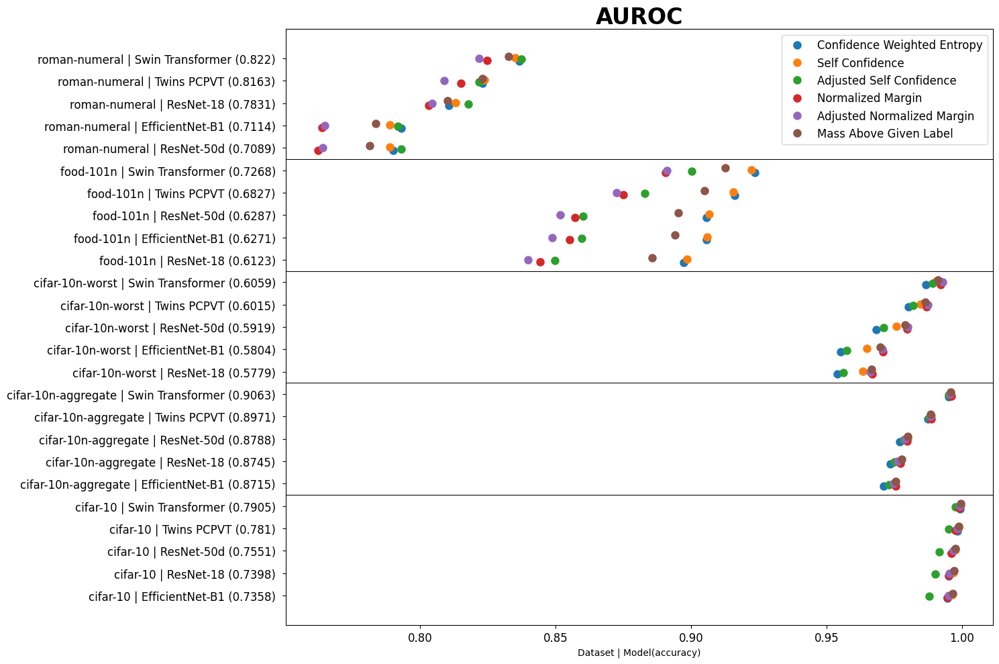

In [44]:
draw_full_plot_lift(df_auroc, title="AUROC")
# ulya: log(self-confidence) - log(avg(p every other class))

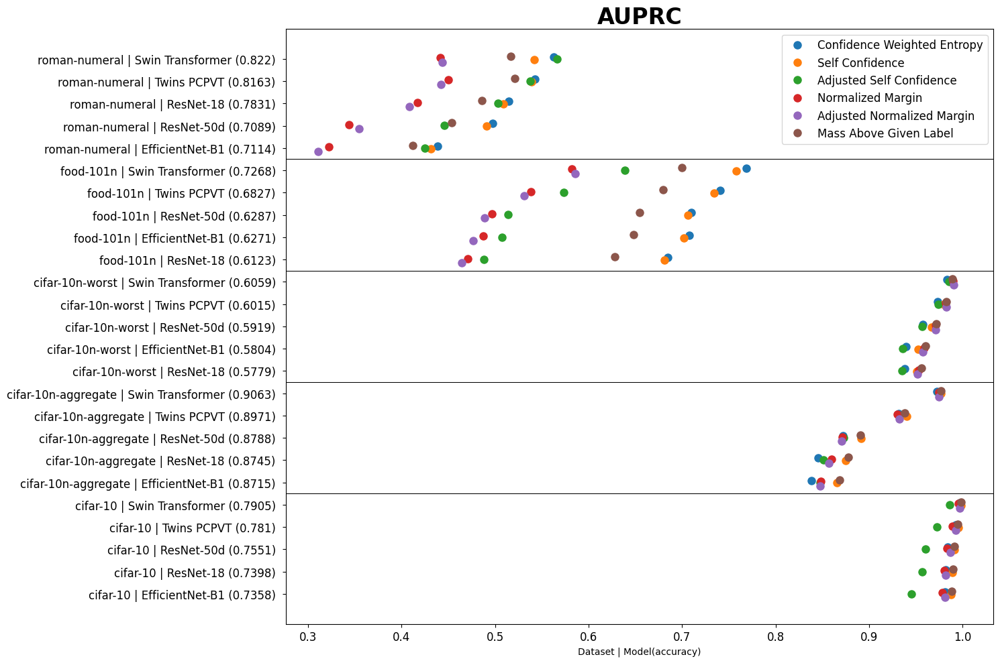

In [45]:
draw_full_plot_lift(df_auprc, title="AUPRC")

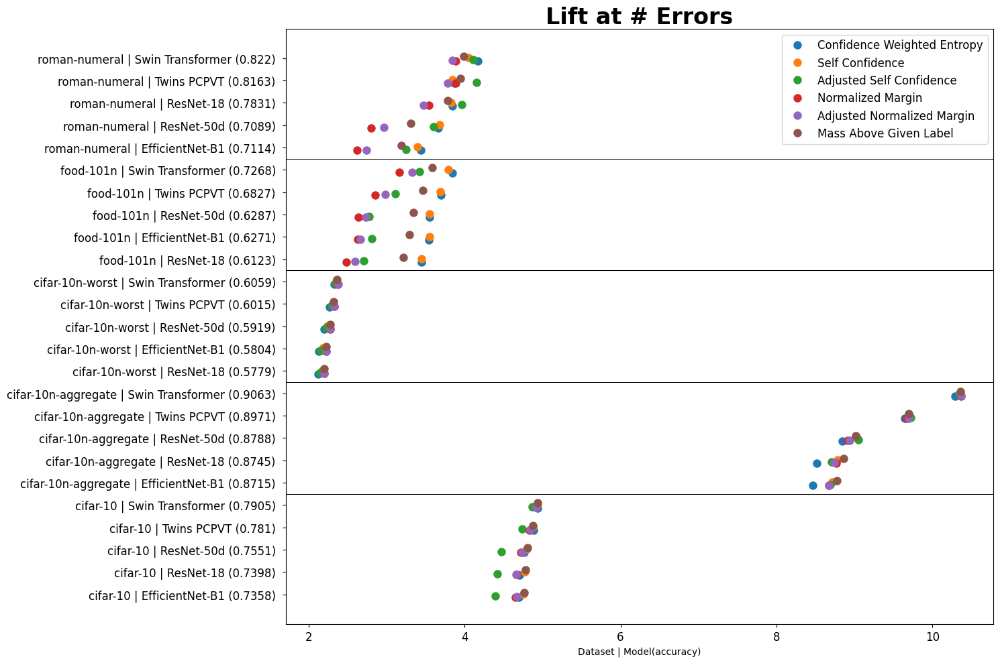

In [46]:
draw_full_plot_lift(df_lift_at_num_errors, title="Lift at # Errors")

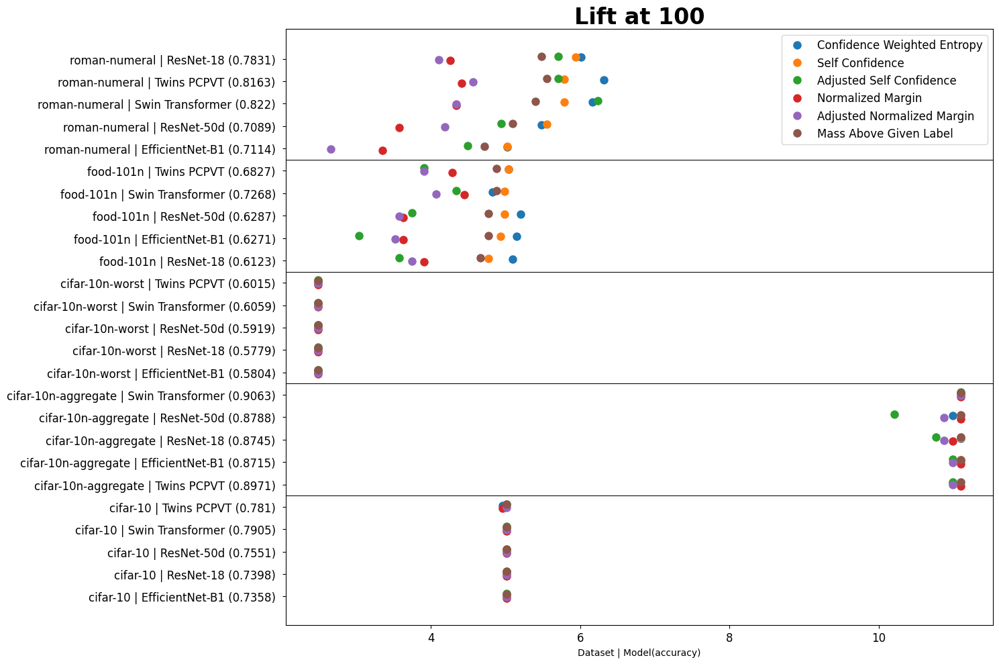

In [47]:
draw_full_plot_lift(df_lift_at_100, title="Lift at 100")

## All ranking algorithms

['rank_penalized_confidence_05', 'penalized_confidence', 'entropic_confidence', 'balanced_entropic_confidence', 'magl_0001', 'openset_score', 'openset_entropy_score', 'mutual_info']
(2831, 10) 6.547880389007332e-07 0.9992890357971191
() 1.4195199799013654 1.4195199799013654
(50000, 10) 5.1400096708675846e-05 0.996326744556427
() 0.8216633324253464 0.8216633324253464
(50000, 10) 4.220504251861712e-06 0.9995846152305603
() 1.7164125384363094 1.7164125384363094
(50000, 10) 2.370743914070772e-06 0.9997195601463318
() 1.2984382498951736 1.2984382498951736
(52867, 101) 5.072782749415694e-10 0.9999874830245972
() 2.5585936906486317 2.5585936906486317
(2831, 10) 1.62098731379956e-05 0.9907000660896301
() 1.2336266380828884 1.2336266380828884
(50000, 10) 0.0014403072418645024 0.9312106370925903
() 0.854246395024956 0.854246395024956
(50000, 10) 0.00010794792615342885 0.9943090677261353
() 1.730631283579418 1.730631283579418
(50000, 10) 5.040341056883335e-05 0.9936456680297852
() 1.3573450315743

,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.002906,-0.005239,-0.055085,0.043424
std,19582.096464,6761.278694,0.004075,0.013197,0.104759,0.147100
min,2831.000000,372.000000,-0.012456,-0.036620,-0.357230,-0.162734
25%,50000.000000,4505.000000,-0.005023,-0.010873,-0.068369,0.000000
50%,50000.000000,9746.000000,-0.001691,-0.005965,-0.038350,0.000000
75%,50000.000000,9973.000000,-0.000479,0.003789,0.003896,0.000000
max,52867.000000,20104.000000,0.004389,0.020170,0.061373,0.456613


None
penalized_confidence - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.000286,0.000154,-0.008472,0.065289
std,19582.096464,6761.278694,0.000674,0.004009,0.043837,0.131466
min,2831.000000,372.000000,-0.002058,-0.008332,-0.184118,-0.108490
25%,50000.000000,4505.000000,-0.000575,-0.001681,-0.018600,0.000000
50%,50000.000000,9746.000000,-0.000326,-0.000163,-0.003896,0.000000
75%,50000.000000,9973.000000,-0.000041,0.002856,0.014782,0.110988
max,52867.000000,20104.000000,0.001388,0.008239,0.061373,0.456613


None
openset_entropy_score - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.006256,-0.018046,-0.122296,-0.045521
std,19582.096464,6761.278694,0.009858,0.023489,0.166506,0.162797
min,2831.000000,372.000000,-0.035103,-0.063825,-0.566641,-0.532715
25%,50000.000000,4505.000000,-0.006899,-0.028280,-0.160365,-0.110988
50%,50000.000000,9746.000000,-0.002770,-0.017655,-0.110865,-0.049741
75%,50000.000000,9973.000000,-0.000740,0.003249,0.000000,0.000000
max,52867.000000,20104.000000,0.004286,0.014550,0.102288,0.304409


None
openset_score - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.003152,-0.007690,-0.076940,0.043007
std,19582.096464,6761.278694,0.004541,0.012437,0.114726,0.118667
min,2831.000000,372.000000,-0.016912,-0.034844,-0.411431,-0.152204
25%,50000.000000,4505.000000,-0.003188,-0.011713,-0.096018,0.000000
50%,50000.000000,9746.000000,-0.001992,-0.006594,-0.050649,0.000000
75%,50000.000000,9973.000000,-0.000307,-0.000469,-0.003519,0.000000
max,52867.000000,20104.000000,0.001937,0.010664,0.035621,0.456613


None
mutual_info - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.0,25.0,25.0,25.0
mean,41139.600000,8940.000000,0.0,0.0,0.0,0.0
std,19582.096464,6761.278694,0.0,0.0,0.0,0.0
min,2831.000000,372.000000,0.0,0.0,0.0,0.0
25%,50000.000000,4505.000000,0.0,0.0,0.0,0.0
50%,50000.000000,9746.000000,0.0,0.0,0.0,0.0
75%,50000.000000,9973.000000,0.0,0.0,0.0,0.0
max,52867.000000,20104.000000,0.0,0.0,0.0,0.0


None
rank_penalized_confidence_05 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.000822,-0.005419,-0.021578,0.033000
std,19582.096464,6761.278694,0.000957,0.011256,0.064542,0.148120
min,2831.000000,372.000000,-0.002938,-0.030247,-0.265948,-0.228306
25%,50000.000000,4505.000000,-0.001314,-0.010994,-0.020458,0.000000
50%,50000.000000,9746.000000,-0.000532,-0.003052,-0.006033,0.000000
75%,50000.000000,9973.000000,-0.000179,0.000518,0.014782,0.076102
max,52867.000000,20104.000000,0.000418,0.016601,0.061373,0.380511


None
balanced_entropic_confidence - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,0.000003,-0.000722,-0.001213,-0.041547
std,19582.096464,6761.278694,0.000083,0.001359,0.004416,0.121020
min,2831.000000,372.000000,-0.000195,-0.004345,-0.020458,-0.325469
25%,50000.000000,4505.000000,-0.000025,-0.000371,-0.001361,0.000000
50%,50000.000000,9746.000000,0.000003,-0.000183,-0.000495,0.000000
75%,50000.000000,9973.000000,0.000040,-0.000031,0.000000,0.000000
max,52867.000000,20104.000000,0.000129,0.000598,0.002783,0.110988


None
magl_0001 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,2.500000e+01,2.500000e+01,25.000000,25.000000
mean,41139.600000,8940.000000,-8.588593e-06,-9.539963e-05,0.000031,-0.002170
std,19582.096464,6761.278694,2.241654e-05,1.895978e-04,0.001008,0.010849
min,2831.000000,372.000000,-5.816437e-05,-4.914961e-04,-0.002464,-0.054245
25%,50000.000000,4505.000000,-1.311837e-05,-7.298302e-05,0.000000,0.000000
50%,50000.000000,9746.000000,4.927912e-07,2.581890e-08,0.000000,0.000000
75%,50000.000000,9973.000000,3.098241e-06,1.090844e-05,0.000124,0.000000
max,52867.000000,20104.000000,2.010468e-05,3.422373e-05,0.002464,0.000000


None


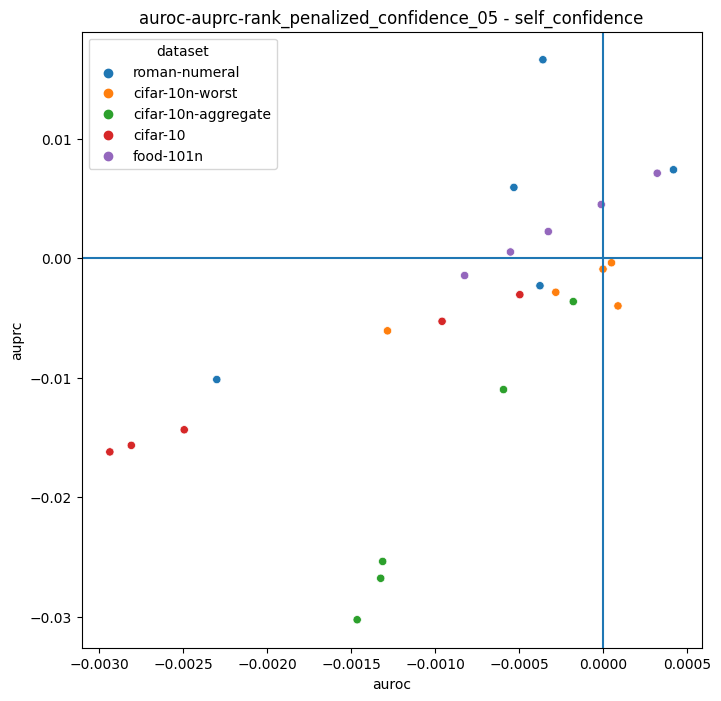

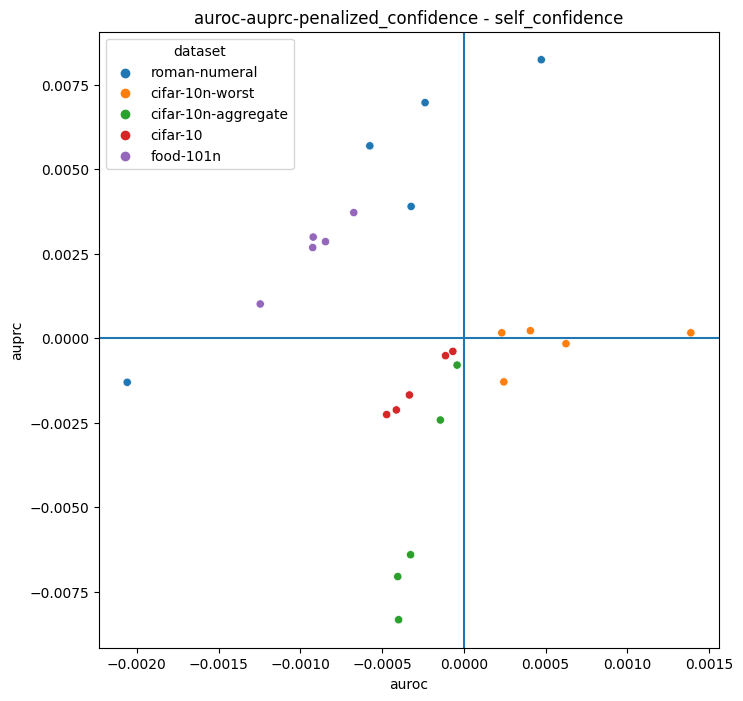

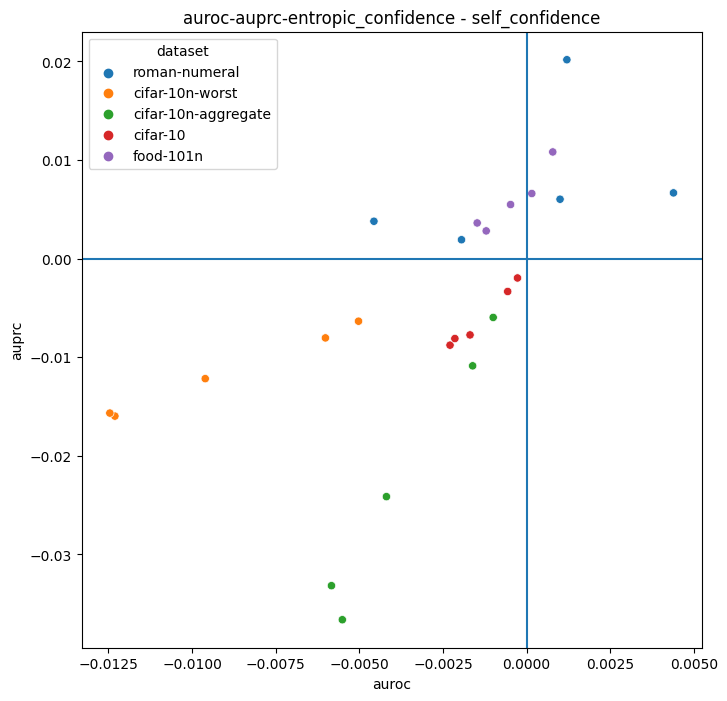

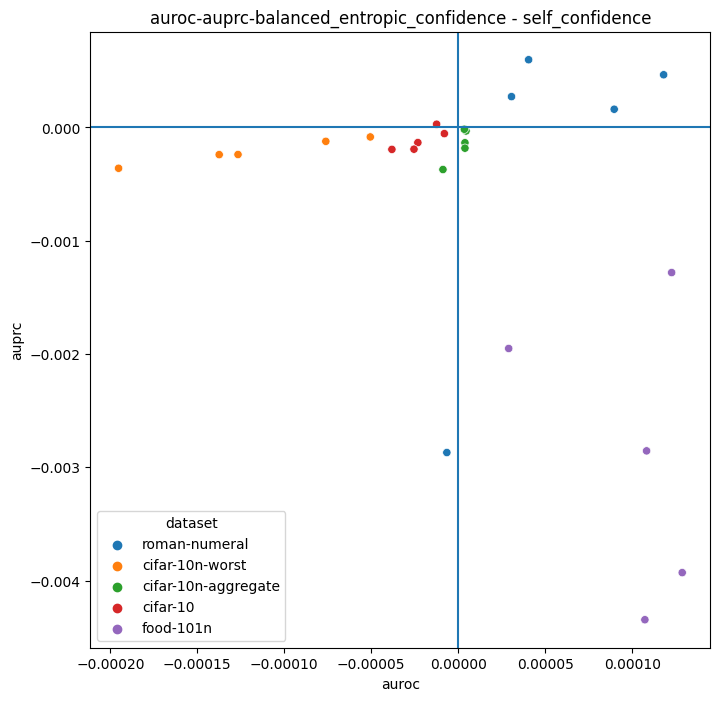

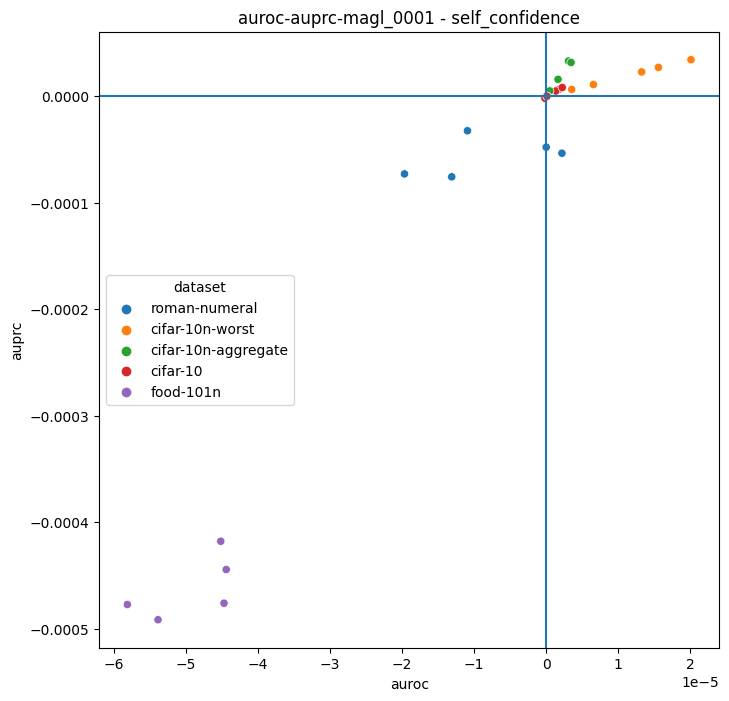

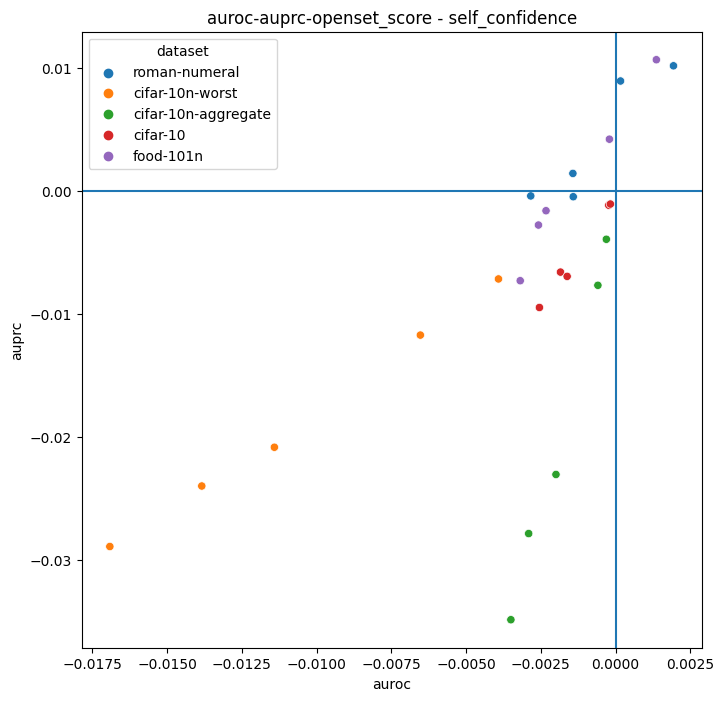

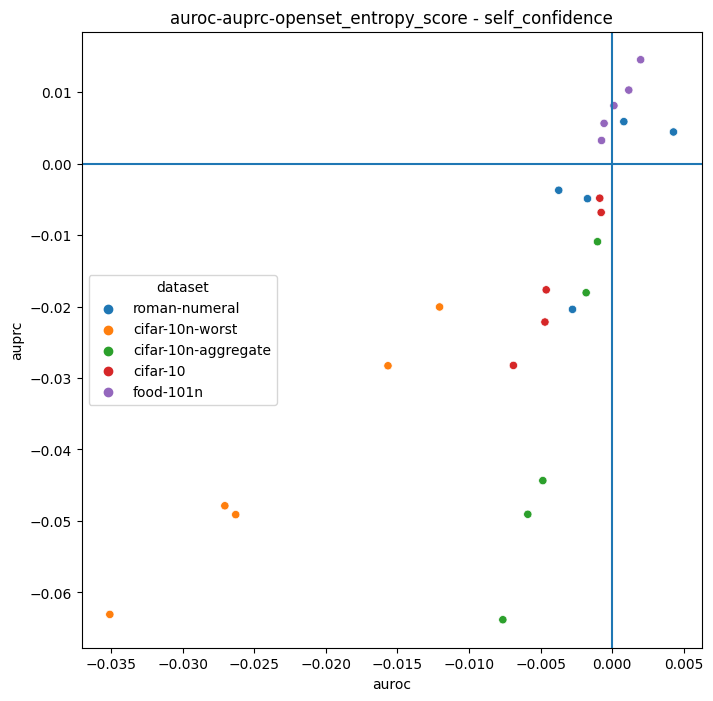

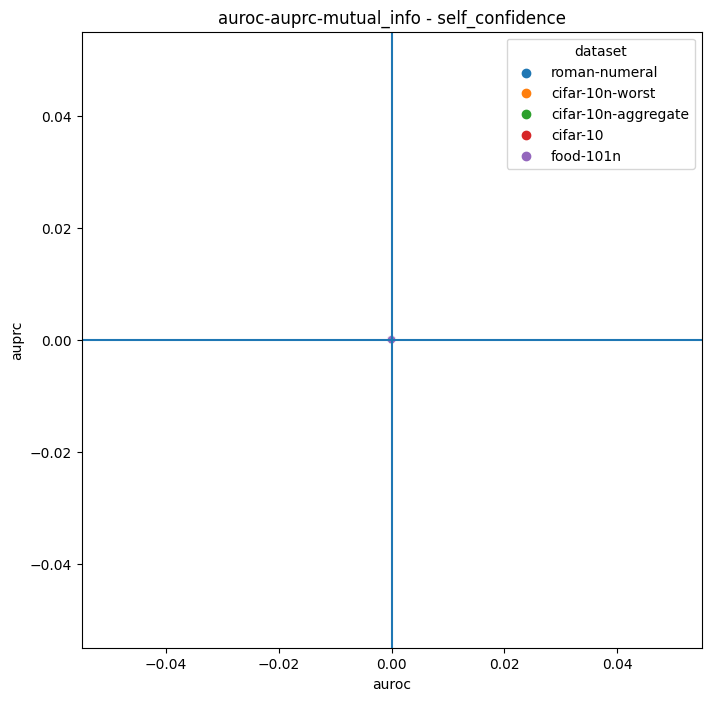

In [488]:
# args to pass to get_label_quality_scores()
score_params = \
[
    ("self_confidence", False, 0),
    ("rank_penalized_confidence_05", False, 0.5),
    ("penalized_confidence", False, 0),
    ("entropic_confidence", False, 0),
    ("balanced_entropic_confidence", False, 0.01),
    ("magl_0001", False, 0.001),
    ("openset_score", False, 0),
    ("openset_entropy_score", False, 0),
    ("openset_entropy_prime_score", False, 0),
    ("mutual_info", False, 0),
]

new_methods = [param[0] for param in score_params if "self_confidence" not in param]
print(new_methods)
    
evaluations, precision_recall_curves, accuracy_list = eval_exp(experiments, score_params)
dfs_new_methods_results = vis_results(evaluations, new_methods)

for method in set(dfs_new_methods_results['method'].tolist()):
    print(method)
    print(display(HTML(dfs_new_methods_results.loc[dfs_new_methods_results['method'] == method].describe().to_html())))                              
    
for method in new_methods:
    scatterplot(dfs_new_methods_results, method, hue='dataset')

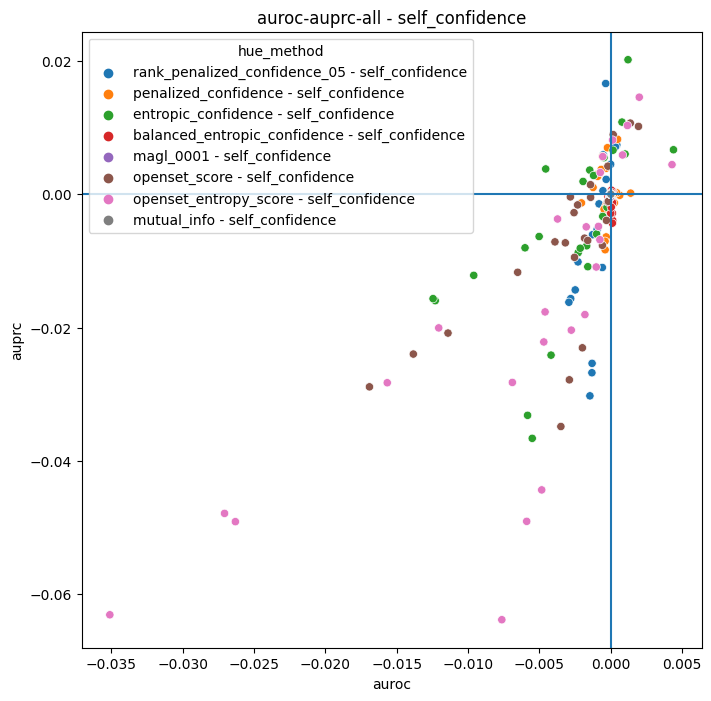

In [489]:
dfs_new_methods_results['hue_method'] = dfs_new_methods_results['method']
dfs_new_methods_results['method'] = 'all - self_confidence'
scatterplot(dfs_new_methods_results, 'all', hue='hue_method')

In [490]:
# scatterplot(dfs_new_methods_results, 'all', hue='dataset')

In [491]:
# scatterplot(dfs_new_methods_results, 'all', hue='model')

# Plotting correlations

To me, a good adjustment x will lead to better separation between the black & red examples in the scatterplot than merely considering self_confidence alone.  Here are some good candidates to consider for x:
- mass above given label
- max pred_prob among classes that are not the given label (ie. the thing used in normalized-margin)
- number of classes more likely than given label (ie. the thing used in rank scores we explored)
- max_pred_prob(among classes that are not given label) - pred_prob(given_label)
- H(pred_prob)  = overall entropy
- H(p’) = entropy among renormalized probability vector after getting rid of given label (p' is defined as we considered before)
- H(p_) = entropy among renormalized probability vector p_ formed by only keeping classes with equal or lower pred_prob than given label (discard given label though), define it is 1 if no classes meet this criterion.

In [133]:
results = []

for experiment in experiments:
    
    # experiment results
    dataset = experiment["dataset"]
    model = experiment["model"]
    pred_probs = experiment["pred_probs"]
    labels = experiment["labels"]
    images = experiment["images"]
    label_errors_target = experiment["label_errors_mask"]
    type_train = experiment["type_train"]
    
    if 'roman' in dataset:
    
    else:
    
    if 'swin' not in model:
        continue
    print(dataset, model)
    # finding label issues (score param agnostic)
    find_label_issues = cleanlab.filter.find_label_issues(labels, pred_probs, filter_by='confident_learning')
    num_label_issues = cleanlab.count.num_label_issues(labels, pred_probs)
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=False)
    
    # mass above given label
    mass_above_given_label = np.sum(np.clip(pred_probs - self_confidence[:,np.newaxis], a_min=0, a_max=None), axis=1)
    score = 1-mass_above_given_label
    results.append((f'magl-{dataset}-{model}', score, self_confidence, label_errors_target))
    
#     # max pred_prob
#     mask = pred_probs.copy()
#     mask[np.arange(mask.shape[0]), labels] = -1
#     pred_probs_prime = mask[mask != -1]
#     pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))
#     pred_probs_prime_norm = pred_probs_prime / np.sum(pred_probs_prime, axis=1)[:,np.newaxis]
#     max_pred_prob = np.amax(pred_probs_prime_norm, axis=1) # todo should I renormalize this
#     results.append((f'max pred prob-{dataset}-{model}', max_pred_prob, self_confidence, label_errors_target))
    
#     # num classes more likeley than given label
#     given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
#     given_label_prob = np.repeat(given_label_prob[:,np.newaxis], pred_probs.shape[1], axis=1)
#     more_likeley = pred_probs >= given_label_prob # >= accounts for J+1 
#     score = np.sum(more_likeley, axis=1)
#     results.append((f'num classes more likeley than given label-{dataset}-{model}', score, self_confidence, label_errors_target))
    
#     # max pred_prob - pred_prob given label
#     score = max_pred_prob - pred_probs[np.arange(pred_probs.shape[0]), labels]
#     results.append((f'max pred prob - pred prob given label-{dataset}-{model}', score, self_confidence, label_errors_target))
    
#     # overall entropy
#     normalized_entropy = get_normalized_entropy(pred_probs)
#     results.append((f'H(p)-{dataset}-{model}', normalized_entropy, self_confidence, label_errors_target))
    
#     # p' entropy
#     normalized_entropy = get_normalized_entropy(pred_probs_prime_norm)
#     results.append((f'H(p\')-{dataset}-{model}', normalized_entropy, self_confidence, label_errors_target))
    
#     # H(p_) = entropy among renormalized probability vector p_ formed by only keeping classes with 
#     # equal or lower pred_prob than given label (discard given label though), 
#     # define it is 1 if no classes meet this criterion. 
#     less_likeley = pred_probs_prime < given_label_prob[:,:-1]
# #     no_class_idx = less_likeley.sum(axis=1) == 0
    
#     less_pred_probs = pred_probs_prime * less_likeley
#     less_pred_probs[~less_likeley] = np.nan
#     less_pred_probs = less_pred_probs.tolist()
#     less_pred_probs = [np.array(less)[~np.isnan(less)] for less in less_pred_probs]

#     normalized_entropy = [get_normalized_entropy(np.reshape(less[:,np.newaxis], (1,len(less))))[0] if len(less) > 1 else 1 for less in less_pred_probs]
#     normalized_entropy = np.array(normalized_entropy)
#     results.append((f'H(p_)-{dataset}-{model}', normalized_entropy, self_confidence, label_errors_target))
    
    # Mean Conformal adjustment
    
        # create fake data
    centers = [(0, 3.5), (-2, 0), (2, 0)]
    covs = [np.eye(2), np.eye(2)*2, np.diag([5, 1])]
    x_min, x_max, y_min, y_max, step = -6, 8, -6, 8, 0.1
    n_samples = len(labels)
    n_classes = pred_probs.shape[1]
    np.random.seed(42)
    X = np.random.random((n_samples,n_classes))
    y = np.random.randint(low=0, high=10, size=(n_samples,))

    X_train_cal, X_test, y_train_cal, y_test = X, X.copy(), y, y.copy()
    X_train, X_cal, y_train, y_cal = X, X.copy(), y, y.copy()

    xx, yy = np.meshgrid(
        np.arange(x_min, x_max, step), np.arange(x_min, x_max, step)
    )
    X_test_mesh = np.stack([xx.ravel(), yy.ravel()], axis=1)
    
        # calculate conformal adju score
    clf = FakeClassifier(pred_probs)
    clf.fit(pred_probs, labels)
    mapie_score = MapieClassifier(estimator=clf, cv="prefit", method="score")
    mapie_score.fit(X_cal, y_cal)
    alpha2 = np.arange(0.02, 0.98, 0.02)
    _, y_ps_score2 = mapie_score.predict(X_test, alpha=alpha2)
    
    print(mapie_score.conformity_scores_.shape)
    print(y_ps_score2.shape)
    
    results.append((f'C(mapie.conformity_scores_)-{dataset}-{model}', np.squeeze(mapie_score.conformity_scores_), self_confidence, label_errors_target))

    
    widths_score = np.sum(y_ps_score2, axis=1)
    score = np.mean(widths_score, axis=1)
    results.append((f'C(mean)-{dataset}-{model}', score, self_confidence, label_errors_target))
    
    score = np.max(widths_score, axis=1)
    results.append((f'C(max)-{dataset}-{model}', score, self_confidence, label_errors_target))
    
    score = np.min(widths_score, axis=1)
    results.append((f'C(min)-{dataset}-{model}', score, self_confidence, label_errors_target))
    
    alpha2 = np.array([0.8])
    _, y_ps_score2 = mapie_score.predict(X_test, alpha=alpha2)
    widths_score = np.sum(y_ps_score2, axis=1)
    score = np.mean(widths_score, axis=1)
    results.append((f'C(0.8)-{dataset}-{model}', score, self_confidence, label_errors_target))
    
    alpha2 = np.array([0.2])
    _, y_ps_score2 = mapie_score.predict(X_test, alpha=alpha2)
    widths_score = np.sum(y_ps_score2, axis=1)
    score = np.mean(widths_score, axis=1)
    results.append((f'C(0.2)-{dataset}-{model}', score, self_confidence, label_errors_target))
    
    alpha2 = np.array([0.05])
    _, y_ps_score2 = mapie_score.predict(X_test, alpha=alpha2)
    widths_score = np.sum(y_ps_score2, axis=1)
    score = np.mean(widths_score, axis=1)
    results.append((f'C(0.05)-{dataset}-{model}', score, self_confidence, label_errors_target))\
    
    alpha2 = np.array([0.95])
    _, y_ps_score2 = mapie_score.predict(X_test, alpha=alpha2)
    widths_score = np.sum(y_ps_score2, axis=1)
    score = np.mean(widths_score, axis=1)
    results.append((f'C(0.95)-{dataset}-{model}', score, self_confidence, label_errors_target))
    
    if "food" in dataset:
        continue
        
    print('cs')
    clf = FakeClassifier(pred_probs)
    clf.fit(pred_probs, labels)
    mapie_score = MapieClassifier(estimator=clf, cv="prefit", method="cumulated_score")
    mapie_score.fit(X_cal, y_cal)
    alpha2 = np.arange(0.02, 0.98, 0.02)
    _, y_ps_score2 = mapie_score.predict(X_test, alpha=alpha2)
    
    results.append((f'CS(mapie.conformity_scores_)-{dataset}-{model}', np.squeeze(mapie_score.conformity_scores_), self_confidence, label_errors_target))

    
    print('cs0')
    widths_score = np.sum(y_ps_score2, axis=1)
    score = np.mean(widths_score, axis=1)
    results.append((f'CS(mean)-{dataset}-{model}', score, self_confidence, label_errors_target))
    
    print('cs1')
    alpha2 = np.array([0.2])
    _, y_ps_score2 = mapie_score.predict(X_test, alpha=alpha2)
    widths_score = np.sum(y_ps_score2, axis=1)
    score = np.mean(widths_score, axis=1)
    results.append((f'CS(0.2)-{dataset}-{model}', score, self_confidence, label_errors_target))
    
    print('cs2')
    alpha2 = np.array([0.05])
    score = np.mean(widths_score, axis=1)
    results.append((f'CS(0.05)-{dataset}-{model}', score, self_confidence, label_errors_target))
    

roman-numeral swin_base_patch4_window7_224
fit called
predict_proba called (2831, 10), (2831, 10)
predict called
predict_proba called (2831, 10), (2831, 10)
(2831, 1)
(2831, 10, 48)
predict called
predict_proba called (2831, 10), (2831, 10)
predict called
predict_proba called (2831, 10), (2831, 10)
predict called
predict_proba called (2831, 10), (2831, 10)
predict called
predict_proba called (2831, 10), (2831, 10)
cs
fit called
predict_proba called (2831, 10), (2831, 10)
predict called
predict_proba called (2831, 10), (2831, 10)
cs0
cs1
predict called
predict_proba called (2831, 10), (2831, 10)
cs2
cifar-10n-worst swin_base_patch4_window7_224
fit called
predict_proba called (50000, 10), (50000, 10)
predict called
predict_proba called (50000, 10), (50000, 10)
(50000, 1)
(50000, 10, 48)
predict called
predict_proba called (50000, 10), (50000, 10)
predict called
predict_proba called (50000, 10), (50000, 10)
predict called
predict_proba called (50000, 10), (50000, 10)
predict called
predic

In [135]:
ensemble_experiments = build_ensemble_eval(experiments)

for dataset, ensemble_experiment in ensemble_experiments.items():
    model = "ensemble"
    pred_probs_list = []
    labels = ensemble_experiment[0]["labels"]
    images = ensemble_experiment[0]["images"]
    label_errors_target = ensemble_experiment[0]["label_errors_mask"]
    type_train = ensemble_experiment[0]["type_train"]

    accuracies = []
    print(dataset)
    
    for experiment in ensemble_experiment:
        pred_probs = experiment["pred_probs"]
        pred_probs_list.append(pred_probs)
        accuracies.append((pred_probs.argmax(axis=1) == labels).mean())

    # eu: epistemic uncertainty
    self_confidence_list = []
    pred_probs_avg = np.squeeze(np.array(pred_probs_list).mean(axis=0))
    l2e_uncertainty = []
    abs_uncertainty = []
    
    for pred_probs in pred_probs_list:
        self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=False)
        self_confidence_list.append(self_confidence)
        l2e_uncertainty.append(np.power(np.sum(np.power(pred_probs_avg - pred_probs, 2), axis=1), 1/2))
        abs_uncertainty.append(np.mean(np.abs(pred_probs_avg - pred_probs), axis=-1))
    
    self_confidence_list = np.array(self_confidence_list)
    self_confidence = np.squeeze(self_confidence_list.mean(axis=0))
    
    l2e_uncertainty = np.array(l2e_uncertainty)
    l2e_uncertainty = np.squeeze(l2e_uncertainty.mean(axis=0))
    results.append((f'l2-eu-{dataset}-{model}', l2e_uncertainty, self_confidence, label_errors_target))
    
    abs_uncertainty = np.array(abs_uncertainty)
    abs_uncertainty = np.squeeze(abs_uncertainty.mean(axis=0))
    results.append((f'abs-eu-{dataset}-{model}', abs_uncertainty, self_confidence, label_errors_target))

roman-numeral
cifar-10n-worst
cifar-10n-aggregate
cifar-10
food-101n


### Plotting correlations

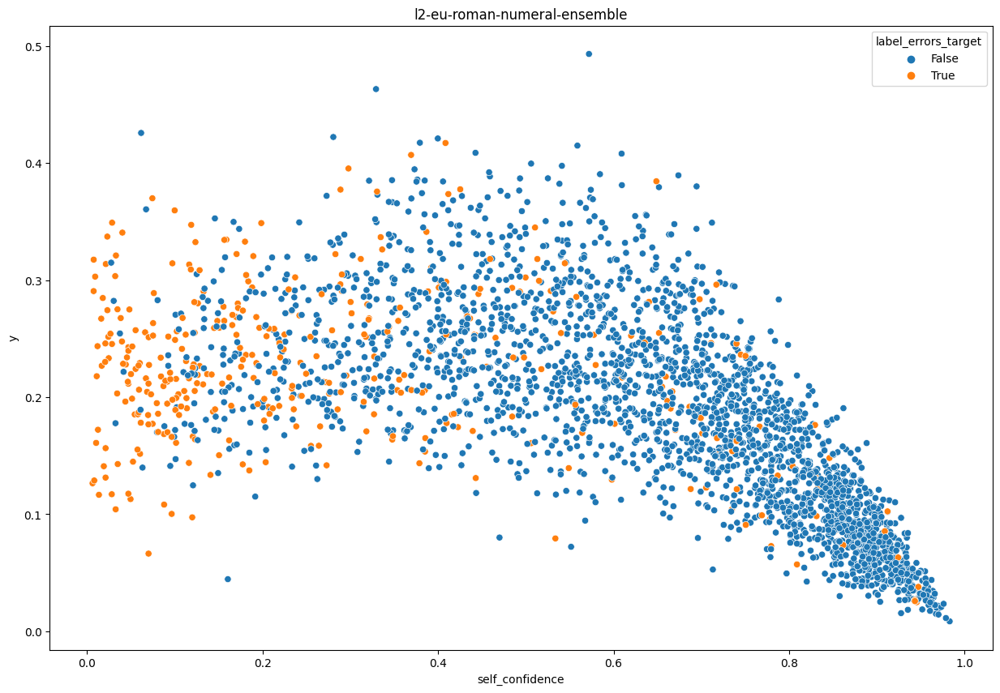

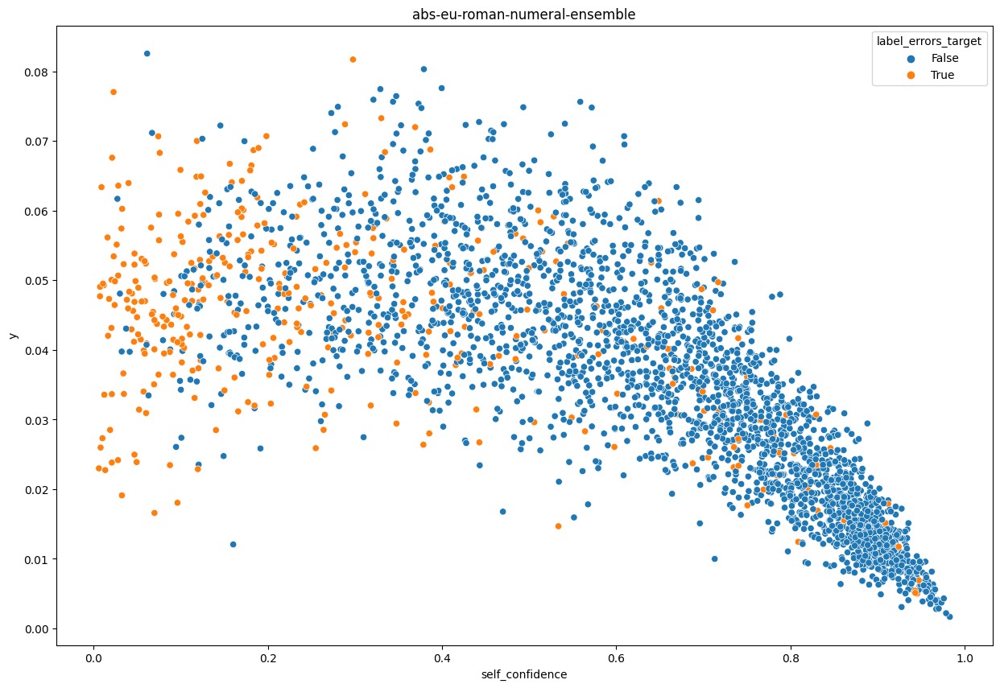

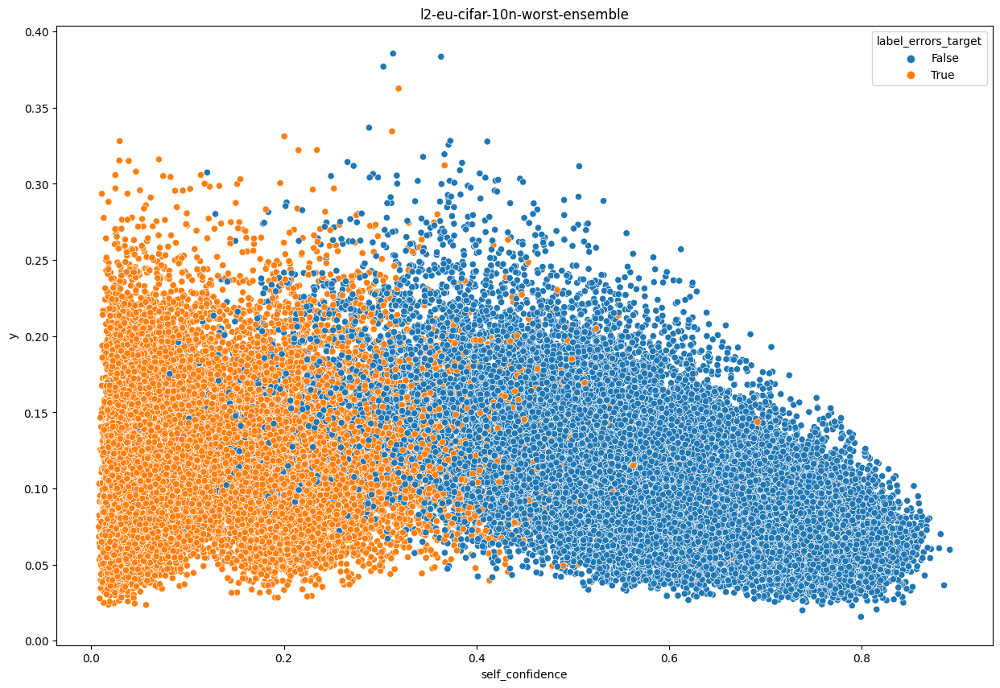

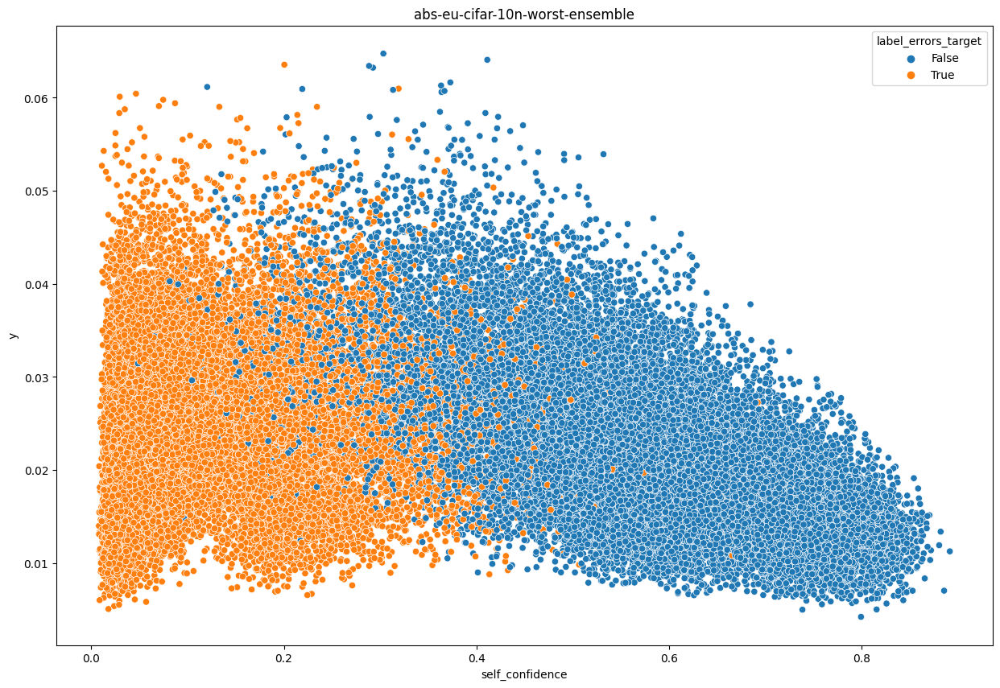

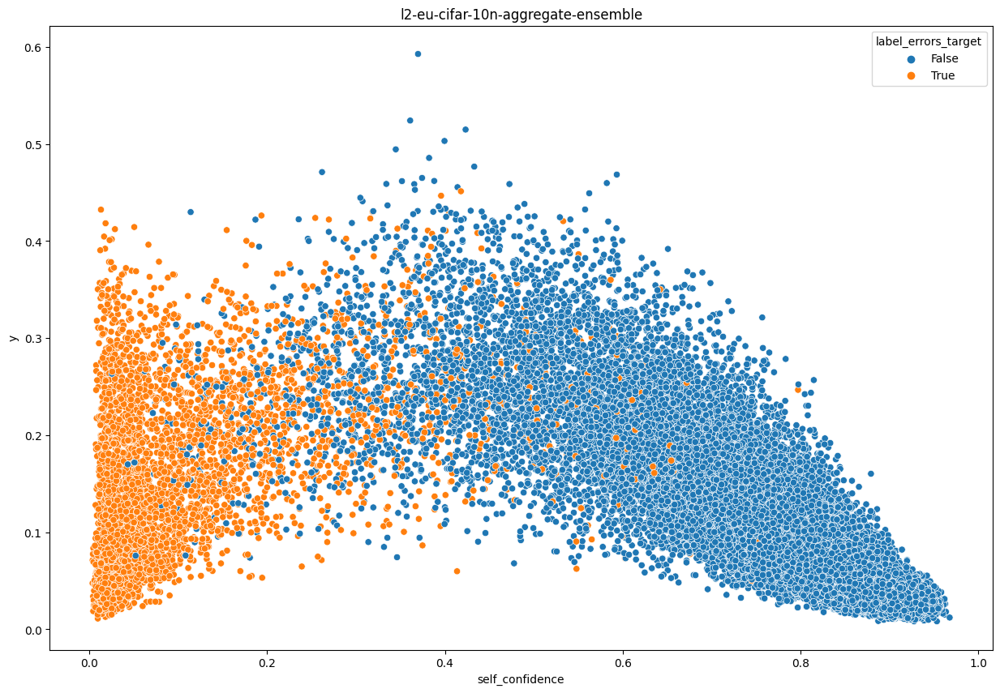

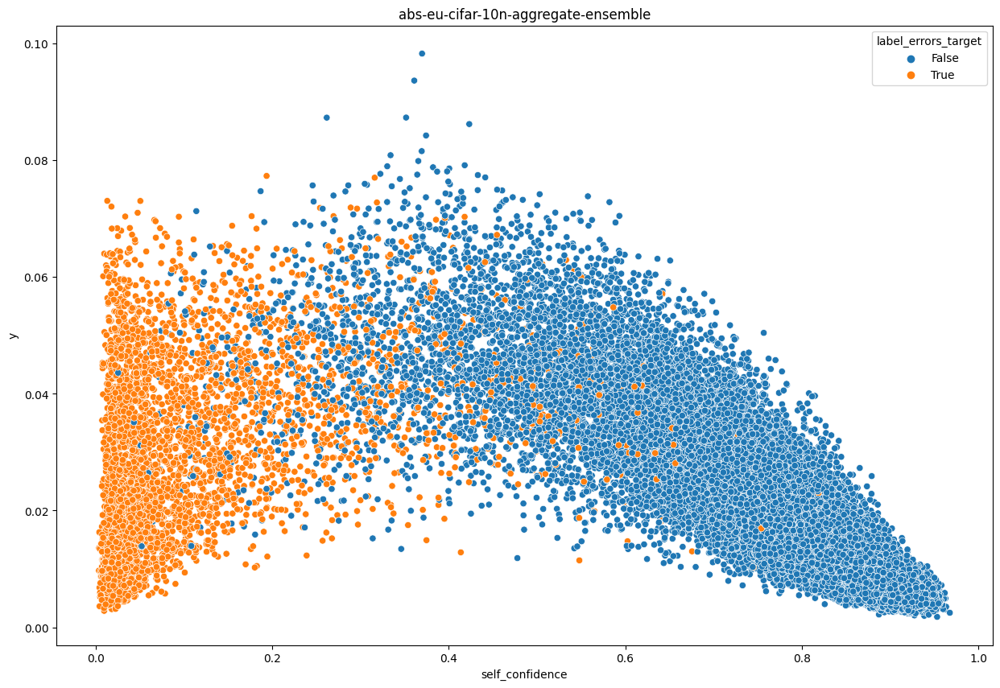

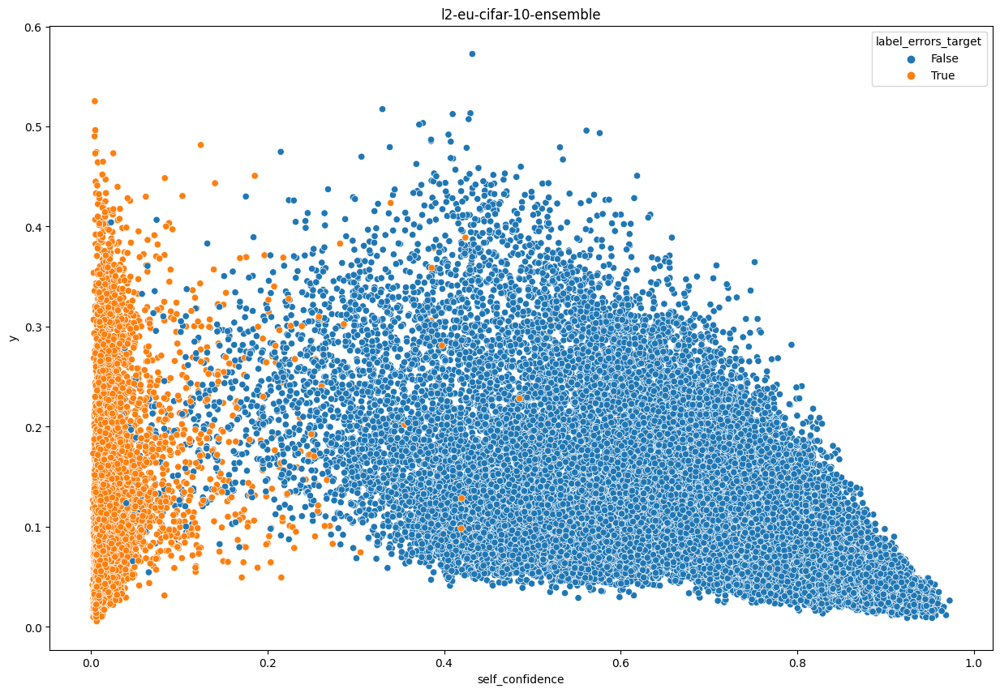

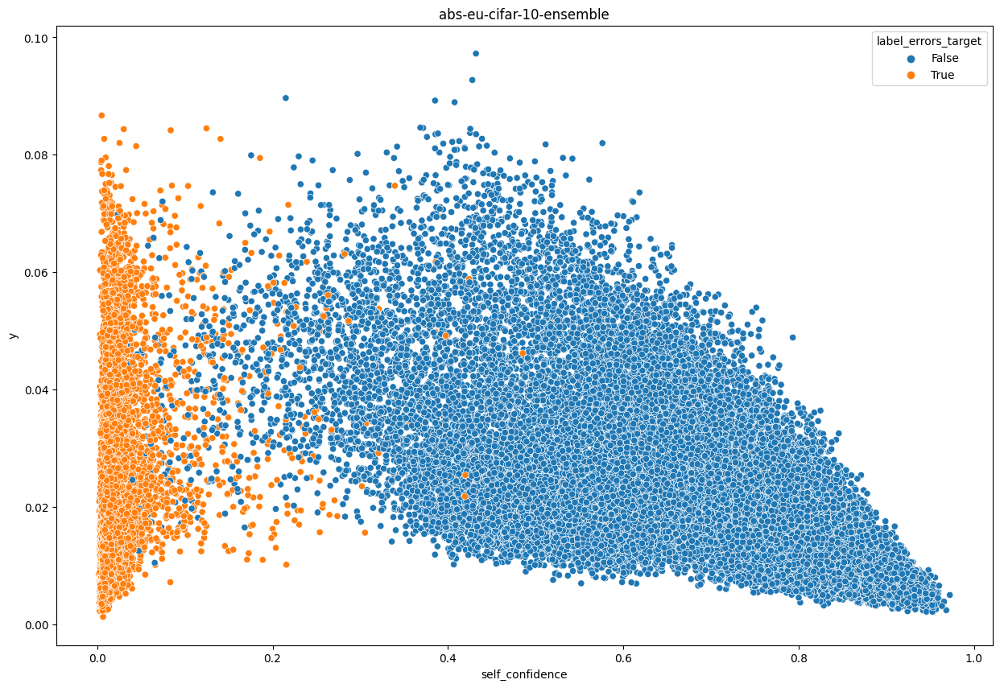

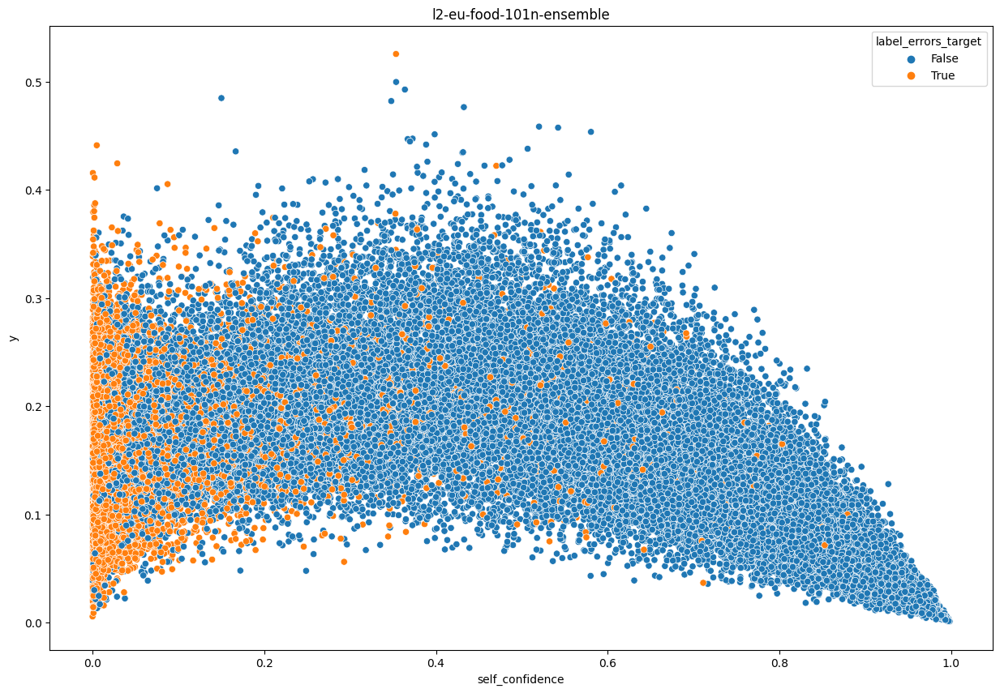

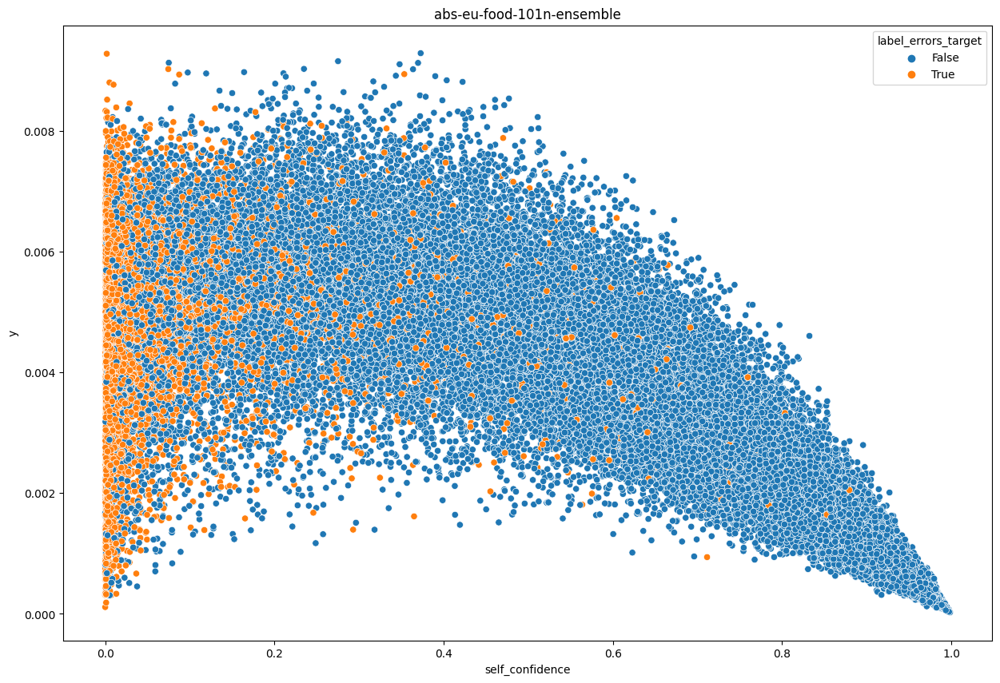

In [111]:
import seaborn as sns

for model, values, self_confidence, label_errors_target in results:
    plt.rcParams["figure.figsize"] = (15, 10)
    if "asds" not in model:
        continue
    df = pd.DataFrame(zip(self_confidence, values, label_errors_target), columns=['self_confidence','y','label_errors_target'])  
    sns.scatterplot(x="self_confidence", y="y", data=df, hue='label_errors_target')
    plt.title(f'{model}')
    plt.savefig(f'./figs-test/scatter-{model}.png', dpi=100)
    plt.show()

### Knn quantifying uncertainty

In [136]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import MinMaxScaler

knn_results = []
for model, values, self_confidence, label_errors_target in results:
    if "ensemble" in model:
        print(model)
    else:
        continue
#     print(model)
    # rescale data
    print(np.mean(values), np.min(values), np.max(values))
    scaler = MinMaxScaler(feature_range = (0,0.2))
    values = np.squeeze(scaler.fit_transform(values.reshape(-1,1)))
    print(np.mean(values), np.min(values), np.max(values))


    # base value
    clf = KNeighborsClassifier(n_neighbors=5)
    scores = cross_val_score(clf, self_confidence.reshape(-1,1), label_errors_target, cv=5)
#     print(f'{model}-\n{round(np.mean(scores),5)}-{round(np.std(scores),5)}')
    
    clf = KNeighborsClassifier(n_neighbors=5)
    X =  np.array([self_confidence,values])
    X = np.transpose(X, (1,0))
    Xscores = cross_val_score(clf, X, label_errors_target, cv=5)
#     print(f'{round(np.mean(Xscores),5)}-{round(np.std(Xscores),5)}\n')
    
    delta_scores = round(np.mean(Xscores),5) - round(np.mean(scores),5)
    delta_std = round(np.std(Xscores),5) - round(np.std(scores),5)
    
    result = {
        "method": model,
        "^scores": delta_scores,
        "^std": delta_std,
    }
        
    knn_results.append(result)
pd.DataFrame(knn_results)

l2-eu-roman-numeral-ensemble
0.18674392352872643 0.008407885671989284 0.49319626829919
0.07357273575339635 0.0 0.20000000000000004
abs-eu-roman-numeral-ensemble
0.035269599004794705 0.0016625191892017017 0.08253639512963126
0.08310985327412145 0.0 0.2
l2-eu-cifar-10n-worst-ensemble
0.11120615109893907 0.01561482214470646 0.38555384445797725
0.05167950564203209 0.0 0.19999999999999998
abs-eu-cifar-10n-worst-ensemble
0.022224890141860947 0.004212290190160277 0.0647439745143056
0.059514616693114794 0.0 0.2
l2-eu-cifar-10n-aggregate-ensemble
0.09484646236290442 0.008191880826906524 0.5927518731816296
0.02964779754664227 0.0 0.19999999999999998
abs-eu-cifar-10n-aggregate-ensemble
0.017636023704192597 0.0017908476386219257 0.0982370213093236
0.03285807090630929 0.0 0.2
l2-eu-cifar-10-ensemble
0.1082676603867375 0.005534063095616115 0.5724301871415903
0.03624424049961925 0.0 0.2
abs-eu-cifar-10-ensemble
0.020631002423375833 0.001265354834496975 0.09722496431879699
0.040362080864964935 0.0 0.2

,method,^scores,^std
0,l2-eu-roman-numeral-ensemble,0.00247,-0.00175
1,abs-eu-roman-numeral-ensemble,0.00283,0.00323
2,l2-eu-cifar-10n-worst-ensemble,0.00486,-0.00099
3,abs-eu-cifar-10n-worst-ensemble,0.00632,-0.00109
4,l2-eu-cifar-10n-aggregate-ensemble,0.00176,0.00009
5,abs-eu-cifar-10n-aggregate-ensemble,0.00180,-0.00024
6,l2-eu-cifar-10-ensemble,-0.00126,0.00193
7,abs-eu-cifar-10-ensemble,-0.00070,0.00115
8,l2-eu-food-101n-ensemble,0.00216,-0.00055
9,abs-eu-food-101n-ensemble,0.00074,-0.00088


# Original Plot Function & Alpha eval

In [441]:
%%time

# args to pass to get_label_quality_scores()
score_params = \
[
    ("self_confidence", False),
    ("self_confidence", True),
#     ("normalized_margin", False),
#     ("normalized_margin", True),
#     ("confidence_weighted_entropy", False),
    ("openset_score", False),
#     ("openset_score", True),
    ("magl", False),
    ("penalized_confidence", False),
    ("rank_penalized_confidence", False),
    ("entropic_confidence", False),
    ("balanced_entropic_confidence", False)
]

evaluations = []
precision_recall_curves = [] # store this separately
accuracy_list = []

for experiment in experiments:
    
    # experiment results
    dataset = experiment["dataset"]
    model = experiment["model"]
    pred_probs = experiment["pred_probs"]
    labels = experiment["labels"]
    images = experiment["images"]
    label_errors_target = experiment["label_errors_mask"]
    type_train = experiment["type_train"]
    
    accuracy = {
        "dataset": dataset,
        "model": model,
        "cv_accuracy": (pred_probs.argmax(axis=1) == labels).mean()
    }
    
    accuracy_list.append(accuracy)
        
    # finding label issues (score param agnostic)
    find_label_issues = cleanlab.filter.find_label_issues(labels, pred_probs, filter_by='confident_learning')
    num_label_issues = cleanlab.count.num_label_issues(labels, pred_probs)
        
    for score_param in score_params:        
        # compute scoring method
        method, adjust_pred_probs = score_param
        
        if "magl" in method:
            label_quality_scores = probability_mass_above_given_label_score(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=0.99)
        elif method == "penalized_confidence":
            label_quality_scores = penalized_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
        elif "balanced_entropic_confidence" in method:
            label_quality_scores = balanced_entropic_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=1.)
        elif method == "entropic_confidence":
            label_quality_scores = entropic_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
        elif "rank_penalized_confidence" in method:
            label_quality_scores = rank_penalized_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=0.50)
        elif method == "openset_score":
            label_quality_scores = openset_score(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
        else:
            label_quality_scores = get_label_quality_scores(labels=labels, pred_probs=pred_probs, method=method, adjust_pred_probs=adjust_pred_probs)
            
        # compute accuracy of detecting label errors
        auroc = roc_auc_score(label_errors_target, 1 - label_quality_scores)

        # compute precision-recall curve using label quality scores
        precision, recall, thresholds = precision_recall_curve(label_errors_target, 1 - label_quality_scores)

        # compute prc auc scores
        auprc = auc(recall, precision)

        # lift at K where K = number of label errors
        lift_at_num_label_errors = lift_at_k(label_errors_target, 1 - label_quality_scores, k=label_errors_target.sum())
        
        # lift at k=100
        lift_at_100 = lift_at_k(label_errors_target, 1 - label_quality_scores, k=100)

        evaluation_results = {
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset,
            "model": model,
            "dataset_num_samples": labels.shape[0],
            "dataset_num_label_errors": label_errors_target.sum(),
            "auroc": auroc,
            "auprc": auprc,
            "MAE_label_issues": np.sum(np.abs(find_label_issues ^ label_errors_target)) / len(find_label_issues),
            "confident_MAD": np.abs(np.sum(find_label_issues) - np.sum(label_errors_target)),
            "estimated_MAD": np.abs(num_label_issues - np.sum(label_errors_target)),
            "lift_at_num_label_errors": lift_at_num_label_errors,
            "lift_at_100": lift_at_100,
            "type_train": type_train,
        }

        # store evaluation results
        evaluations.append(evaluation_results)
        
        precision_recall_curve_results = {
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset,
            "model": model,
            "label_quality_scores": label_quality_scores,
            "precision": precision,
            "recall": recall,
            "thresholds": thresholds,
            "type_train": type_train,
        }
        
        # store precision-recall curve results
        precision_recall_curves.append(precision_recall_curve_results)
        

#     #### active learning scores to use as comparison
    
#     al_scoring_funcs = {
#         "entropy": get_normalized_entropy,
#         "least_confidence": least_confidence
#     }

#     for al_method in al_scoring_funcs.keys():
        
#         # active learning scoring function
#         scoring_func = al_scoring_funcs[al_method]
    
#         # score
#         al_scores = scoring_func(pred_probs)

#         # compute accuracy of detecting label errors
#         auroc = roc_auc_score(label_errors_target, al_scores)

#         # lift at K where K = number of label errors
#         lift_at_num_label_errors = lift_at_k(label_errors_target, al_scores, k=label_errors_target.sum())
        
#         # lift at k=100
#         lift_at_100 = lift_at_k(label_errors_target, al_scores, k=100)
        

#         evaluation_results = {
#             "method": al_method,
#             "adjust_pred_probs": False,
#             "dataset": dataset,
#             "model": model,
#             "dataset_num_samples": labels.shape[0],
#             "dataset_num_label_errors": label_errors_target.sum(),
#             "auroc": auroc,
#             "lift_at_num_label_errors": lift_at_num_label_errors,
#             "MAE_label_issues": np.sum(np.abs(find_label_issues ^ label_errors_target)) / len(find_label_issues),
#             "confident_MAD": np.abs(np.sum(find_label_issues) - np.sum(label_errors_target)),
#             "estimated_MAD": np.abs(num_label_issues - np.sum(label_errors_target)),
#             "lift_at_100": lift_at_100,
#             "type_train": type_train,
#         }

#         # store evaluation results
#         evaluations.append(evaluation_results)

CPU times: user 1min 1s, sys: 995 ms, total: 1min 2s
Wall time: 1min 2s


### Compare results for new methods against self_confidence

In [442]:
dfs = []
new_methods = [param[0] for param in score_params if "self_confidence" not in param]
print(new_methods)

df = pd.DataFrame(evaluations)
for method in new_methods:
    gt = df.loc[df['method']=='self_confidence'].loc[df['adjust_pred_probs']==False]
    new_method = df.loc[df['method']==method].loc[df['adjust_pred_probs']==False]
    scores = ['auroc','auprc','lift_at_num_label_errors','lift_at_100']
    results = pd.DataFrame(new_method[scores].to_numpy() - gt[scores].to_numpy(), columns=scores).reset_index(drop=True)
    info = new_method[['method','adjust_pred_probs','dataset','model','dataset_num_samples','dataset_num_label_errors']].reset_index(drop=True)
    results = pd.concat([info,results],axis=1).rename(columns=dict(zip(scores, ['Δauroc','Δauprc','Δlift_at_num_label_errors','Δlift_at_100'])))
    results['method'] = f'{method} - self_confidence'
    dfs.append(results)

dfs_new_methods_results = pd.concat(dfs)
dfs_new_methods_results

['openset_score', 'magl', 'penalized_confidence', 'rank_penalized_confidence', 'entropic_confidence', 'balanced_entropic_confidence']


,method,adjust_pred_probs,dataset,model,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
0,openset_score - self_confidence,False,roman-numeral,resnet18,2831,372,-0.001415,-0.000469,0.020458,-0.152204
1,openset_score - self_confidence,False,cifar-10n-worst,resnet18,50000,20104,-0.013838,-0.023978,-0.087587,0.000000
2,openset_score - self_confidence,False,cifar-10n-aggregate,resnet18,50000,4505,-0.002906,-0.027842,-0.374476,0.000000
3,openset_score - self_confidence,False,cifar-10,resnet18,50000,9973,-0.001841,-0.006594,-0.096018,0.000000
4,openset_score - self_confidence,False,food-101n,resnet18,52867,9746,-0.002578,-0.002770,-0.047310,0.216979
5,openset_score - self_confidence,False,roman-numeral,resnet50d,2831,372,-0.002836,-0.000404,0.020458,0.152204
6,openset_score - self_confidence,False,cifar-10n-worst,resnet50d,50000,20104,-0.011409,-0.020828,-0.086226,0.000000
7,openset_score - self_confidence,False,cifar-10n-aggregate,resnet50d,50000,4505,-0.001992,-0.023040,-0.268539,0.000000
8,openset_score - self_confidence,False,cifar-10,resnet50d,50000,9973,-0.001619,-0.006942,-0.063844,0.000000
9,openset_score - self_confidence,False,food-101n,resnet50d,52867,9746,-0.003188,-0.007293,-0.047866,0.216979


In [417]:
from IPython.display import display, HTML

for method in set(dfs_new_methods_results['method'].tolist()):
    print(method)
    print(display(HTML(dfs_new_methods_results.loc[dfs_new_methods_results['method'] == method].describe().to_html())))                              

,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000
mean,41139.600000,8940.000000,-0.004512,-0.016007,-0.076010,-0.054329
std,19250.734193,6646.866396,0.007512,0.027334,0.138913,0.276839
min,2831.000000,372.000000,-0.032330,-0.117890,-0.564042,-1.301876
25%,50000.000000,4505.000000,-0.005813,-0.025203,-0.094802,-0.053217
50%,50000.000000,9746.000000,-0.001299,-0.003961,-0.019529,0.000000
75%,50000.000000,9973.000000,-0.000151,0.000568,0.006158,0.000000
max,52867.000000,20104.000000,0.005743,0.020170,0.122745,0.456613


## Test out thresholds

In [698]:
### PLOTTING ONES

from cleanlab.internal.label_quality_utils import get_normalized_entropy
from sklearn.metrics import mutual_info_score
from scipy.stats import chi2_contingency #mi

def penalized_confidence(labels, pred_probs, adjust_pred_probs=False):
#     self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
#     given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
#     given_label_prob = np.repeat(given_label_prob[:,np.newaxis], pred_probs.shape[1], axis=1)
#     more_likeley = pred_probs >= given_label_prob # >= accounts for J+1 
#     J = np.sum(more_likeley, axis=1)
#     return self_confidence / J, self_confidence, J
    alpha=0.50
    mask = pred_probs.copy()
    mask[np.arange(mask.shape[0]), labels] = -1
    pred_probs_prime = mask[mask != -1]
    pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))
    normalized_entropy = get_normalized_entropy(pred_probs_prime)
    
    
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
    given_label_prob = np.repeat(given_label_prob[:,np.newaxis], pred_probs.shape[1], axis=1)
    more_likeley = pred_probs >= given_label_prob # >= accounts for J+1 
    J = np.sum(more_likeley, axis=1)
    K = len(set(labels))
    rank  = ((K - J) / K) * normalized_entropy
    return alpha * self_confidence + (1 - alpha) * rank, self_confidence, rank

def rank_penalized_confidence(labels, pred_probs, adjust_pred_probs=False, alpha=0.50):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
    given_label_prob = np.repeat(given_label_prob[:,np.newaxis], pred_probs.shape[1], axis=1)
    more_likeley = pred_probs >= given_label_prob # >= accounts for J+1 
    J = np.sum(more_likeley, axis=1)
    K = len(set(labels))
    rank  = (K - J) / K
    return alpha * self_confidence + (1 - alpha) * rank, self_confidence, rank

# def ratio_confidence(labels, pred_probs, adjust_pred_probs=False):
#     self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
#     given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
#     next_most_likeley_label_prob = 
#     J = given_label_prob / next_most_likeley_label_prob
#     given_label_prob = np.repeat(given_label_prob[:,np.newaxis], pred_probs.shape[1], axis=1)
#     more_likeley = pred_probs >= given_label_prob # >= accounts for J+1 
#     J = np.sum(more_likeley, axis=1)
#     return self_confidence / J

def mutual_info(labels, pred_probs, adjust_pred_probs=False):
    print(pred_probs.shape, np.min(pred_probs), np.max(pred_probs))
    mi = mutual_info_score(labels_true=labels, labels_pred=pred_probs.argmax(axis=1), contingency=None)
    print(mi.shape, np.min(mi), np.max(mi))
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)    
    return self_confidence / mi

# Use self_confidence of p^ where for each example: 
# p^ = (K+1)-dimensional vector, first K entries correspond to our K classes, final entry correponds to an “other” class.
# For i-th example: 
# first K entries of p^ = pred_probs[i]*p_in & final entry = (1-p_in)
# Here p_in = probability that one of the K classes is appropriate, so 1-p_in = probability that none are (class should be “other”).  
# For now, can use heuristic that p_in = max(pred_probs[i]) which is a common choice in open-set cognition

def openset_score(labels, pred_probs, adjust_pred_probs=False):
    p_in = np.amax(pred_probs, axis=1)
#     p_in = 1.0 - get_normalized_entropy(pred_probs)
    p_hat = np.zeros((pred_probs.shape[0], pred_probs.shape[1]+1))
    p_hat[:,:-1] = pred_probs * p_in[:,np.newaxis]
    p_hat[:,-1] = 1 - p_in
    
    self_confidence_score = get_label_quality_scores(labels, p_hat, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)

    print(np.min(self_confidence),np.max(self_confidence), np.mean(self_confidence))
    return self_confidence_score, self_confidence, p_in

def openset_entropy_score(labels, pred_probs, adjust_pred_probs=False):
    p_in = 1.0 - get_normalized_entropy(pred_probs)
    p_hat = np.zeros((pred_probs.shape[0], pred_probs.shape[1]+1))
    p_hat[:,:-1] = pred_probs * p_in[:,np.newaxis]
    p_hat[:,-1] = 1 - p_in
    self_confidence_score = get_label_quality_scores(labels, p_hat, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)

    return self_confidence_score, self_confidence, p_in
#     mask = pred_probs.copy()
#     mask[np.arange(mask.shape[0]), labels] = -1
#     pred_probs_prime = mask[mask != -1]
#     pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))

#     p_in = np.amax(pred_probs, axis=1)
    
#     p_hat = np.zeros((pred_probs.shape[0], pred_probs.shape[1]+1))
#     p_hat[:,:-1] = pred_probs * p_in[:,np.newaxis]
#     p_hat[:,-1] = 1 - p_in
    
#     self_confidence = get_label_quality_scores(labels, p_hat, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    
#     normalized_entropy = get_normalized_entropy(pred_probs_prime)
#     x = np.abs(0.5 - normalized_entropy)
#     self_confidence = (self_confidence / x ) * 0.5
#     print(np.min(self_confidence),np.max(self_confidence), np.mean(self_confidence))
#     return self_confidence

# Idea we are allowing an extra set that encompasses both the true prediction and none of the above
def openset_entropy_prime_score(labels, pred_probs, adjust_pred_probs=False):
    mask = pred_probs.copy()
    mask[np.arange(mask.shape[0]), labels] = -1
    pred_probs_prime = mask[mask != -1]
    pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))
    
    p_in = np.amax(pred_probs, axis=1)
    
    p_hat = np.zeros((pred_probs_prime.shape[0], pred_probs_prime.shape[1]+1))
    p_hat[:,:-1] = pred_probs_prime * p_in[:,np.newaxis]
    p_hat[:,-1] = 1 - p_in
    
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    
    normalized_entropy = get_normalized_entropy(p_hat)
    x = np.abs(0.5 - normalized_entropy)
    self_confidence = (self_confidence / x ) * 0.5
    print(np.min(self_confidence),np.max(self_confidence), np.mean(self_confidence)), 0, 0
    
    return self_confidence

def entropic_confidence(labels, pred_probs, adjust_pred_probs=False):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    mask = pred_probs.copy()
    mask[np.arange(mask.shape[0]), labels] = -1
    pred_probs_prime = mask[mask != -1]
    pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1)) # double check reshaping
    # always renormalize before computing pred_probs
    pred_probs_prime = pred_probs_prime / np.sum(pred_probs_prime, axis=1)[:,np.newaxis]
    normalized_entropy = get_normalized_entropy(pred_probs_prime)
    return self_confidence / normalized_entropy, self_confidence, normalized_entropy
#     x = np.abs(0.5 - normalized_entropy)
#     return (self_confidence / x ) * 0.5

# p_y + A * c(p') where:
# p_y = the probability of given label in original pred_prob vector
#  p' = the renormalized probability vector for this example after removing the given label y from the pred_prob for this example
#  c(p') = min { H(p'), 1-H(p') }
# with H= normalized_entropy
# A  = hyperparameter, say try: 0.001, 0.01, 0.1, 1 
                          
def balanced_entropic_confidence(labels, pred_probs, adjust_pred_probs=False, alpha=1):
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    mask = pred_probs.copy()
    mask[np.arange(mask.shape[0]), labels] = -1
    pred_probs_prime = mask[mask != -1]
    pred_probs_prime = pred_probs_prime.reshape((labels.shape[0], -1))
    pred_probs_prime = pred_probs_prime / np.sum(pred_probs_prime, axis=1)[:,np.newaxis]

    normalized_entropy = get_normalized_entropy(pred_probs_prime)
    
    given_label_prob = pred_probs[np.arange(pred_probs.shape[0]), labels]
    c = np.amin([normalized_entropy, 1 - normalized_entropy], axis=0) # ulya: make this more extreme
    return given_label_prob + alpha * c, given_label_prob, c

def probability_mass_above_given_label_score_2(labels, pred_probs, adjust_pred_probs=False, alpha=.99):
    p_in = np.amax(pred_probs, axis=1)
    p_hat = np.zeros((pred_probs.shape[0], pred_probs.shape[1]+1))
    p_hat[:,:-1] = pred_probs * p_in[:,np.newaxis]
    p_hat[:,-1] = 1 - p_in
    
    # self confidence
    self_confidence = get_label_quality_scores(labels, p_hat, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    # probability mass above given label
    
    mass_above_given_label = np.sum(np.clip(pred_probs - self_confidence[:,np.newaxis], a_min=0, a_max=None), axis=1)
    return (1 - mass_above_given_label) * alpha + (self_confidence) * (1 - alpha), self_confidence, (1-mass_above_given_label)

def probability_mass_above_given_label_score(labels, pred_probs, adjust_pred_probs=False, alpha=.99):
    # self confidence
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    # probability mass above given label
    mass_above_given_label = np.sum(np.clip(pred_probs - self_confidence[:,np.newaxis], a_min=0, a_max=None), axis=1)
    return (1 - mass_above_given_label) * alpha + (self_confidence) * (1 - alpha), self_confidence, (1-mass_above_given_label)

def margin_extra(labels, pred_probs, adjust_pred_probs=False):
    p_in = np.amax(pred_probs, axis=1)
    p_hat = np.zeros((pred_probs.shape[0], pred_probs.shape[1]+1))
    p_hat[:,:-1] = pred_probs * p_in[:,np.newaxis]
    p_hat[:,-1] = 1 - p_in
    self_confidence_score = get_label_quality_scores(labels, p_hat, method="normalized_margin", adjust_pred_probs=adjust_pred_probs)
    self_confidence = get_label_quality_scores(labels, pred_probs, method="self_confidence", adjust_pred_probs=adjust_pred_probs)
    return self_confidence_score, self_confidence, p_in

In [699]:
# Return margin of vector with extra idx

0.0004428609390743077 0.9978801012039185 0.6742824670572762


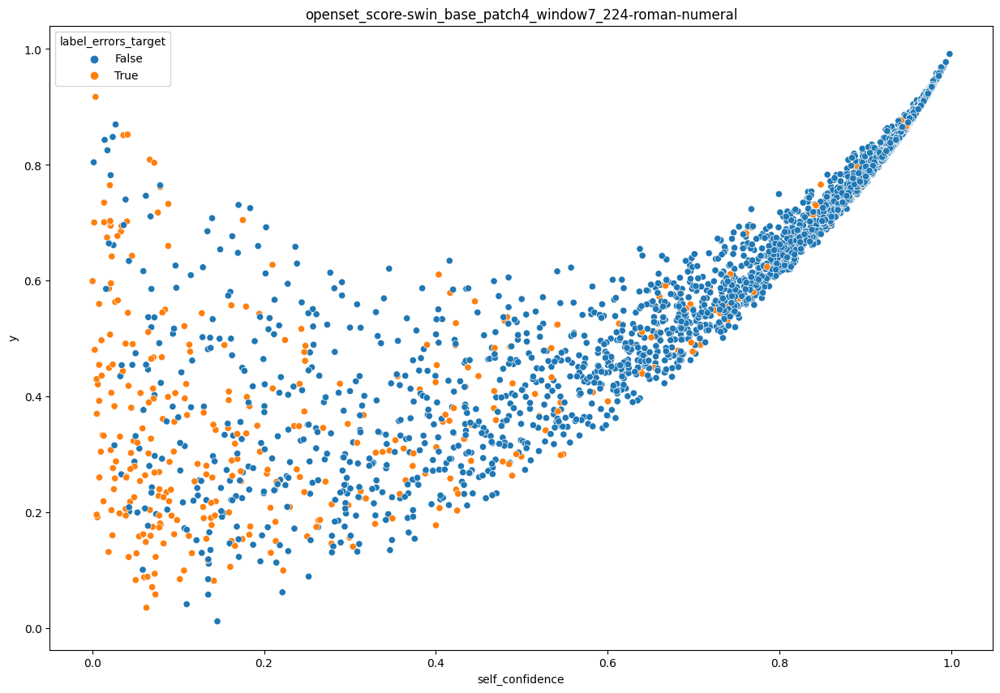

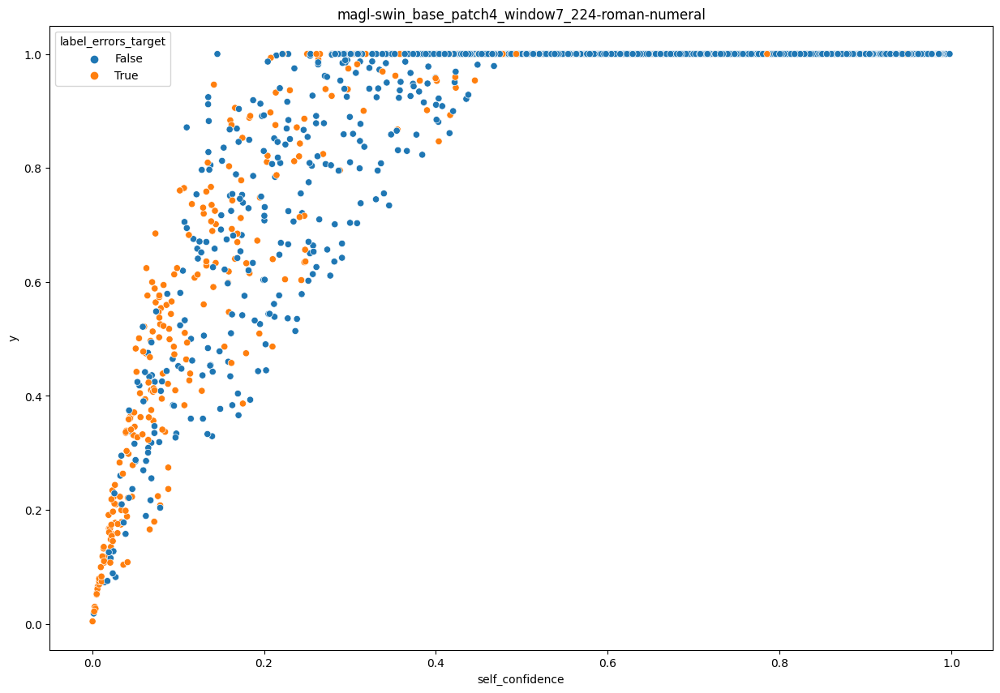

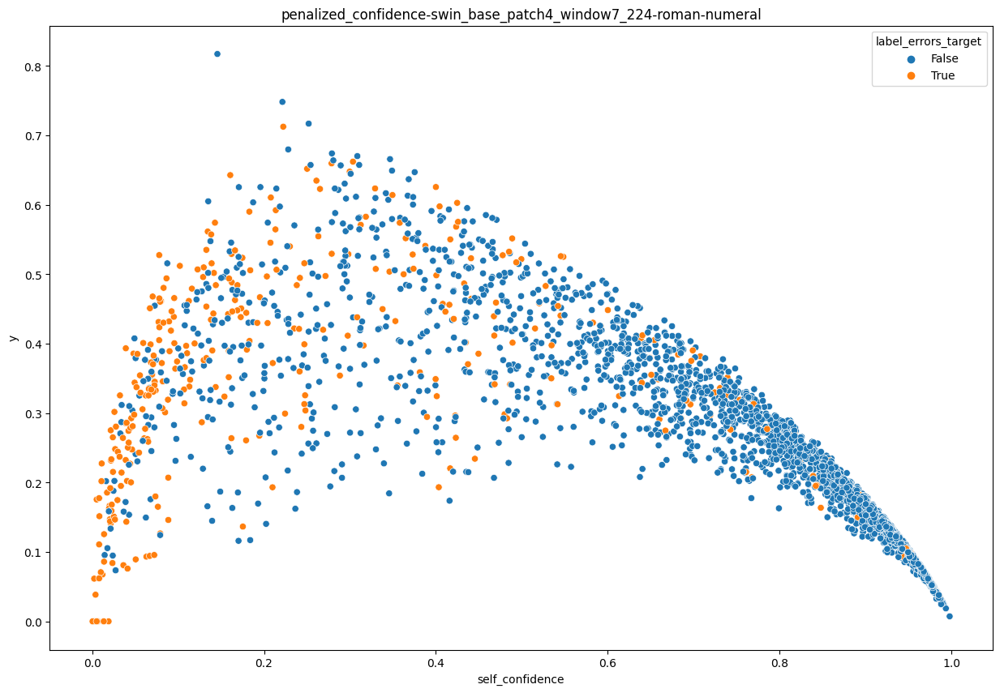

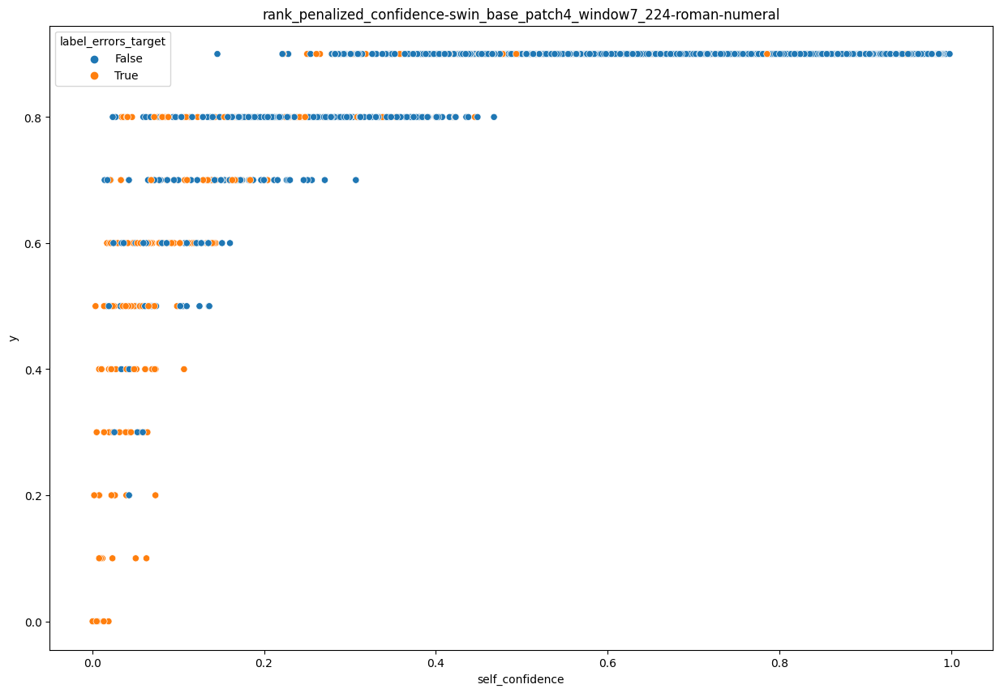

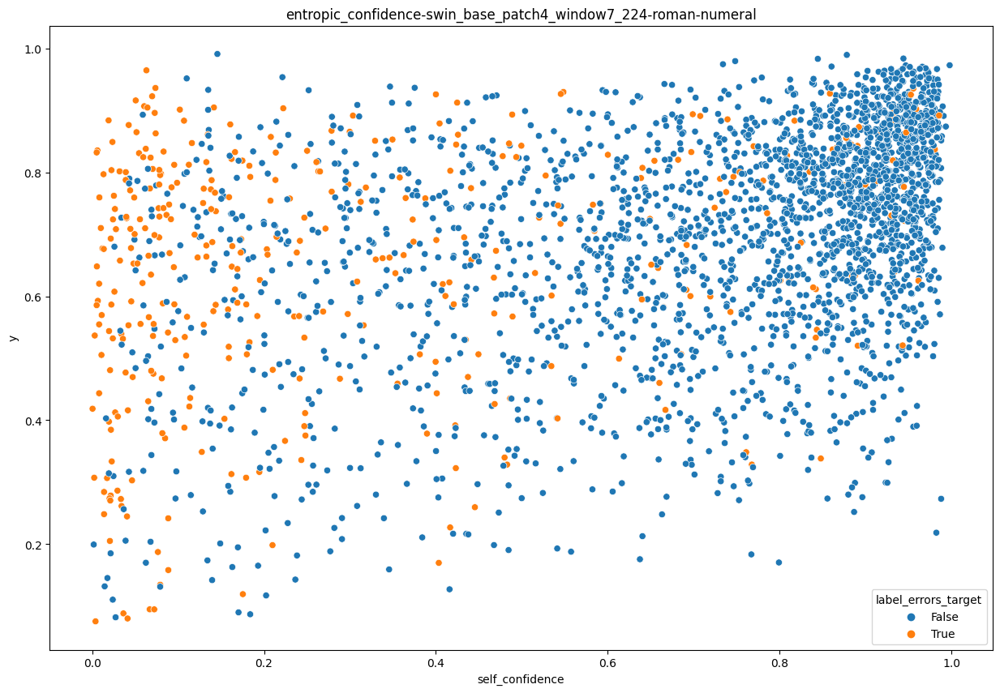

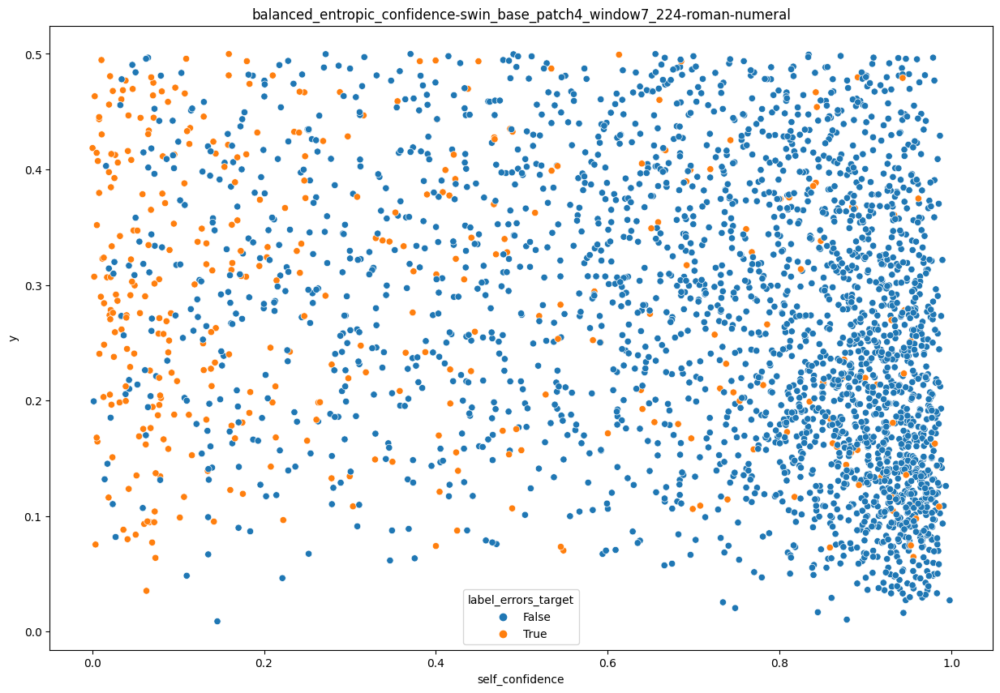

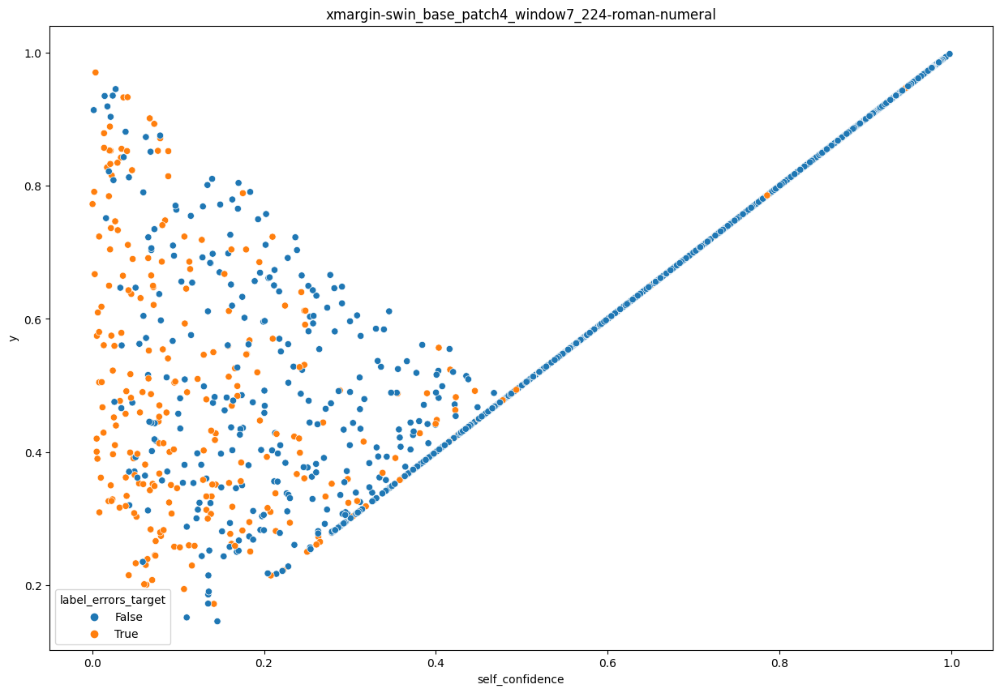

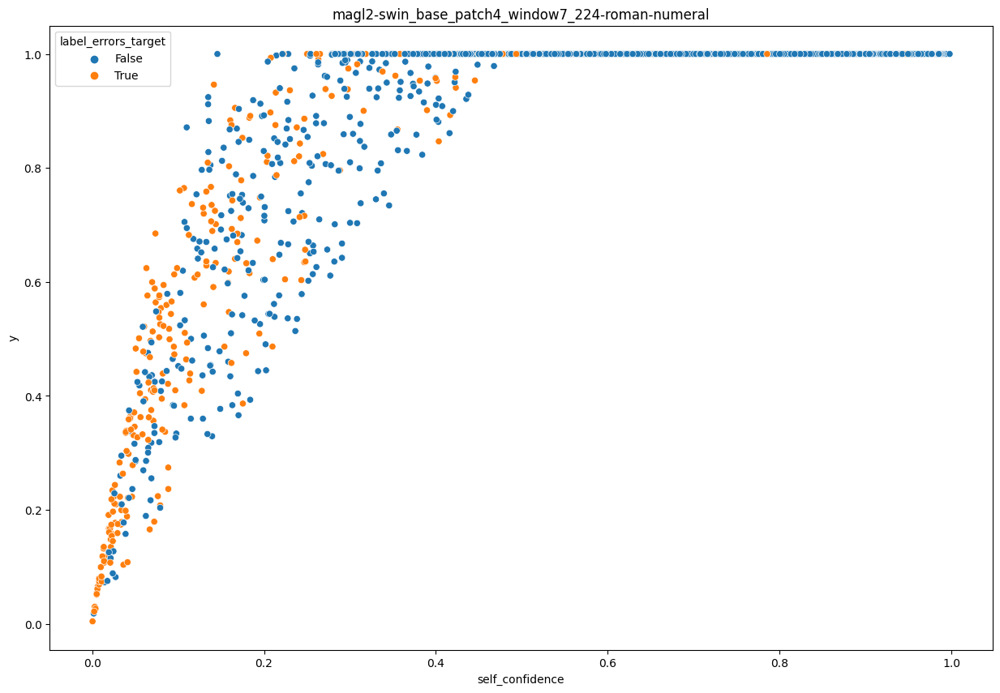

0.00454163271933794 0.9013081192970276 0.4112917795031611


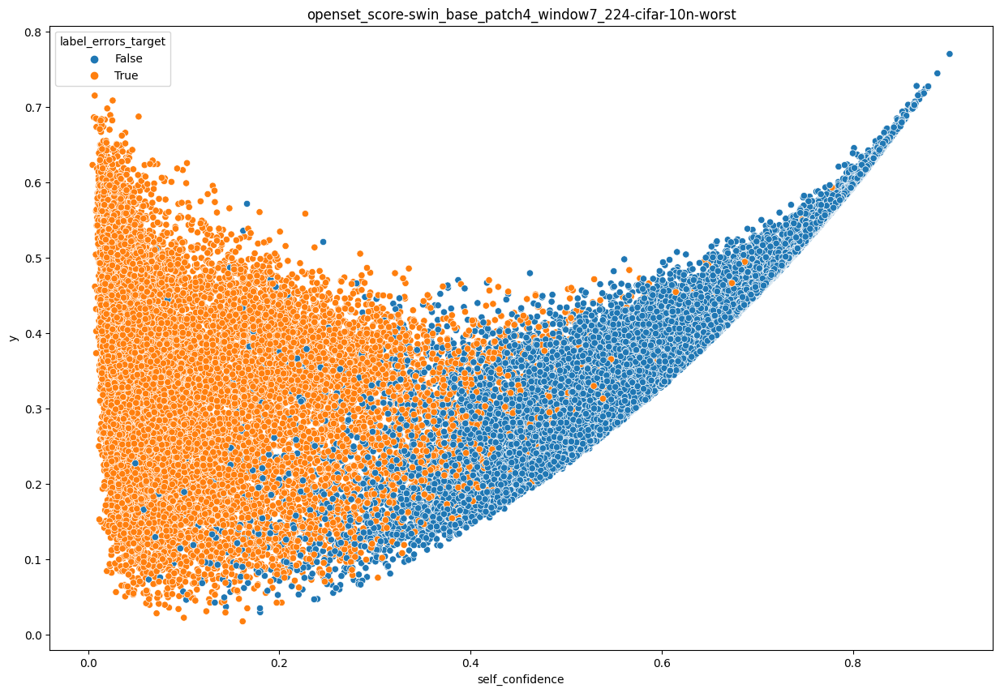

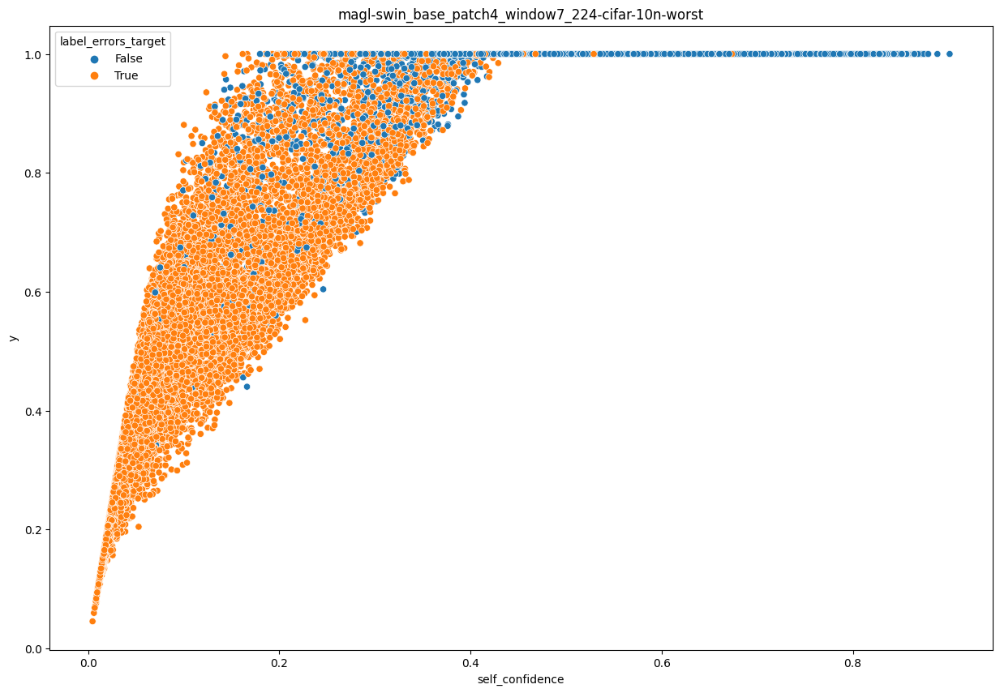

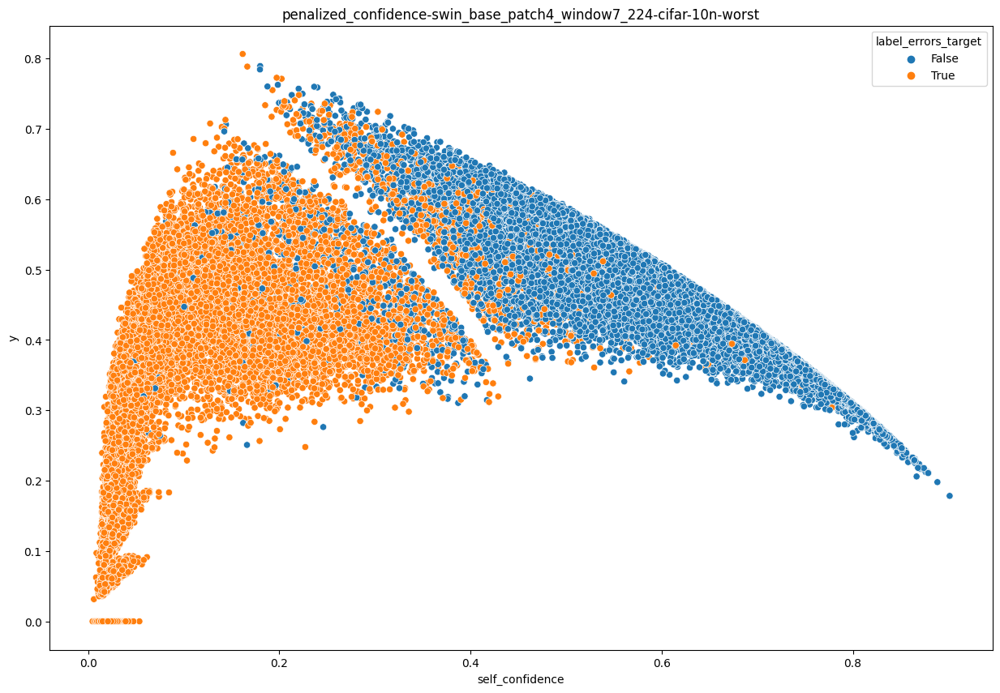

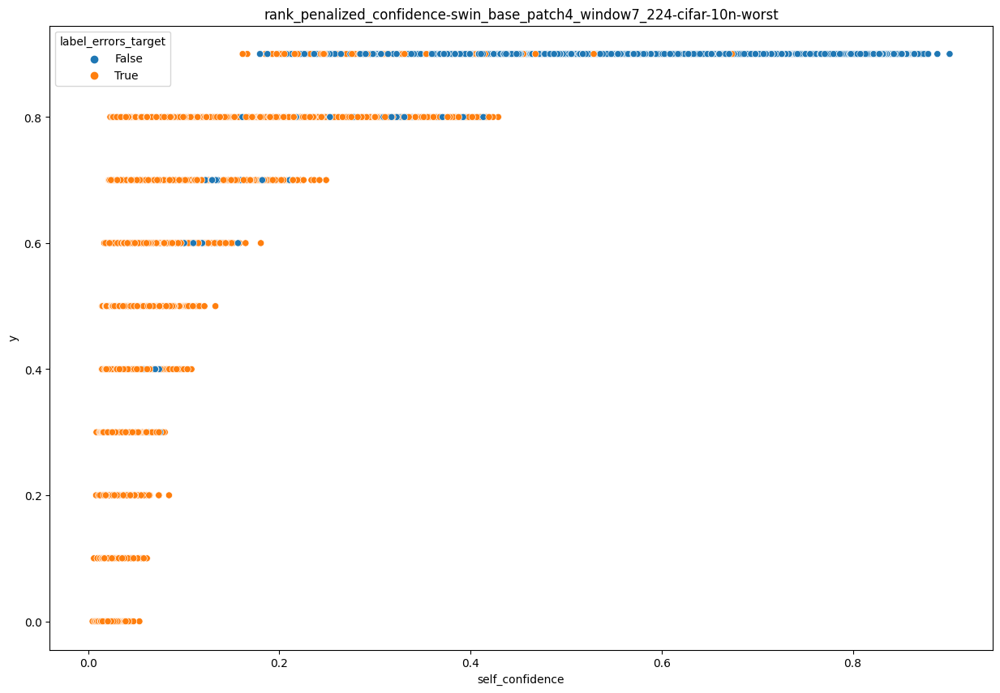

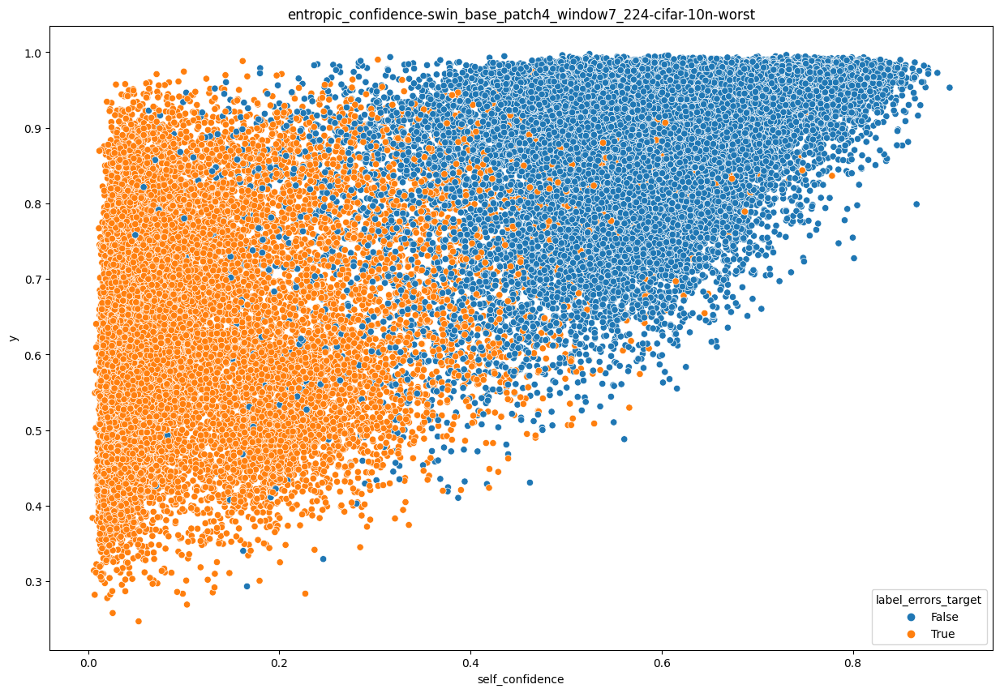

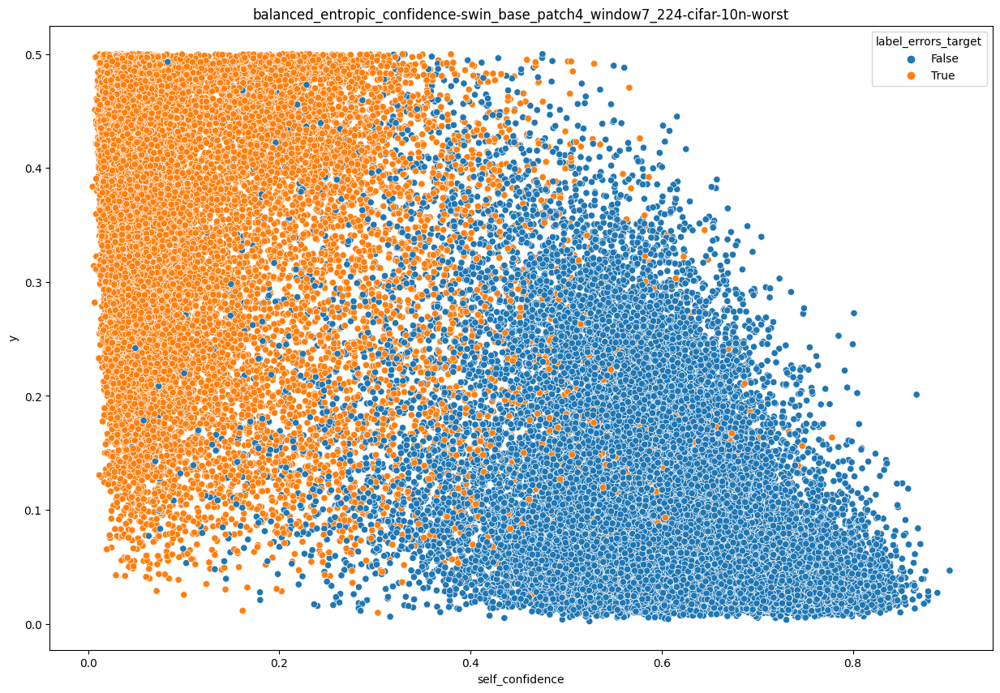

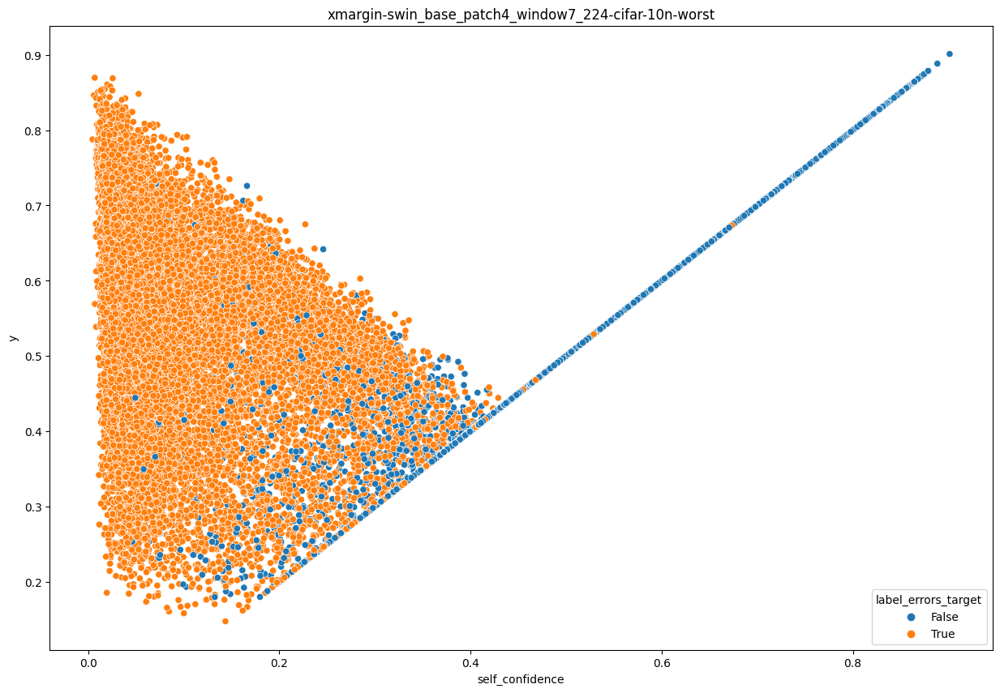

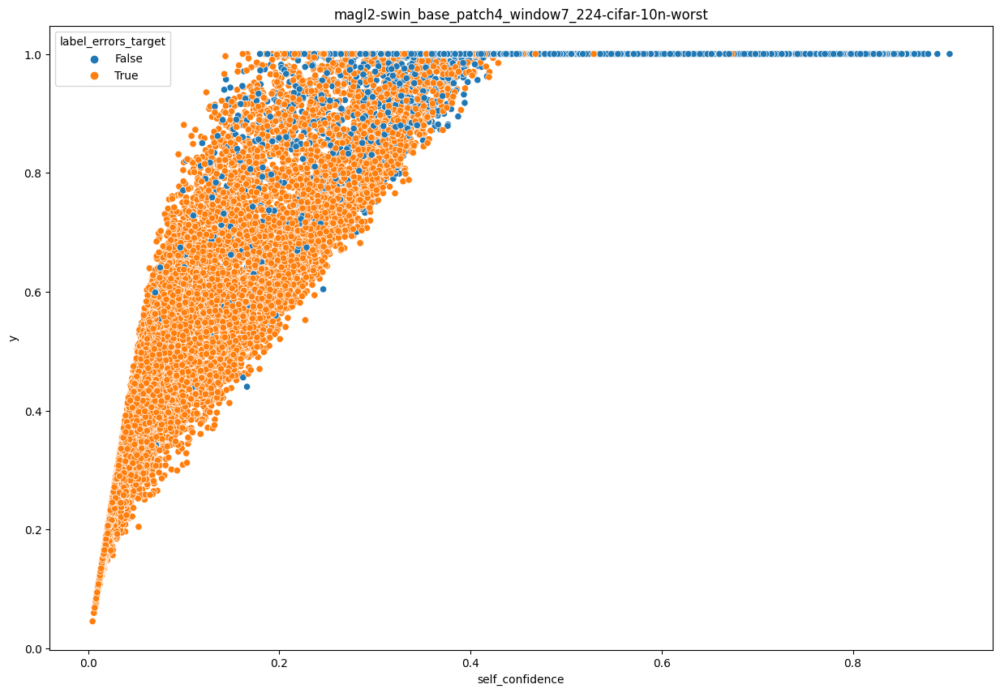

0.002667113207280636 0.978804349899292 0.7801819920737948


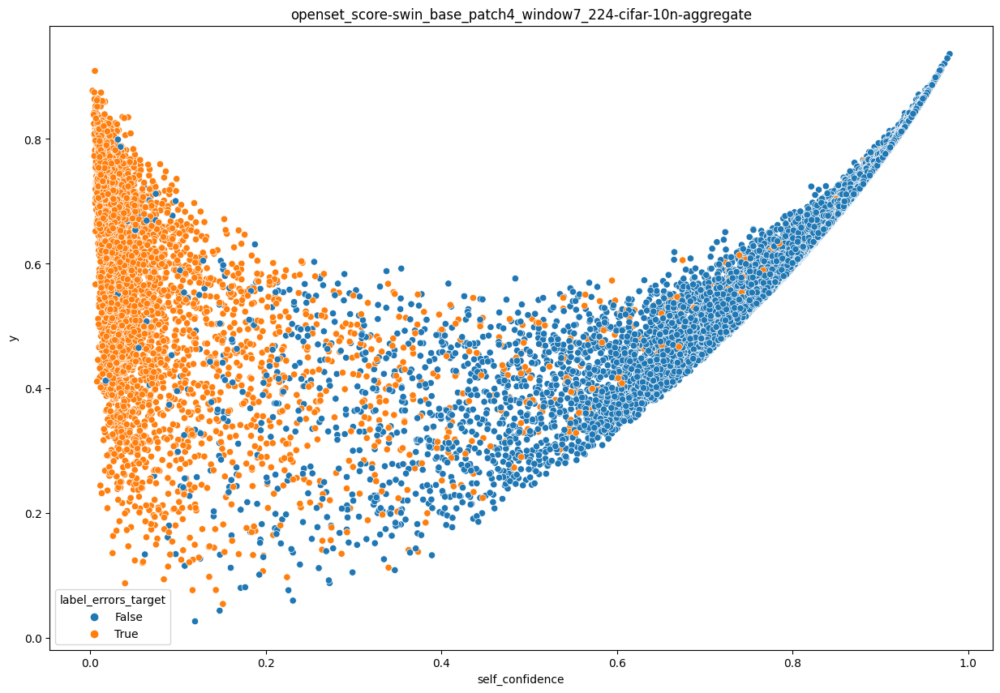

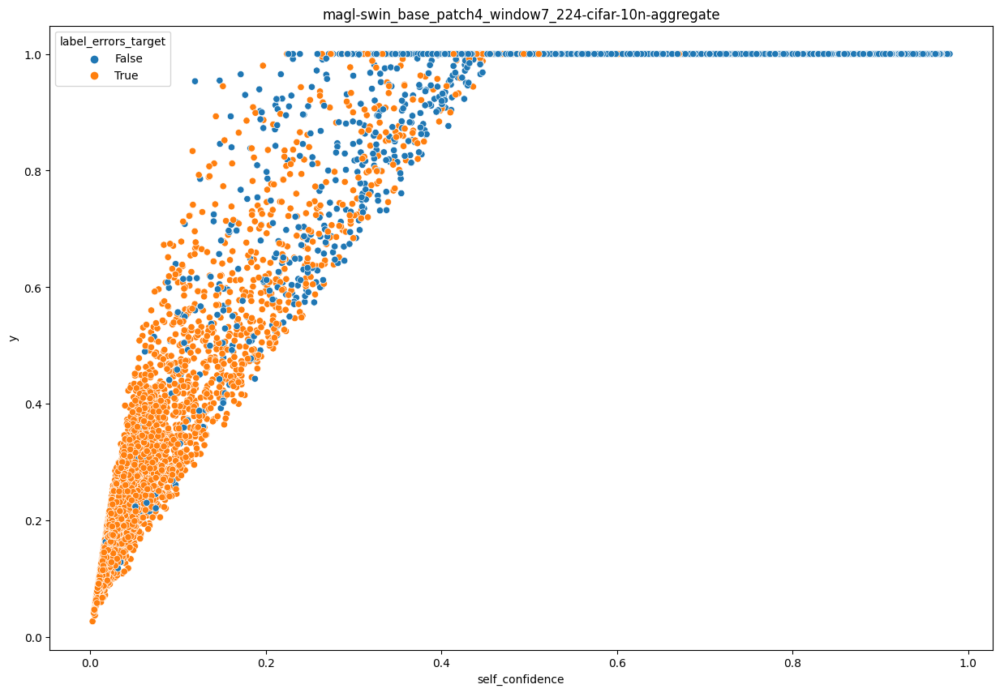

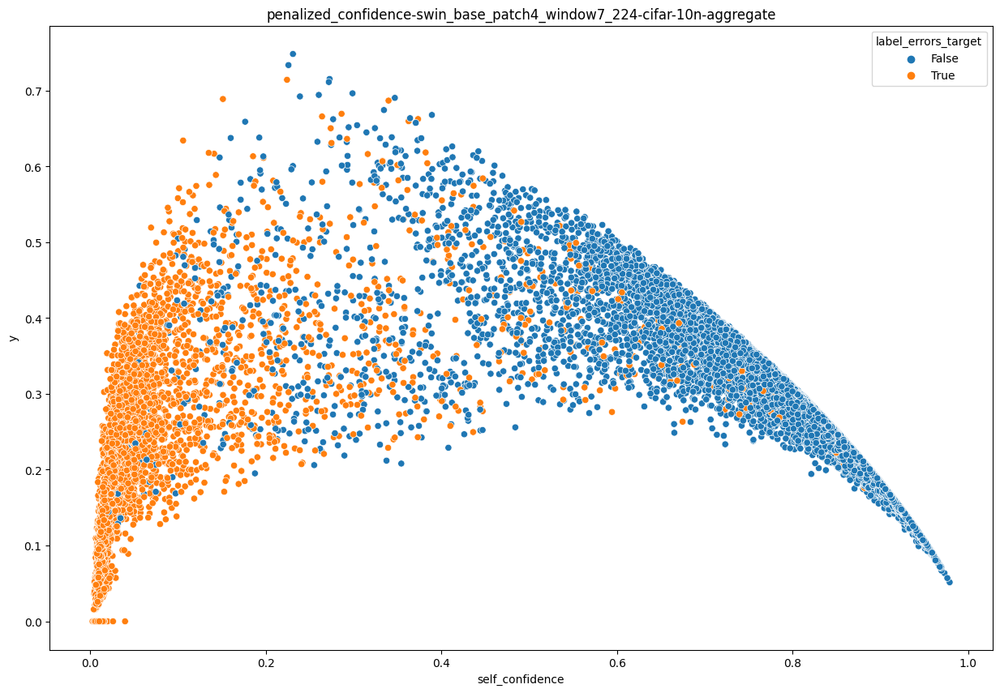

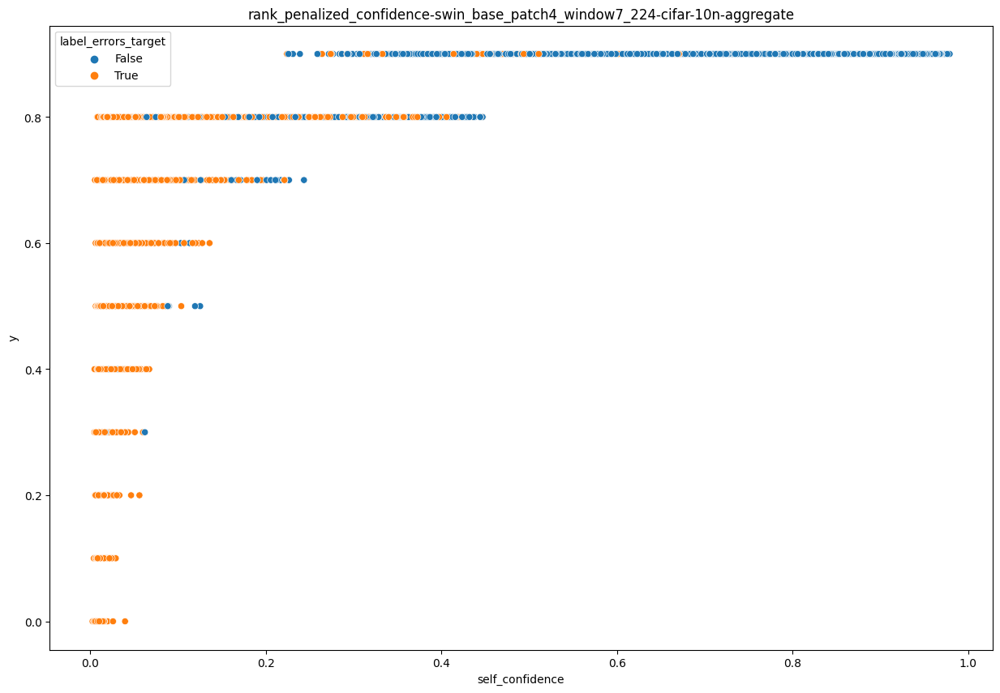

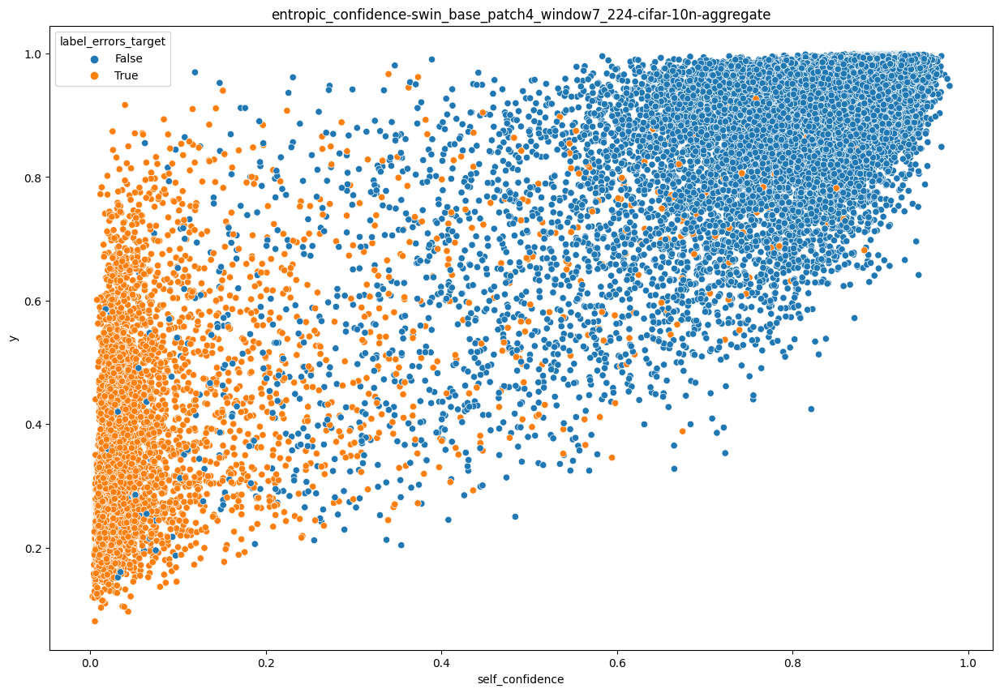

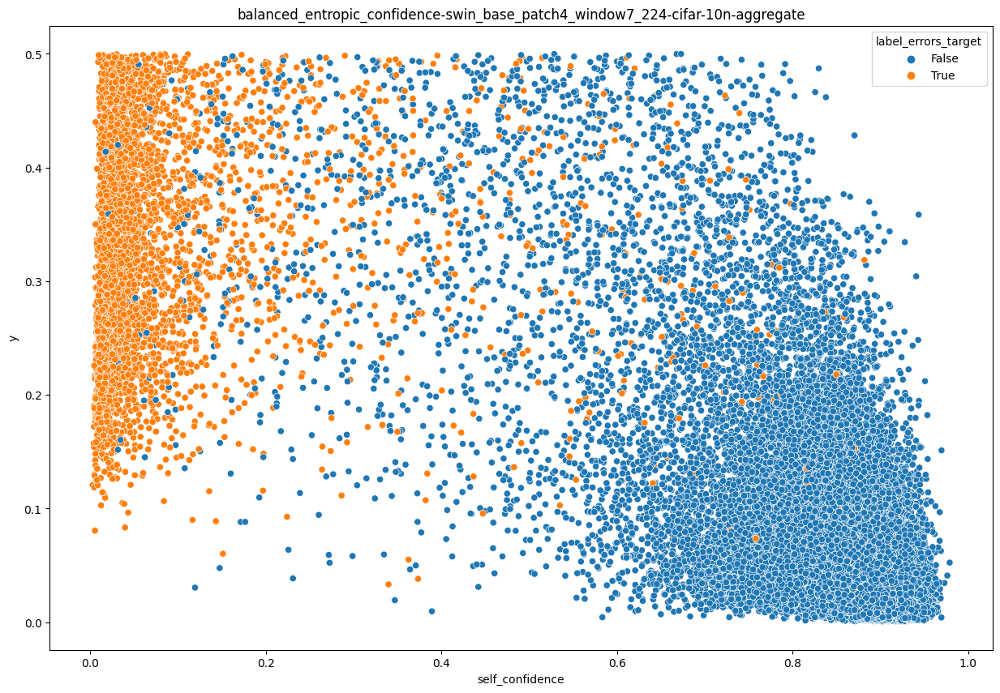

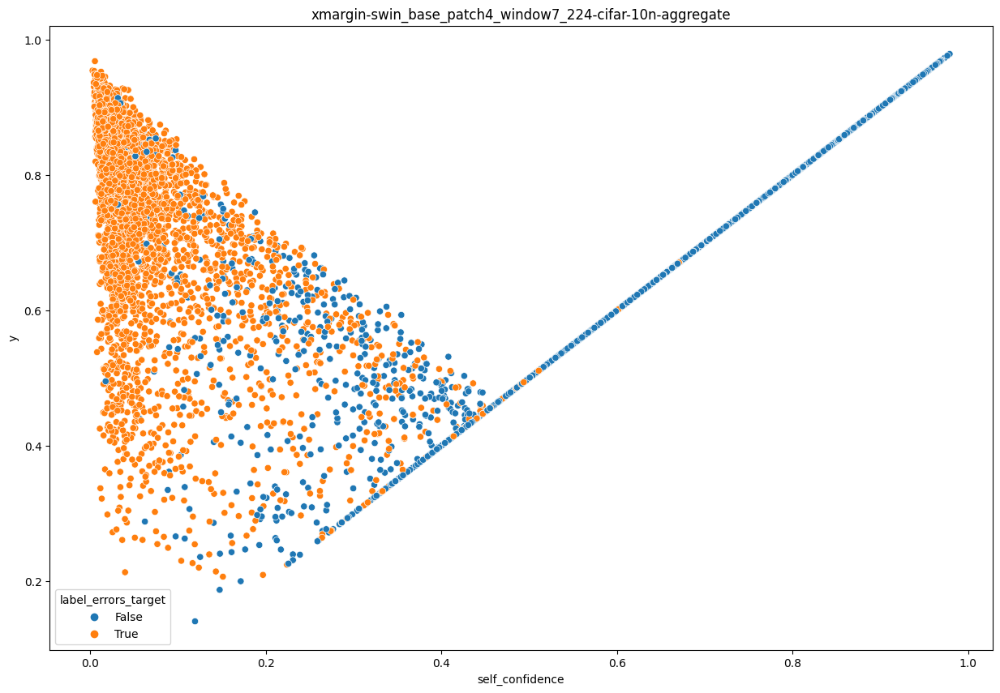

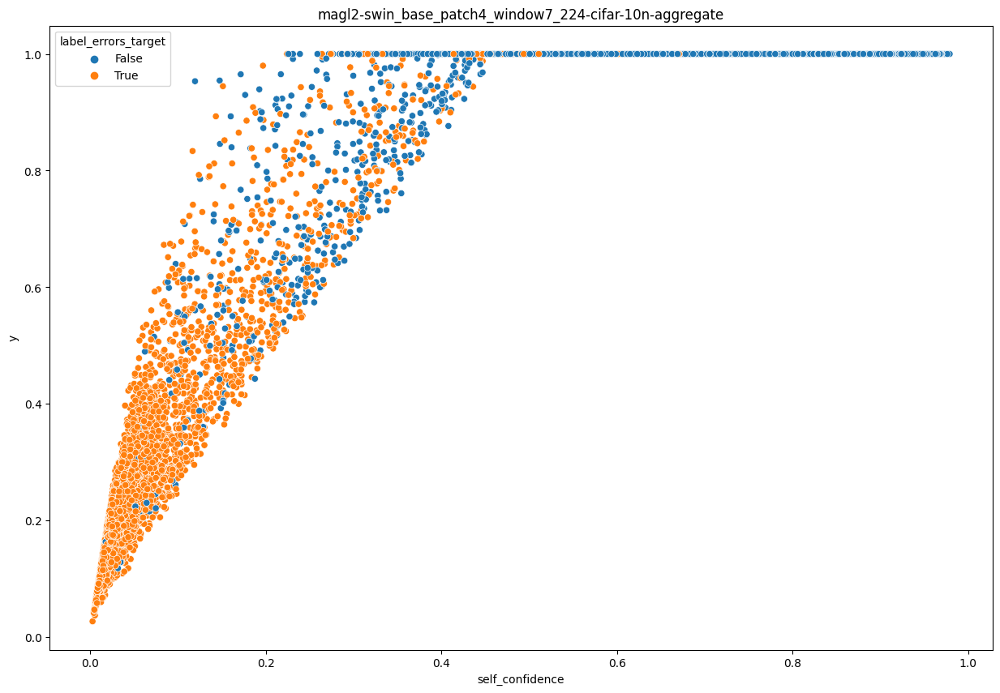

0.0009130455437116325 0.973401665687561 0.6028157767174148


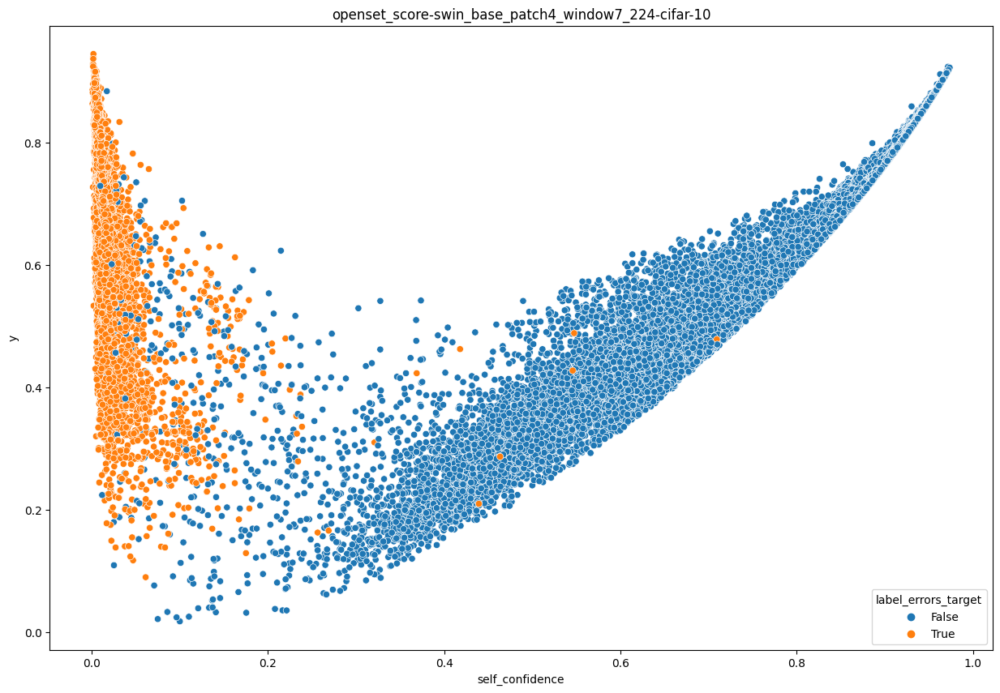

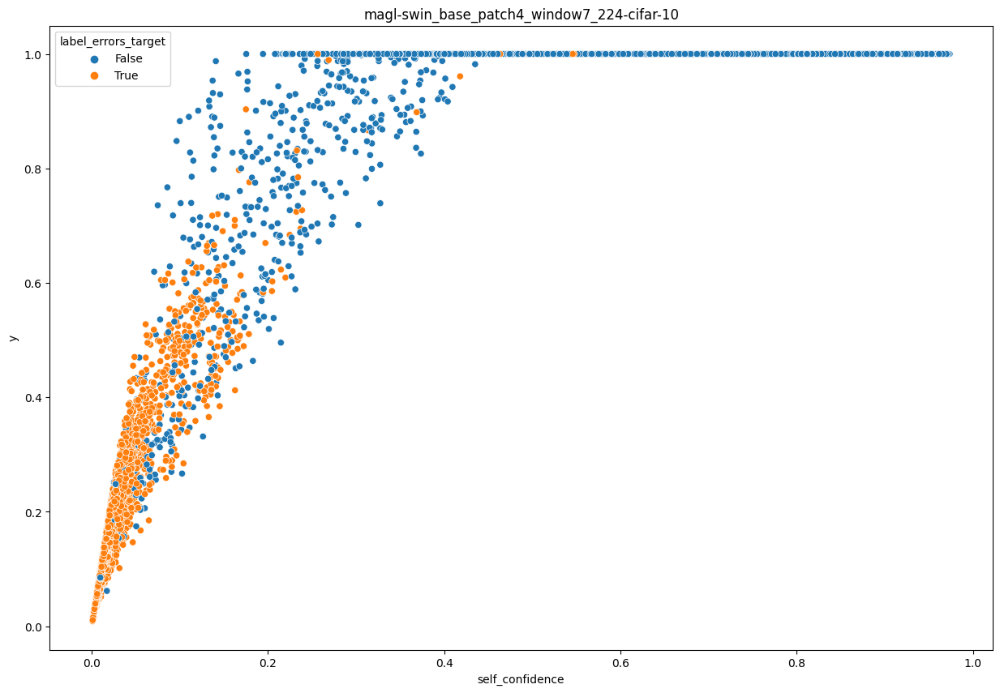

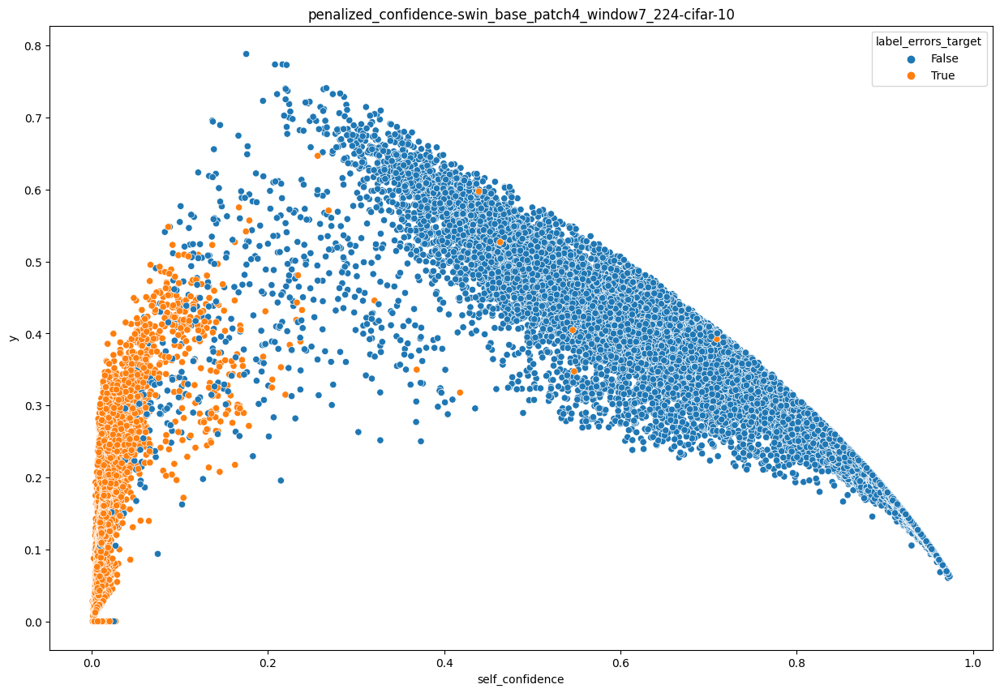

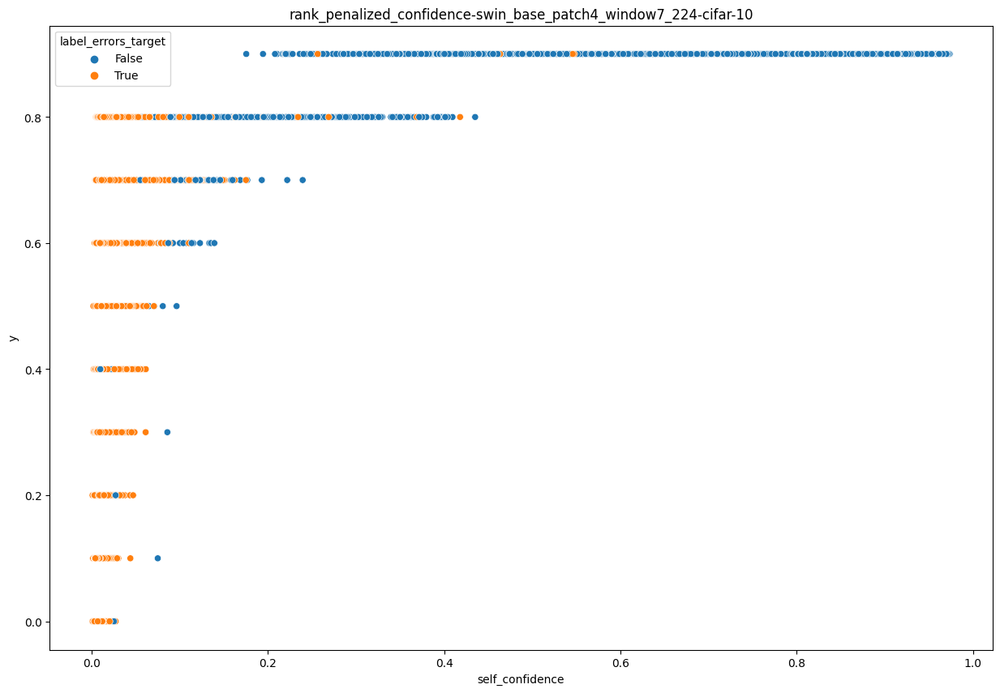

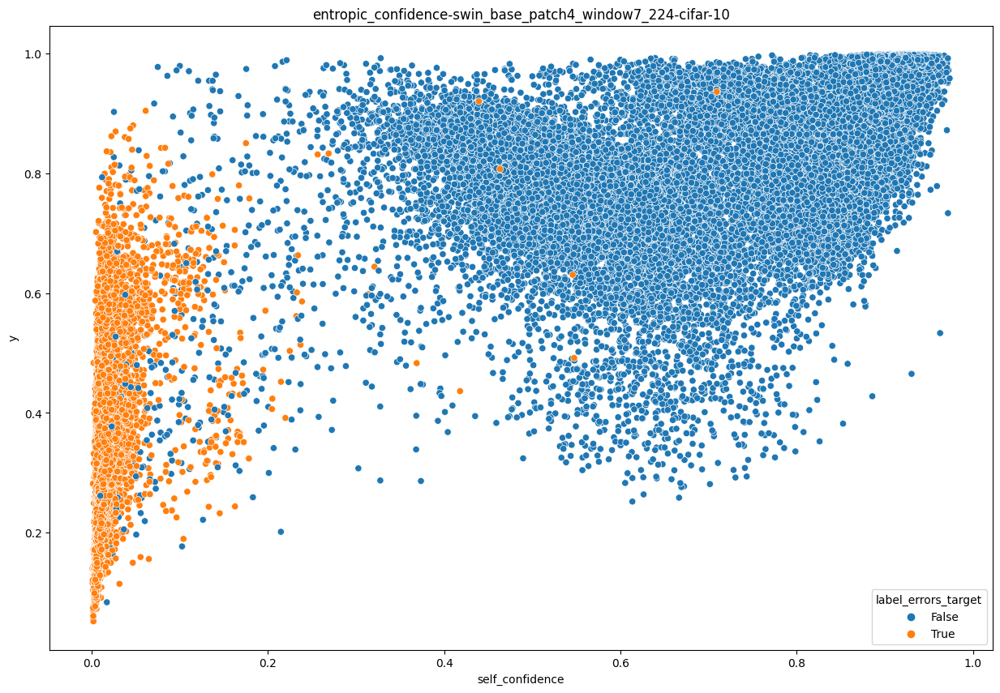

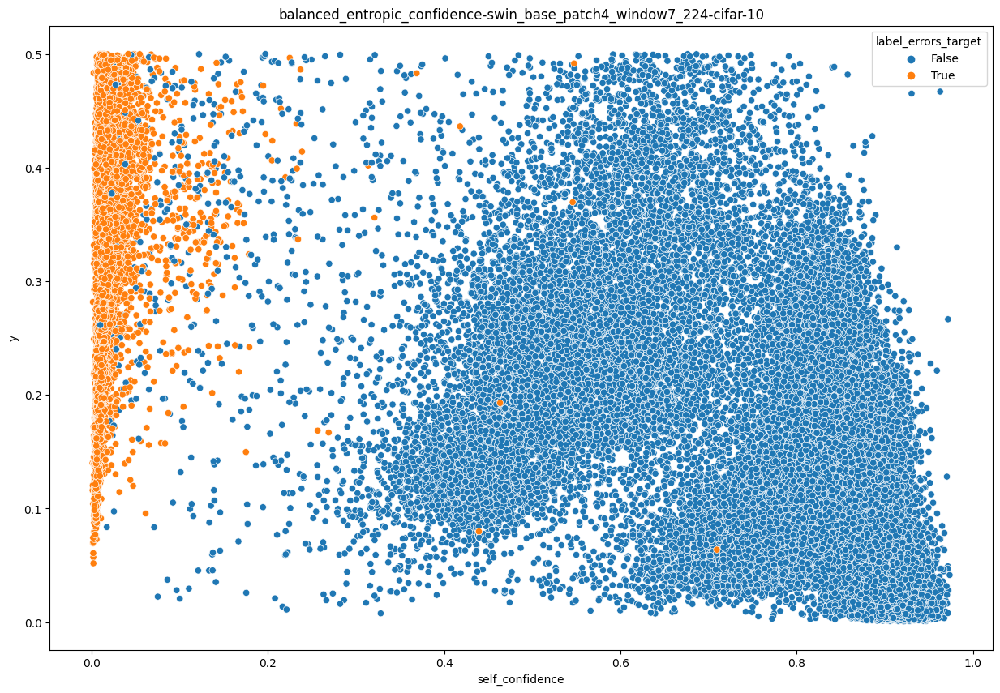

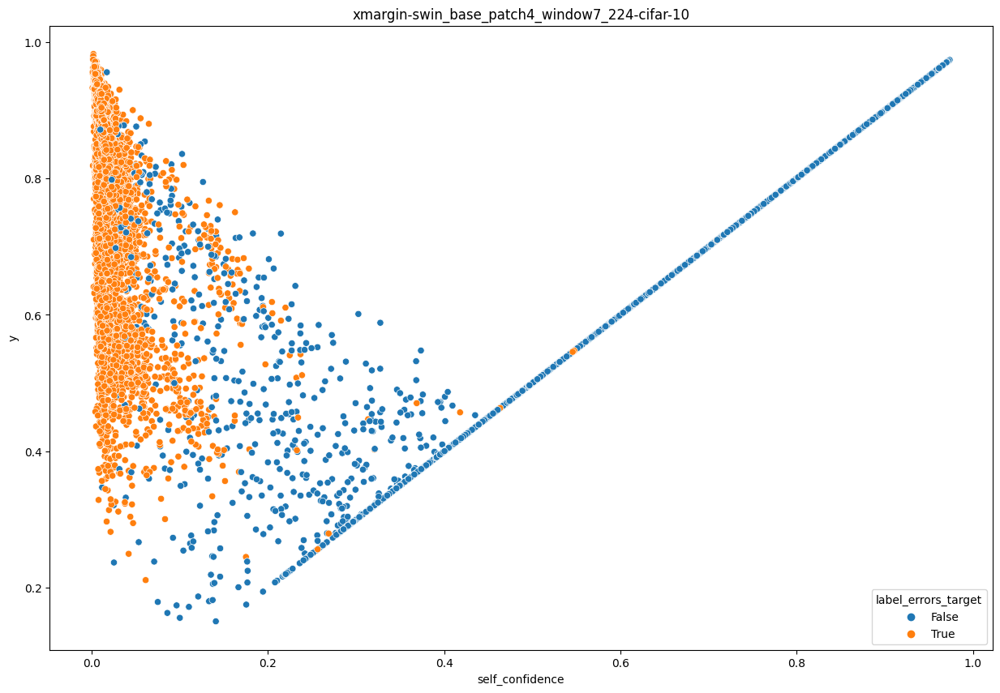

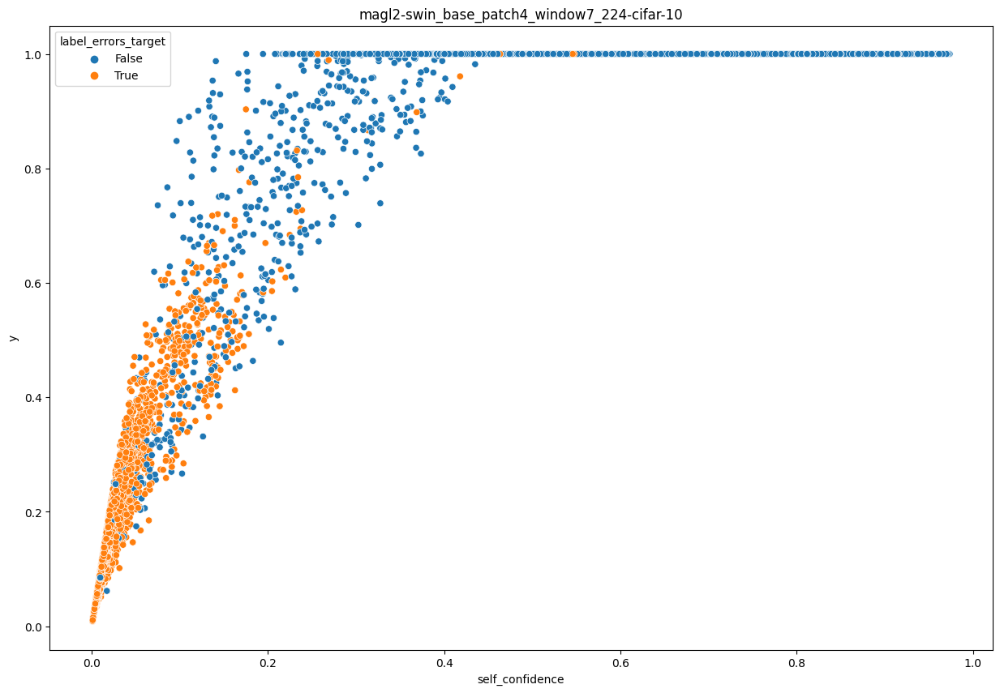

9.220203537552152e-06 0.9994230270385742 0.559617694944414


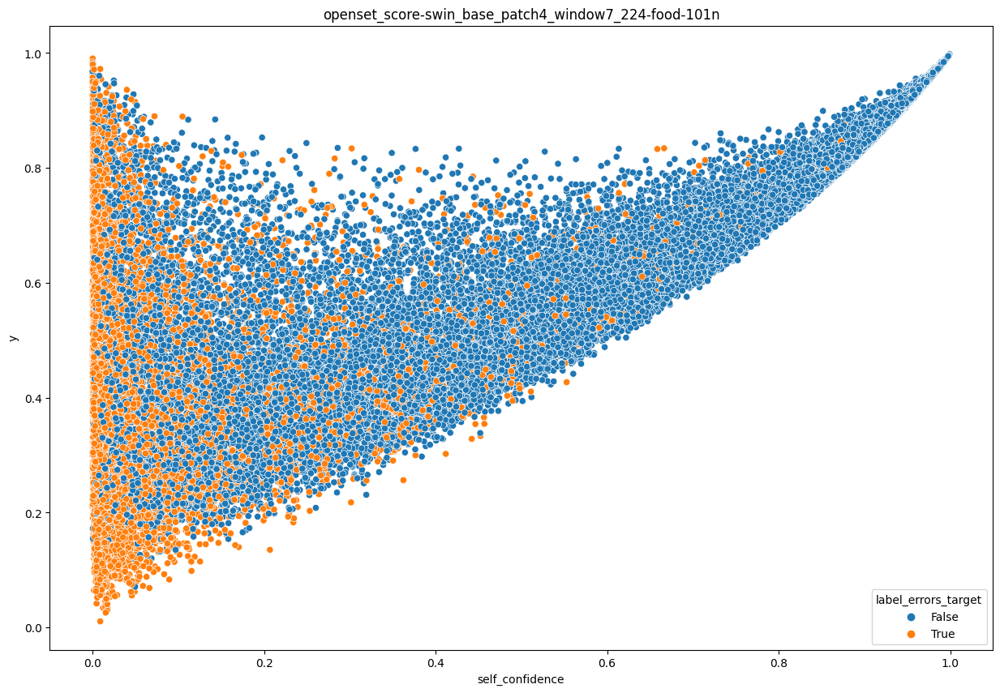

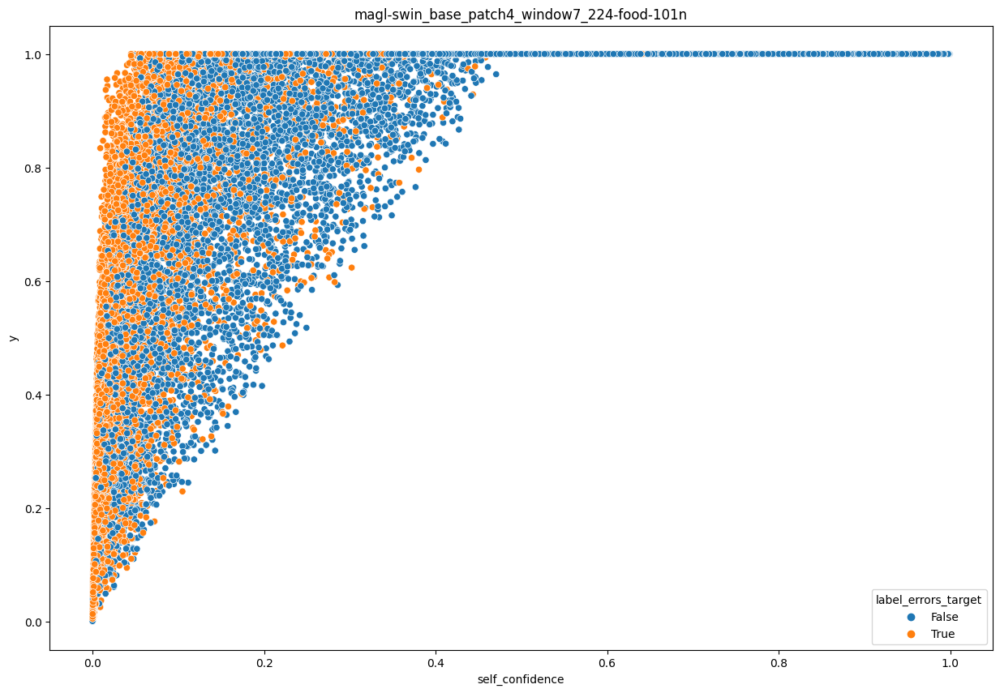

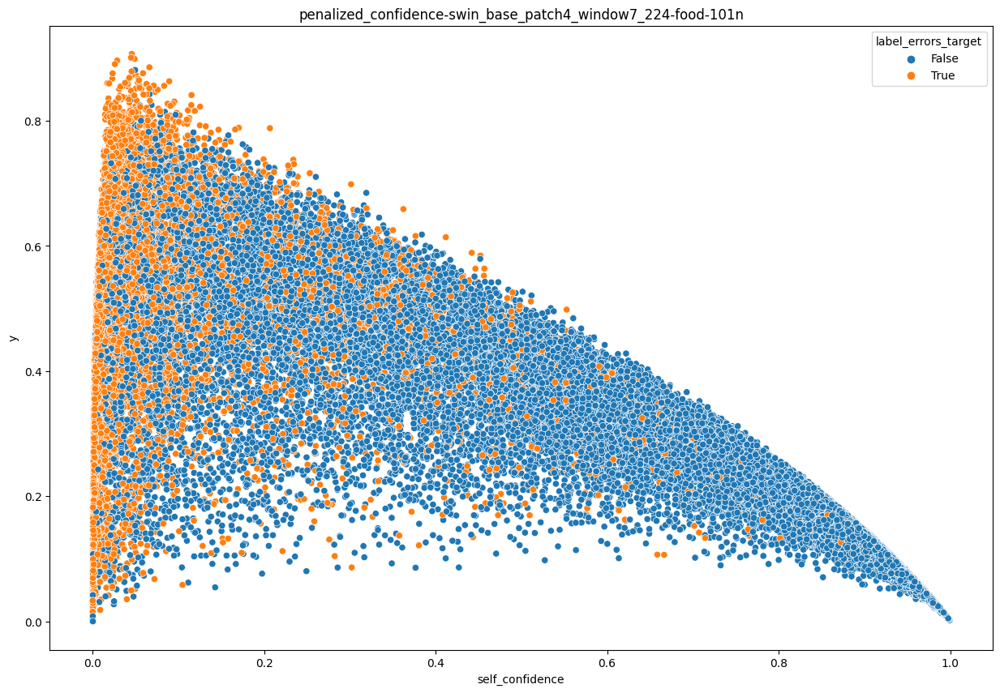

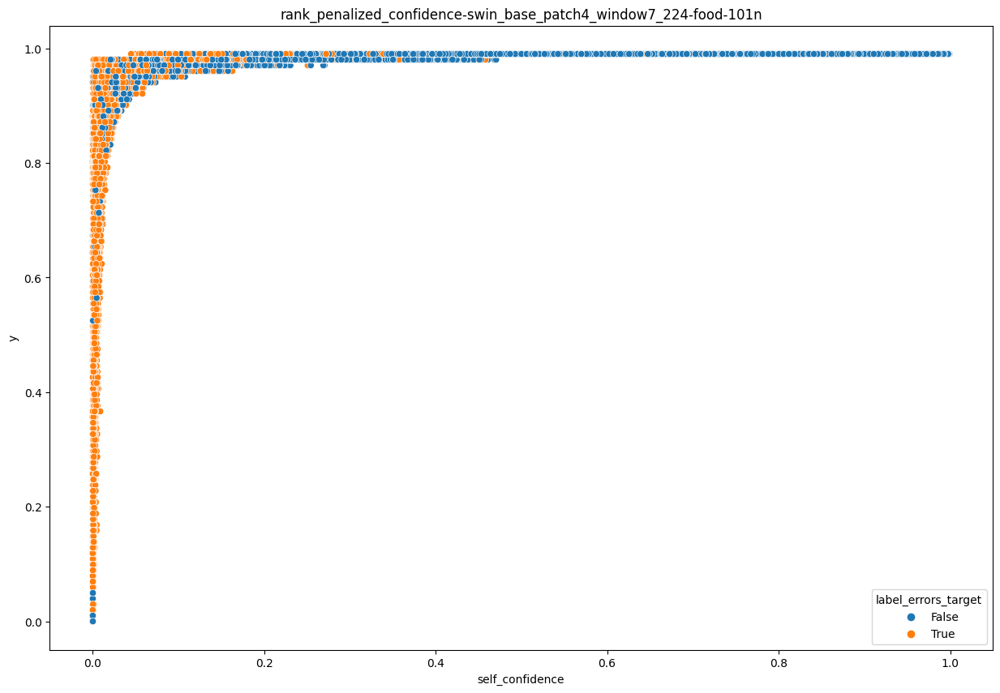

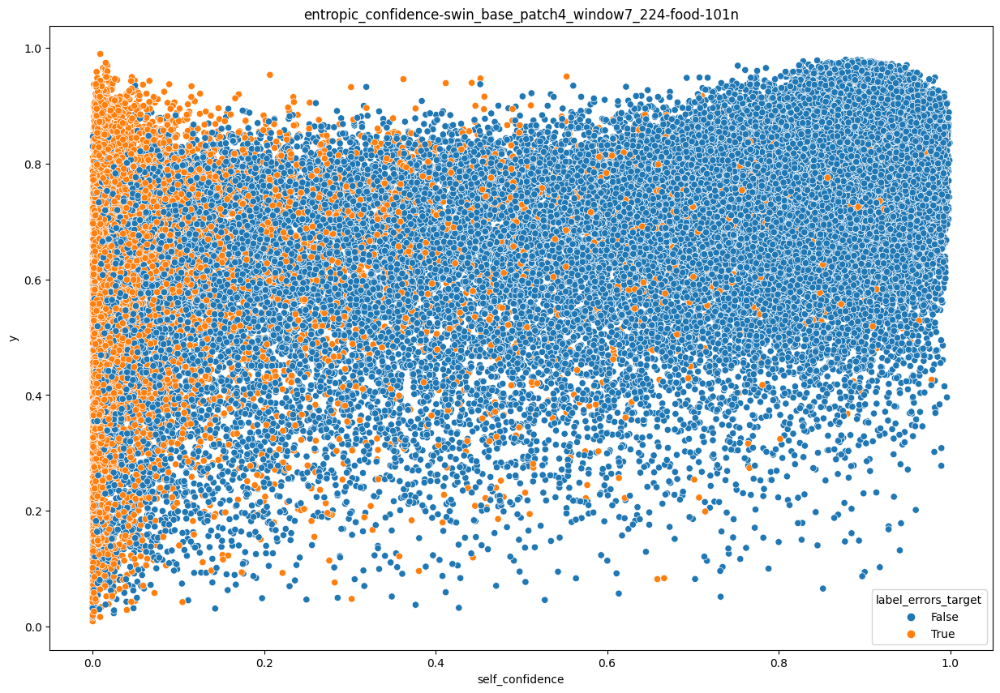

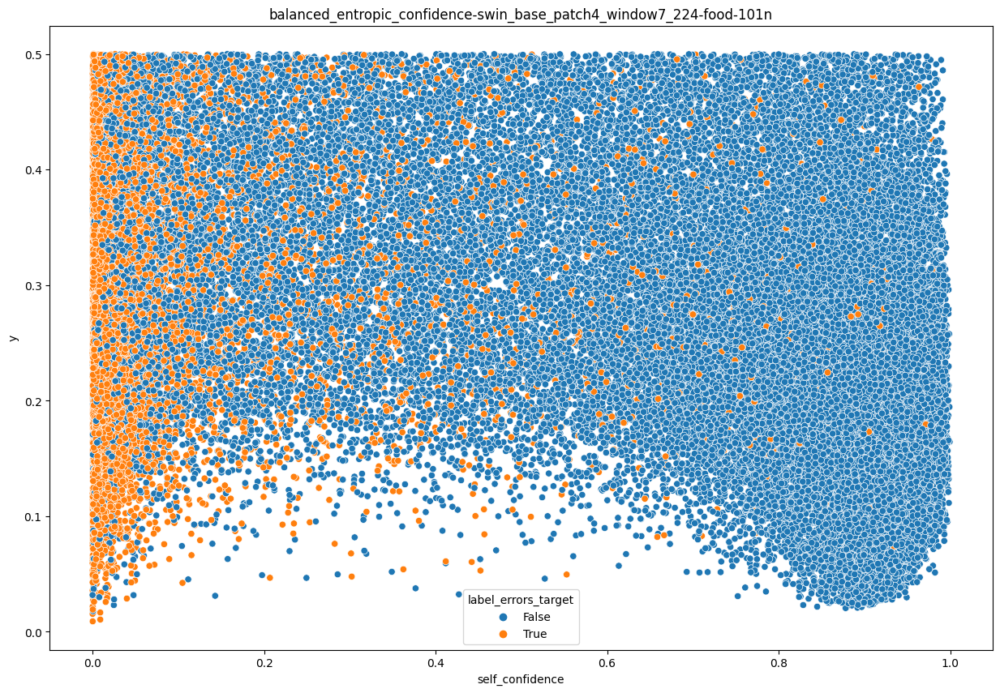

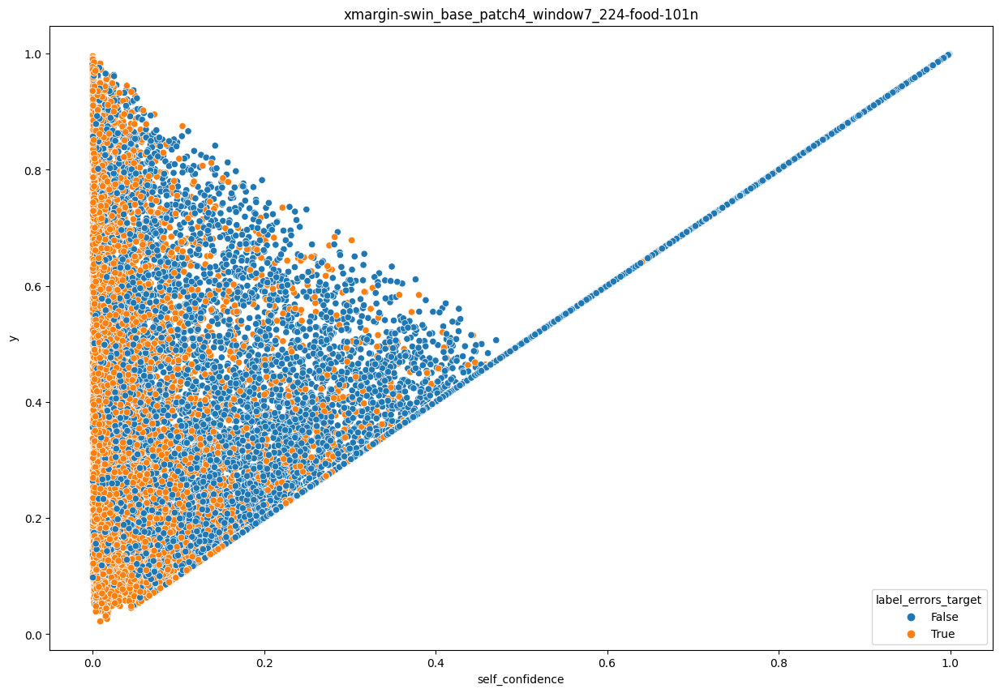

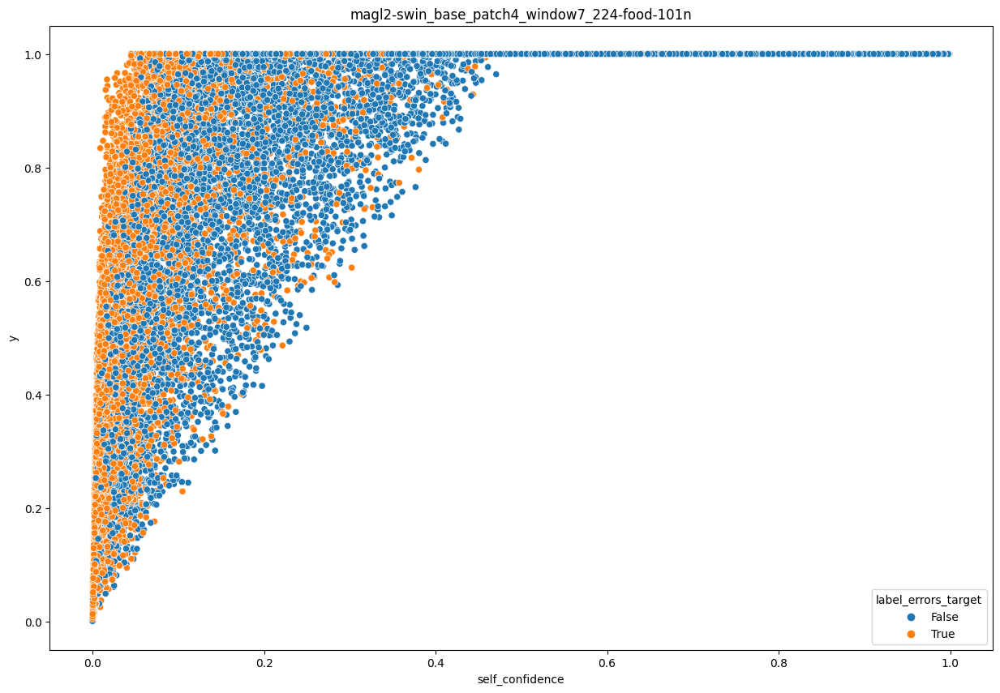

In [700]:
score_params = \
[
    ("self_confidence", False),
    ("self_confidence", True),
#     ("normalized_margin", False),
#     ("normalized_margin", True),
#     ("confidence_weighted_entropy", False),
    ("openset_score", False),
#     ("openset_score", True),
    ("magl", False),
    ("penalized_confidence", False),
    ("rank_penalized_confidence", False),
    ("entropic_confidence", False),
    ("balanced_entropic_confidence", False),
    ('xmargin', False),
    ('magl2', False),
]

evaluations = []
precision_recall_curves = [] # store this separately
accuracy_list = []

for experiment in experiments:
    
    # experiment results
    dataset = experiment["dataset"]
    model = experiment["model"]
    pred_probs = experiment["pred_probs"]
    labels = experiment["labels"]
    images = experiment["images"]
    label_errors_target = experiment["label_errors_mask"]
    type_train = experiment["type_train"]
    
    if 'swin' not in model:
        continue
        
    accuracy = {
        "dataset": dataset,
        "model": model,
        "cv_accuracy": (pred_probs.argmax(axis=1) == labels).mean()
    }
    
    accuracy_list.append(accuracy)
        
    # finding label issues (score param agnostic)
    find_label_issues = cleanlab.filter.find_label_issues(labels, pred_probs, filter_by='confident_learning')
    num_label_issues = cleanlab.count.num_label_issues(labels, pred_probs)
        
    for score_param in score_params:        
        # compute scoring method
        method, adjust_pred_probs = score_param
        x,y=0,0
        
        if "magl" in method:
            label_quality_scores,x,y = probability_mass_above_given_label_score(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=0.99)
        elif method == "penalized_confidence":
            label_quality_scores,x,y = penalized_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
        elif "balanced_entropic_confidence" in method:
            label_quality_scores,x,y = balanced_entropic_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=1.)
        elif method == "entropic_confidence":
            label_quality_scores,x,y = entropic_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
        elif "rank_penalized_confidence" in method:
            label_quality_scores,x,y = rank_penalized_confidence(labels, pred_probs, adjust_pred_probs=adjust_pred_probs, alpha=0.50)
        elif method == "openset_score":
            label_quality_scores,x,y = openset_score(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
        elif method == 'xmargin':
            label_quality_scores,x,y = margin_extra(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
        elif method == "magl2":
            label_quality_scores,x,y = probability_mass_above_given_label_score_2(labels, pred_probs, adjust_pred_probs=adjust_pred_probs)
        else:
            label_quality_scores = get_label_quality_scores(labels=labels, pred_probs=pred_probs, method=method, adjust_pred_probs=adjust_pred_probs)
        
        if not isinstance(x, int):
            df = pd.DataFrame(zip(x, y, label_errors_target), columns=['self_confidence','y','label_errors_target'])  
            sns.scatterplot(x="self_confidence", y="y", data=df, hue='label_errors_target')
            plt.title(f'{method}-{model}-{dataset}')
            plt.show()
    
        # compute accuracy of detecting label errors
        auroc = roc_auc_score(label_errors_target, 1 - label_quality_scores)

        # compute precision-recall curve using label quality scores
        precision, recall, thresholds = precision_recall_curve(label_errors_target, 1 - label_quality_scores)

        # compute prc auc scores
        auprc = auc(recall, precision)

        # lift at K where K = number of label errors
        lift_at_num_label_errors = lift_at_k(label_errors_target, 1 - label_quality_scores, k=label_errors_target.sum())
        
        # lift at k=100
        lift_at_100 = lift_at_k(label_errors_target, 1 - label_quality_scores, k=100)

        evaluation_results = {
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset,
            "model": model,
            "dataset_num_samples": labels.shape[0],
            "dataset_num_label_errors": label_errors_target.sum(),
            "auroc": auroc,
            "auprc": auprc,
            "MAE_label_issues": np.sum(np.abs(find_label_issues ^ label_errors_target)) / len(find_label_issues),
            "confident_MAD": np.abs(np.sum(find_label_issues) - np.sum(label_errors_target)),
            "estimated_MAD": np.abs(num_label_issues - np.sum(label_errors_target)),
            "lift_at_num_label_errors": lift_at_num_label_errors,
            "lift_at_100": lift_at_100,
            "type_train": type_train,
        }

        # store evaluation results
        evaluations.append(evaluation_results)
        
        precision_recall_curve_results = {
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset,
            "model": model,
            "label_quality_scores": label_quality_scores,
            "precision": precision,
            "recall": recall,
            "thresholds": thresholds,
            "type_train": type_train,
        }
        
        # store precision-recall curve results
        precision_recall_curves.append(precision_recall_curve_results)

# Evaluate Alphas

## MAGL Alphas

In [701]:
# args to pass to get_label_quality_scores()
score_params = \
[
    ("self_confidence", False, 0),
#     ("self_confidence", True, 0),
    ("magl_01", False, 0.1),
    ("magl_001", False, 0.01),
    ("magl_0001", False, 0.001),
    ("magl_05", False, 0.5),
    ("magl_08", False, 0.8),
    ("magl_95", False, 0.95),
    ("magl_99", False, 0.99),
]

new_methods = [param[0] for param in score_params if "self_confidence" not in param]
print(new_methods)
    
evaluations, precision_recall_curves, accuracy_list = eval_exp(experiments, score_params)
dfs_new_methods_results = vis_results(evaluations, new_methods)

for method in set(dfs_new_methods_results['method'].tolist()):
    print(method)
    print(display(HTML(dfs_new_methods_results.loc[dfs_new_methods_results['method'] == method].describe().to_html())))

for method in new_methods:
    scatterplot(dfs_new_methods_results, method, hue='dataset')

['magl_01', 'magl_001', 'magl_0001', 'magl_05', 'magl_08', 'magl_95', 'magl_99']


TypeError: unsupported operand type(s) for -: 'int' and 'tuple'

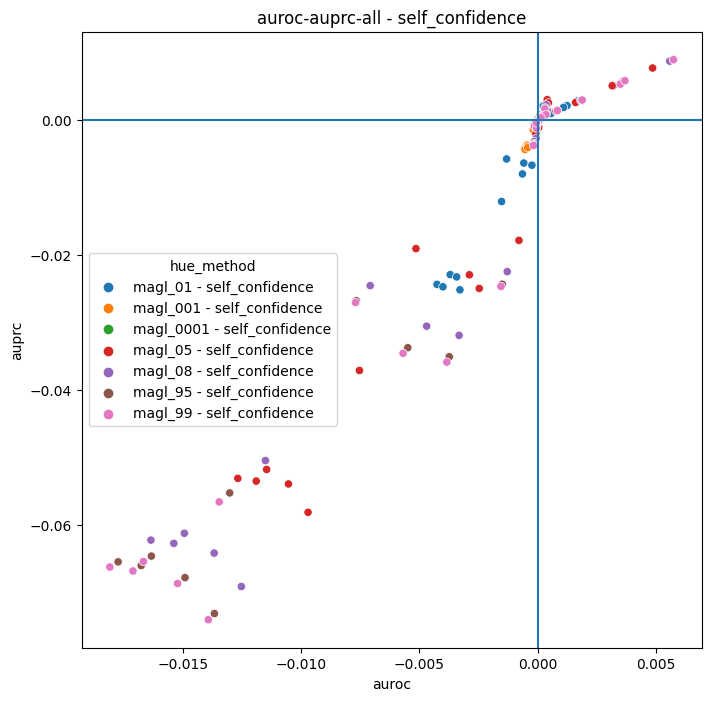

In [360]:
dfs_new_methods_results['hue_method'] = dfs_new_methods_results['method']
dfs_new_methods_results['method'] = 'all - self_confidence'
scatterplot(dfs_new_methods_results, 'all', hue='hue_method')

## Rank Penalized Confidence Alphas

['rank_penalized_confidence_01', 'rank_penalized_confidence_05', 'rank_penalized_confidence_08', 'rank_penalized_confidence_095', 'rank_penalized_confidence_099']
rank_penalized_confidence_08 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.000227,-0.000969,-0.004886,0.075617
std,19582.096464,6761.278694,0.000569,0.007989,0.025012,0.175018
min,2831.000000,372.000000,-0.001458,-0.014773,-0.102288,-0.162734
25%,50000.000000,4505.000000,-0.000538,-0.004046,-0.017092,0.000000
50%,50000.000000,9746.000000,-0.000102,-0.001381,0.000000,0.000000
75%,50000.000000,9973.000000,0.000161,0.002652,0.005443,0.152204
max,52867.000000,20104.000000,0.000608,0.020167,0.040915,0.608817


None
rank_penalized_confidence_099 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,2.500000e+01,25.000000,25.000000
mean,41139.600000,8940.000000,0.000036,1.133034e-03,-0.000107,0.040484
std,19582.096464,6761.278694,0.000080,1.952468e-03,0.000742,0.099698
min,2831.000000,372.000000,-0.000051,-5.330650e-04,-0.002464,-0.108490
25%,50000.000000,4505.000000,-0.000018,-1.198821e-04,0.000000,0.000000
50%,50000.000000,9746.000000,-0.000001,-4.544703e-07,0.000000,0.000000
75%,50000.000000,9973.000000,0.000082,2.654833e-03,0.000371,0.076102
max,52867.000000,20104.000000,0.000213,5.606719e-03,0.000866,0.379714


None
rank_penalized_confidence_01 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.001374,-0.007501,-0.034148,0.029956
std,19582.096464,6761.278694,0.001079,0.012125,0.070674,0.147979
min,2831.000000,372.000000,-0.003380,-0.035573,-0.265948,-0.228306
25%,50000.000000,4505.000000,-0.001935,-0.014095,-0.042730,0.000000
50%,50000.000000,9746.000000,-0.001072,-0.004182,-0.020458,0.000000
75%,50000.000000,9973.000000,-0.000565,-0.000868,0.010763,0.000000
max,52867.000000,20104.000000,0.000224,0.015345,0.061373,0.380511


None
rank_penalized_confidence_05 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.000822,-0.005419,-0.021578,0.033000
std,19582.096464,6761.278694,0.000957,0.011256,0.064542,0.148120
min,2831.000000,372.000000,-0.002938,-0.030247,-0.265948,-0.228306
25%,50000.000000,4505.000000,-0.001314,-0.010994,-0.020458,0.000000
50%,50000.000000,9746.000000,-0.000532,-0.003052,-0.006033,0.000000
75%,50000.000000,9973.000000,-0.000179,0.000518,0.014782,0.076102
max,52867.000000,20104.000000,0.000418,0.016601,0.061373,0.380511


None
rank_penalized_confidence_095 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,0.000020,0.001262,-0.002614,0.050490
std,19582.096464,6761.278694,0.000225,0.004293,0.009347,0.131719
min,2831.000000,372.000000,-0.000382,-0.003910,-0.040915,-0.162734
25%,50000.000000,4505.000000,-0.000119,-0.000965,-0.002464,0.000000
50%,50000.000000,9746.000000,-0.000010,-0.000338,0.000000,0.000000
75%,50000.000000,9973.000000,0.000198,0.004472,0.001485,0.076102
max,52867.000000,20104.000000,0.000368,0.014513,0.004927,0.380511


None


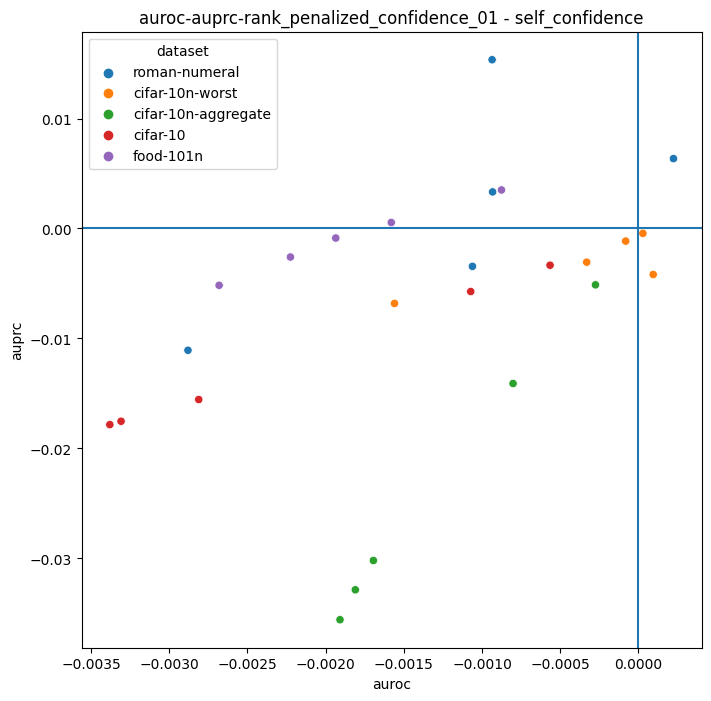

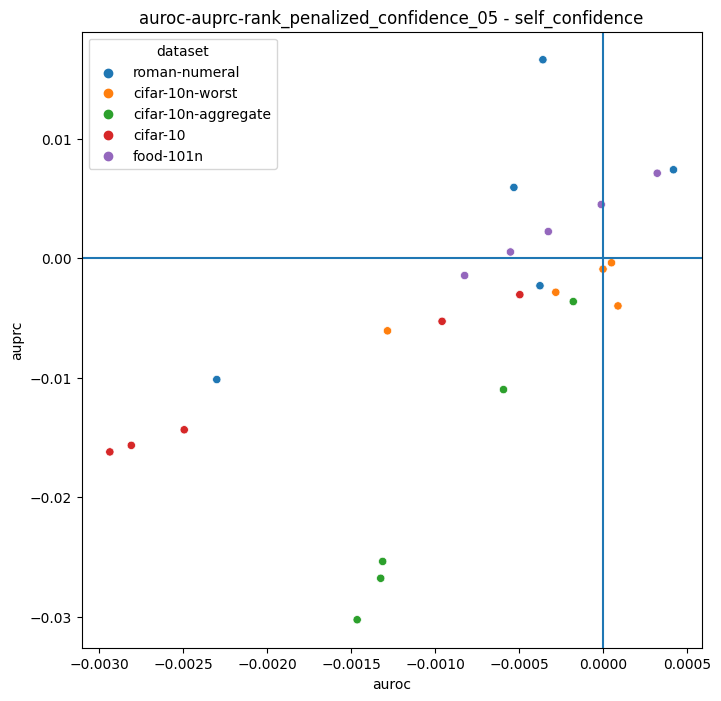

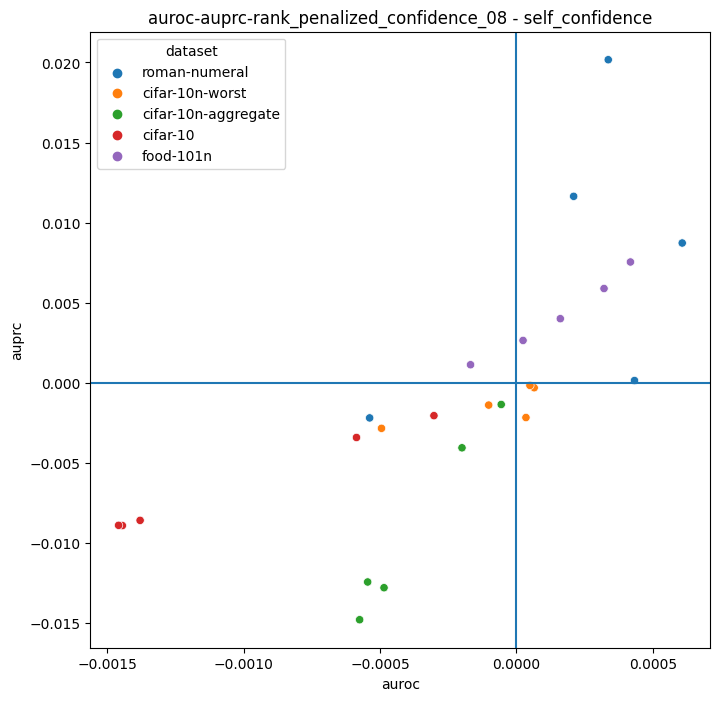

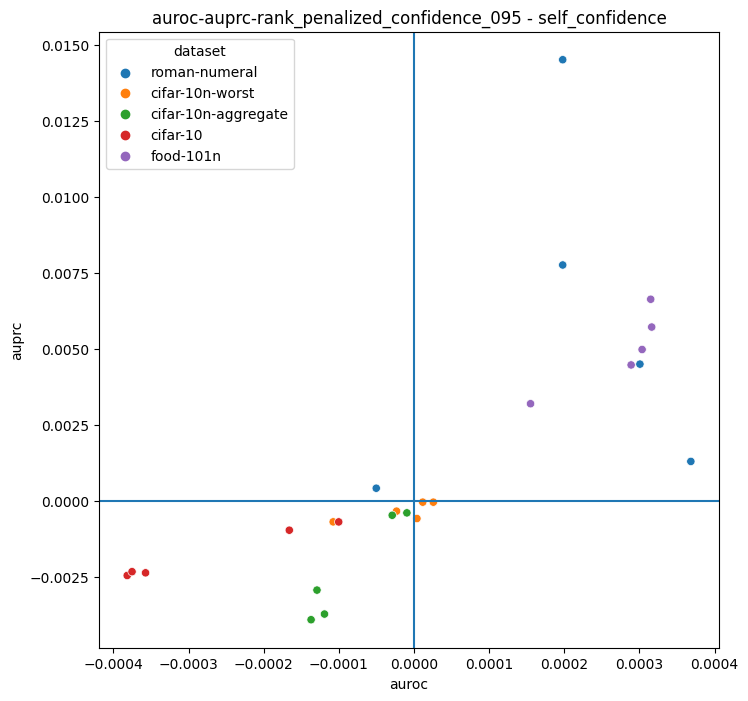

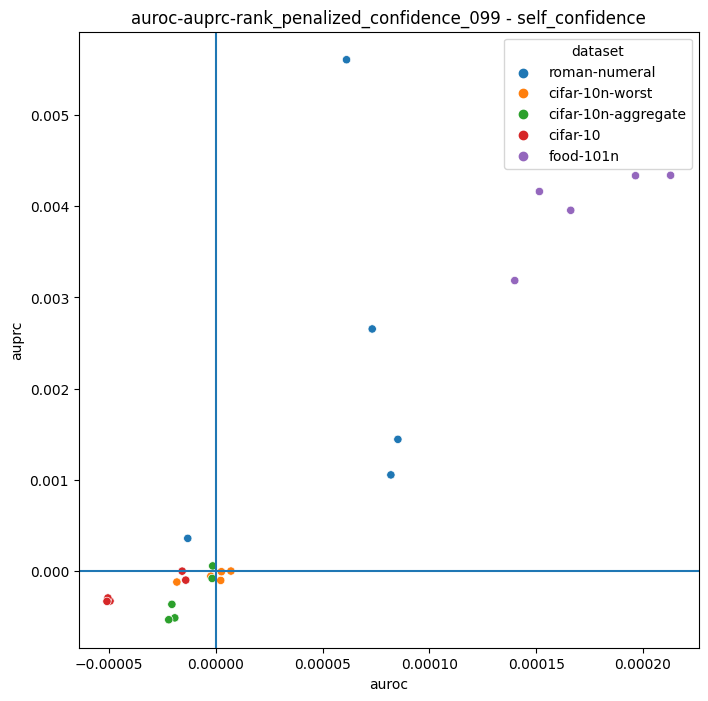

In [361]:
# args to pass to get_label_quality_scores()
score_params = \
[
    ("self_confidence", False, 0),
#     ("self_confidence", True, 0),
    ("rank_penalized_confidence_01", False, 0.1),
    ("rank_penalized_confidence_05", False, 0.5),
    ("rank_penalized_confidence_08", False, 0.8),
    ("rank_penalized_confidence_095", False, 0.95),
    ("rank_penalized_confidence_099", False, 0.99),
#     ("penalized_confidence", False),
#     ("rank_penalized_confidence", False),
]

new_methods = [param[0] for param in score_params if "self_confidence" not in param]
print(new_methods)
    
evaluations, precision_recall_curves, accuracy_list = eval_exp(experiments, score_params)
dfs_new_methods_results = vis_results(evaluations, new_methods)

for method in set(dfs_new_methods_results['method'].tolist()):
    print(method)
    print(display(HTML(dfs_new_methods_results.loc[dfs_new_methods_results['method'] == method].describe().to_html())))                              
    
for method in new_methods:
    scatterplot(dfs_new_methods_results, method, hue='dataset')

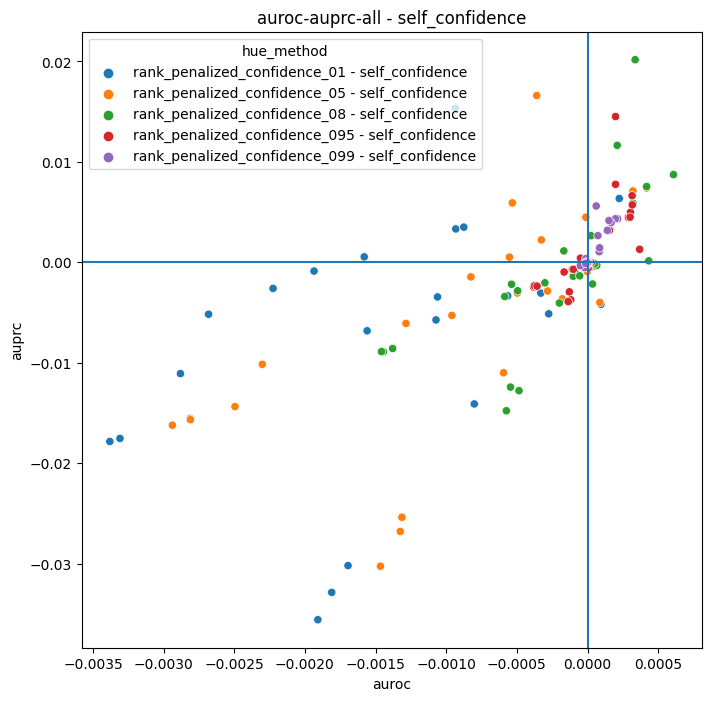

In [362]:
dfs_new_methods_results['hue_method'] = dfs_new_methods_results['method']
dfs_new_methods_results['method'] = 'all - self_confidence'
scatterplot(dfs_new_methods_results, 'all', hue='hue_method')

## Balanced Entropic Confidence Alphas

['balanced_entropic_confidence_1', 'balanced_entropic_confidence_01', 'balanced_entropic_confidence_001', 'balanced_entropic_confidence_0001', 'balanced_entropic_confidence_00001']
balanced_entropic_confidence_0001 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,2.500000e+01,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,8.074856e-07,-0.000106,0.000010,-0.014314
std,19582.096464,6761.278694,9.723255e-06,0.000232,0.000745,0.056706
min,2831.000000,372.000000,-1.976277e-05,-0.000788,-0.002783,-0.216979
25%,50000.000000,4505.000000,-3.474542e-06,-0.000036,0.000000,0.000000
50%,50000.000000,9746.000000,-1.110223e-16,-0.000012,0.000000,0.000000
75%,50000.000000,9973.000000,5.465986e-06,-0.000003,0.000000,0.000000
max,52867.000000,20104.000000,1.883965e-05,0.000092,0.001670,0.076102


None
balanced_entropic_confidence_00001 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,2.500000e+01,2.500000e+01,25.000000,25.000000
mean,41139.600000,8940.000000,1.693632e-07,-4.585415e-06,-0.000047,-0.002170
std,19582.096464,6761.278694,1.514189e-06,8.721947e-05,0.000147,0.010849
min,2831.000000,372.000000,-3.279592e-06,-1.798360e-04,-0.000557,-0.054245
25%,50000.000000,4505.000000,-3.482058e-07,-4.164466e-06,0.000000,0.000000
50%,50000.000000,9746.000000,-2.220446e-16,-1.570320e-06,0.000000,0.000000
75%,50000.000000,9973.000000,2.367597e-07,-8.462294e-07,0.000000,0.000000
max,52867.000000,20104.000000,4.372789e-06,3.588265e-04,0.000000,0.000000


None
balanced_entropic_confidence_1 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.016022,-0.057721,-0.209789,-0.388218
std,19582.096464,6761.278694,0.009043,0.030056,0.184946,0.442877
min,2831.000000,372.000000,-0.032330,-0.117890,-0.564042,-1.301876
25%,50000.000000,4505.000000,-0.024296,-0.073322,-0.327321,-0.684919
50%,50000.000000,9746.000000,-0.012991,-0.054280,-0.143203,-0.149224
75%,50000.000000,9973.000000,-0.009466,-0.039671,-0.058144,0.000000
max,52867.000000,20104.000000,-0.001556,-0.009043,0.040915,0.000000


None
balanced_entropic_confidence_01 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,-0.000590,-0.006486,-0.002599,-0.128596
std,19582.096464,6761.278694,0.000839,0.009118,0.016772,0.316742
min,2831.000000,372.000000,-0.002316,-0.029503,-0.029564,-0.867917
25%,50000.000000,4505.000000,-0.000839,-0.006454,-0.012318,0.000000
50%,50000.000000,9746.000000,-0.000470,-0.003082,-0.004701,0.000000
75%,50000.000000,9973.000000,-0.000027,-0.001511,0.001113,0.000000
max,52867.000000,20104.000000,0.000541,0.004413,0.040915,0.152204


None
balanced_entropic_confidence_001 - self_confidence


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δauprc,Δlift_at_num_label_errors,Δlift_at_100
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,41139.600000,8940.000000,0.000003,-0.000722,-0.001213,-0.041547
std,19582.096464,6761.278694,0.000083,0.001359,0.004416,0.121020
min,2831.000000,372.000000,-0.000195,-0.004345,-0.020458,-0.325469
25%,50000.000000,4505.000000,-0.000025,-0.000371,-0.001361,0.000000
50%,50000.000000,9746.000000,0.000003,-0.000183,-0.000495,0.000000
75%,50000.000000,9973.000000,0.000040,-0.000031,0.000000,0.000000
max,52867.000000,20104.000000,0.000129,0.000598,0.002783,0.110988


None


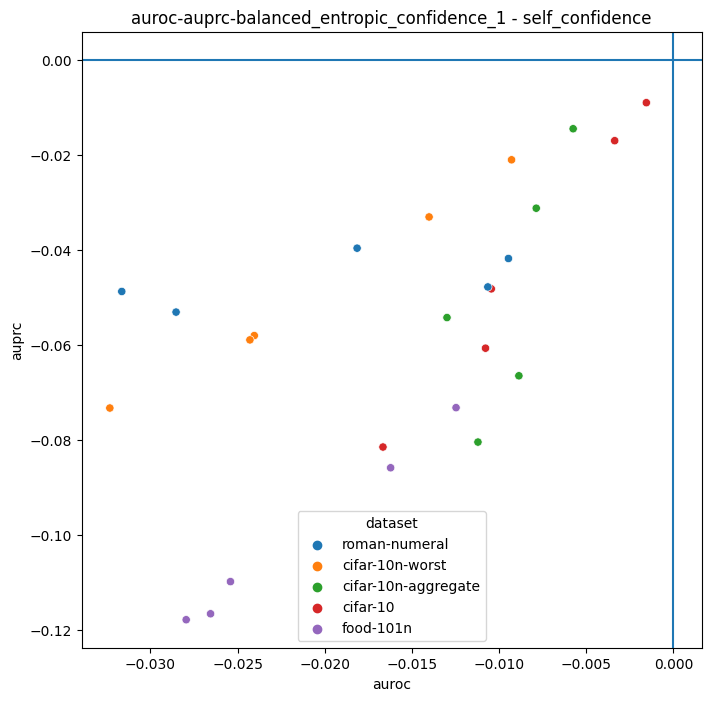

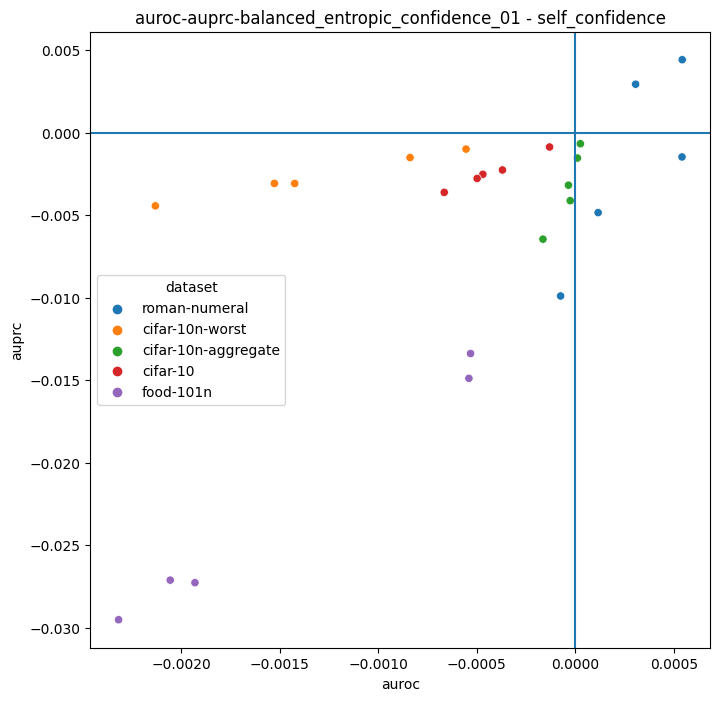

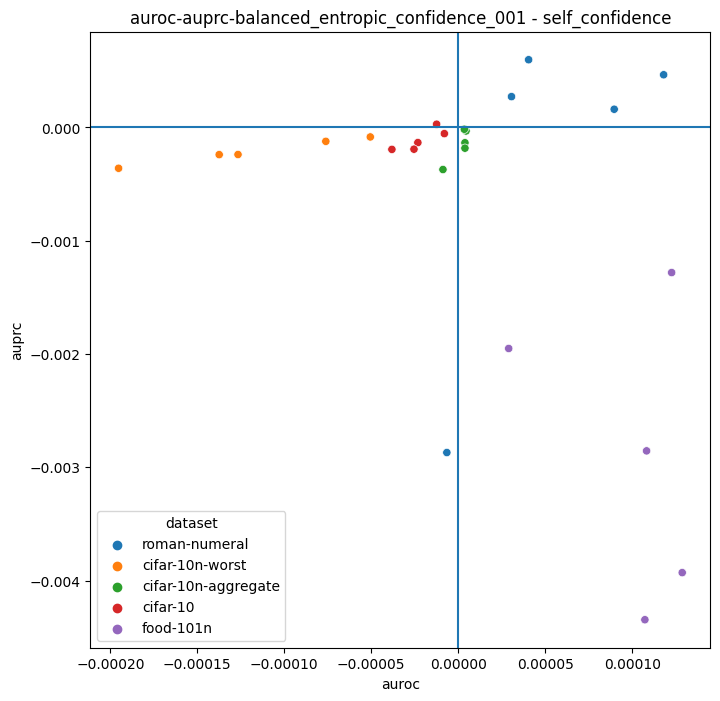

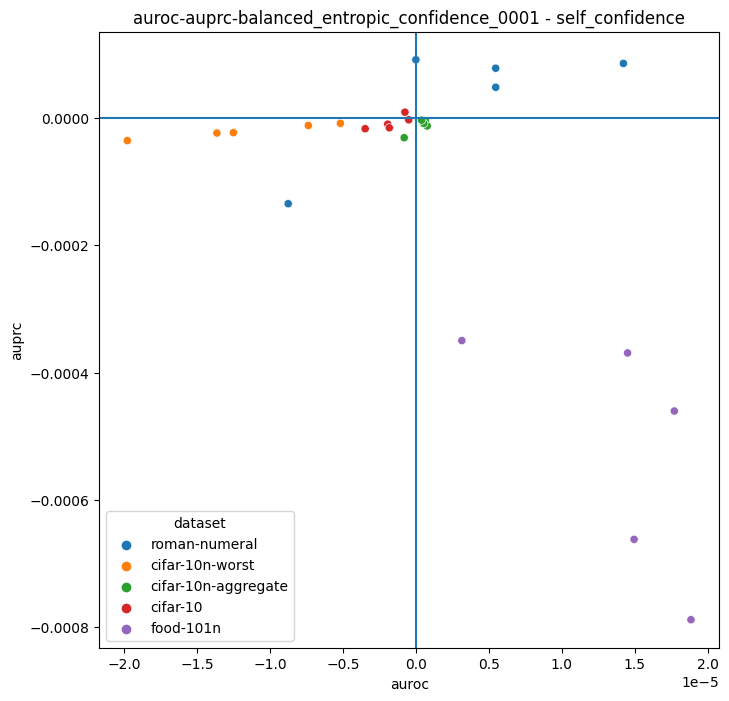

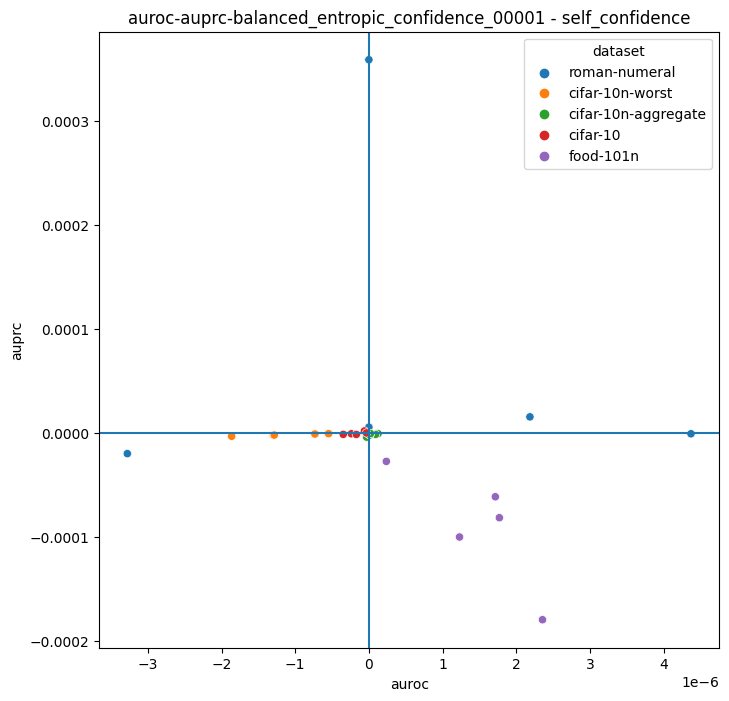

In [363]:
# args to pass to get_label_quality_scores()
score_params = \
[
    ("self_confidence", False, 0),
#     ("self_confidence", True, 0),
    ("balanced_entropic_confidence_1", False, 1),
    ("balanced_entropic_confidence_01", False, 0.1),
    ("balanced_entropic_confidence_001", False, 0.01),
    ("balanced_entropic_confidence_0001", False, 0.001),
    ("balanced_entropic_confidence_00001", False, 0.0001),
]

new_methods = [param[0] for param in score_params if "self_confidence" not in param]
print(new_methods)
    
evaluations, precision_recall_curves, accuracy_list = eval_exp(experiments, score_params)
dfs_new_methods_results = vis_results(evaluations, new_methods)

for method in set(dfs_new_methods_results['method'].tolist()):
    print(method)
    print(display(HTML(dfs_new_methods_results.loc[dfs_new_methods_results['method'] == method].describe().to_html())))                              
    
for method in new_methods:
    scatterplot(dfs_new_methods_results, method, hue='dataset')

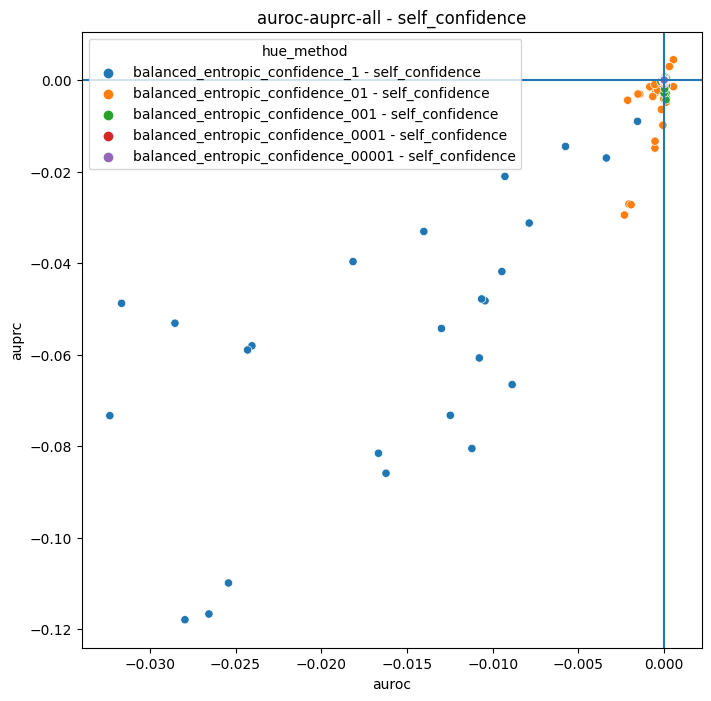

In [364]:
dfs_new_methods_results['hue_method'] = dfs_new_methods_results['method']
dfs_new_methods_results['method'] = 'all - self_confidence'
scatterplot(dfs_new_methods_results, 'all', hue='hue_method')

### Plotting New Methods (no difference)

In [ ]:
method_adjust_pred_probs_display_dict = {
    "self_confidence-False": "Self Confidence",
    "self_confidence-True": "Adjusted Self Confidence",
    "normalized_margin-False": "Normalized Margin",
    "normalized_margin-True": "Adjusted Normalized Margin",
    "confidence_weighted_entropy-False": "Confidence Weighted Entropy",
    "entropy-False": "Entropy",
    "least_confidence-False": "Least Confidence",
    "magl-False": "Mass Above Given Label",
    "penalized_confidence-False": "Penalized Confidence",
    "rank_penalized_confidence-False": "Rank Penalized Confidence",
    "entropic_confidence-False": "Entropic Confidence",
}

In [ ]:
def new_methods_draw_plot_lift(df, title="LIFT", alpha=1, markersize=8):
    # pointer
    df = df.sort_values(by=["dataset", "Self Confidence"])
    df["dataset_model"] = df.dataset + " | " + df.model_name_w_acc

    labels = df["dataset_model"].tolist()
    x = np.arange(len(labels))  # the label locations

    s0 = df["Self Confidence"].tolist()
    s1 = df["Mass Above Given Label"].tolist()
    s2 = df["Penalized Confidence"].tolist()
    s3 = df["Rank Penalized Confidence"].tolist()
    s4 = df["Entropic Confidence"].tolist()


    jf = 0.15 # jitter factor

    fig, ax = plt.subplots()
    _ = ax.plot(s0, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Self Confidence", markersize=markersize, alpha=alpha)
    _ = ax.plot(s1, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Mass Above Given Label", markersize=markersize, alpha=alpha)
    _ = ax.plot(s2, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Penalized Confidence", markersize=markersize, alpha=alpha)
    _ = ax.plot(s3, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Rank Penalized Confidence", markersize=markersize, alpha=alpha)
    _ = ax.plot(s4, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Entropic Confidence", markersize=markersize, alpha=alpha)

    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_xlabel("Dataset | Model(accuracy)")
    ax.set_title(title, fontsize=24, fontweight="bold")
    ax.set_yticks(x, labels)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(fontsize=12)
    
    # plot horizontal lines between each model group
    a = [(x[i] + x[i+1]) / 2 for i in range(4,len(x)-4,5)]    
    [ax.axhline(y=i, linestyle='solid',c='black',linewidth=0.75) for i in a]

    fig.tight_layout()
    plt.savefig(f'./figs/scatter-new-methods-difference-{title}.png', dpi=300)
    plt.show()

In [ ]:
# args to pass to get_label_quality_scores()
score_params = \
[
    ("self_confidence", False, 0),
    ("rank_penalized_confidence", False, 0.5),
    ("penalized_confidence", False, 0),
    ("entropic_confidence", False, 0),
    ("magl", False, 0.99),
]

new_methods = [param[0] for param in score_params if "self_confidence" not in param]
    
evaluations, precision_recall_curves, accuracy_list = eval_exp(experiments, score_params)
# dfs_new_methods_results = vis_results(evaluations, new_methods)
evals = pd.DataFrame(evaluations)

df_auroc, df_lift_at_num_errors, df_lift_at_100 = create_mixed_df(evals, accuracy_list, delta=False)
evals.head()

In [ ]:
new_methods_draw_plot_lift(df_auroc, title="AUROC")

In [ ]:
new_methods_draw_plot_lift(df_lift_at_num_errors, title="Lift at # Errors")

In [ ]:
new_methods_draw_plot_lift(df_lift_at_100, title="Lift at 100")

### Evaluate change in results between xval and single pass pred_probs

In [ ]:
xval_evaluations = evaluations[:len(evaluations)//2].copy()
noxval_evaluations = evaluations[len(evaluations)//2:].copy()

comparison_evaluations = []
for xval,noxval in zip(xval_evaluations, noxval_evaluations):
    delta_auroc = noxval["auroc"] - xval["auroc"]
    delta_lift_at_num_label_errors = noxval["lift_at_num_label_errors"] - xval["lift_at_num_label_errors"]
    delta_lift_at_100 = noxval["lift_at_100"] - xval["lift_at_100"]
    delta_MAE = noxval["MAE_label_issues"] - xval["MAE_label_issues"]
    
    evaluation_results = {
        "method": noxval["method"],
        "adjust_pred_probs": noxval["adjust_pred_probs"],
        "dataset": noxval["dataset"],
        "model": noxval["model"],
        "dataset_num_samples": noxval["dataset_num_samples"],
        "dataset_num_label_errors": noxval["dataset_num_label_errors"],
        "Δauroc": delta_auroc,
        "Δlift_at_num_label_errors": delta_lift_at_num_label_errors,
        "Δlift_at_100": delta_lift_at_100,
        "ΔMAE_label_issues": delta_MAE
    }
    
    comparison_evaluations.append(evaluation_results)

In [310]:
from IPython.display import display, HTML

df_comparison_evaluations = pd.DataFrame(comparison_evaluations)
for dataset in set(df_comparison_evaluations['dataset'].tolist()):
    print(dataset)
    print(display(HTML(df_comparison_evaluations.loc[df_comparison_evaluations['dataset'] == dataset].loc[df_comparison_evaluations['method'] == 'self_confidence'].loc[df_comparison_evaluations['model'] == 'swin_base_patch4_window7_224'].describe().to_html())))                              

cifar-10


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δlift_at_num_label_errors,Δlift_at_100,ΔMAE_label_issues
count,2.0,2.0,2.000000,2.000000,2.000000,2.00000
mean,50000.0,9973.0,-0.004573,-0.237028,-0.050135,0.02622
std,0.0,0.0,0.000517,0.052254,0.070902,0.00000
min,50000.0,9973.0,-0.004939,-0.273977,-0.100271,0.02622
25%,50000.0,9973.0,-0.004756,-0.255503,-0.075203,0.02622
50%,50000.0,9973.0,-0.004573,-0.237028,-0.050135,0.02622
75%,50000.0,9973.0,-0.004391,-0.218554,-0.025068,0.02622
max,50000.0,9973.0,-0.004208,-0.200079,0.000000,0.02622


None
food-101n


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δlift_at_num_label_errors,Δlift_at_100,ΔMAE_label_issues
count,2.0,2.0,2.000000,2.000000,2.000000,2.000000
mean,52867.0,9746.0,-0.005929,-0.084323,0.027122,0.005504
std,0.0,0.0,0.002897,0.000394,0.115071,0.000000
min,52867.0,9746.0,-0.007977,-0.084601,-0.054245,0.005504
25%,52867.0,9746.0,-0.006953,-0.084462,-0.013561,0.005504
50%,52867.0,9746.0,-0.005929,-0.084323,0.027122,0.005504
75%,52867.0,9746.0,-0.004904,-0.084184,0.067806,0.005504
max,52867.0,9746.0,-0.003880,-0.084044,0.108490,0.005504


None
cifar-10n-worst


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δlift_at_num_label_errors,Δlift_at_100,ΔMAE_label_issues
count,2.0,2.0,2.000000,2.000000,2.0,2.00000
mean,50000.0,20104.0,0.000597,0.000371,0.0,-0.00298
std,0.0,0.0,0.001239,0.009272,0.0,0.00000
min,50000.0,20104.0,-0.000279,-0.006186,0.0,-0.00298
25%,50000.0,20104.0,0.000159,-0.002907,0.0,-0.00298
50%,50000.0,20104.0,0.000597,0.000371,0.0,-0.00298
75%,50000.0,20104.0,0.001035,0.003649,0.0,-0.00298
max,50000.0,20104.0,0.001473,0.006928,0.0,-0.00298


None
cifar-10n-aggregate


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δlift_at_num_label_errors,Δlift_at_100,ΔMAE_label_issues
count,2.0,2.0,2.000000,2.000000,2.0,2.0000
mean,50000.0,4505.0,-0.003184,-0.259916,0.0,0.0001
std,0.0,0.0,0.000334,0.001742,0.0,0.0000
min,50000.0,4505.0,-0.003420,-0.261148,0.0,0.0001
25%,50000.0,4505.0,-0.003302,-0.260532,0.0,0.0001
50%,50000.0,4505.0,-0.003184,-0.259916,0.0,0.0001
75%,50000.0,4505.0,-0.003066,-0.259300,0.0,0.0001
max,50000.0,4505.0,-0.002948,-0.258684,0.0,0.0001


None
roman-numeral


,dataset_num_samples,dataset_num_label_errors,Δauroc,Δlift_at_num_label_errors,Δlift_at_100,ΔMAE_label_issues
count,2.0,2.0,2.000000,2.000000,2.000000,2.00000
mean,2880.0,373.0,-0.282196,-3.232576,-4.776681,-0.00302
std,0.0,0.0,0.104243,0.015152,0.322874,0.00000
min,2880.0,373.0,-0.355907,-3.243290,-5.004988,-0.00302
25%,2880.0,373.0,-0.319051,-3.237933,-4.890834,-0.00302
50%,2880.0,373.0,-0.282196,-3.232576,-4.776681,-0.00302
75%,2880.0,373.0,-0.245341,-3.227219,-4.662528,-0.00302
max,2880.0,373.0,-0.208485,-3.221862,-4.548375,-0.00302


None


In [195]:
# cross-validation accuracy
df_cv_accuracy = pd.DataFrame(accuracy_list[:len(accuracy_list)//2])
df_nocv_accuracy = pd.DataFrame(accuracy_list[len(accuracy_list)//2:])

df_accuracy =  df_cv_accuracy.copy()
df_accuracy['nocv_accuracy'] = df_nocv_accuracy["cv_accuracy"].tolist()
df_accuracy['Δaccuracy'] = df_accuracy["nocv_accuracy"].to_numpy() - df_accuracy["cv_accuracy"].to_numpy()

df_cv_accuracy_pivot = (
    pd.pivot_table(
        df_cv_accuracy, values="cv_accuracy", index=["model"], columns=["dataset"]
    )
    .reset_index()
    .sort_values(by="roman-numeral", ascending=False)
)

df_cv_accuracy_pivot["model"] = df_cv_accuracy_pivot.model.map(
    lambda x: model_display_name_dict[x]
)

df_nocv_accuracy_pivot = (
    pd.pivot_table(
        df_nocv_accuracy, values="cv_accuracy", index=["model"], columns=["dataset"]
    )
    .reset_index()
    .sort_values(by="roman-numeral", ascending=False)
)

df_nocv_accuracy_pivot["model"] = df_nocv_accuracy_pivot.model.map(
    lambda x: model_display_name_dict[x]
)

In [196]:
df_cv_accuracy_pivot

dataset,model,cifar-10,cifar-10n-aggregate,cifar-10n-worst,food-101n,roman-numeral
3,Swin Transformer,0.79048,0.90628,0.60592,0.726805,0.821971
4,Twins PCPVT,0.78098,0.89714,0.60154,0.682694,0.816319
1,ResNet-18,0.73976,0.87448,0.57788,0.612291,0.783116
0,EfficientNet-B1,0.73582,0.87154,0.58040,0.627140,0.711409
2,ResNet-50d,0.75506,0.87878,0.59190,0.628748,0.708937


In [197]:
df_nocv_accuracy_pivot

dataset,model,cifar-10,cifar-10n-aggregate,cifar-10n-worst,food-101n,roman-numeral
2,ResNet-50d,0.76422,0.90936,0.61268,0.718407,0.983681
4,Twins PCPVT,0.77734,0.88794,0.59656,0.693646,0.982639
0,EfficientNet-B1,0.78496,0.91052,0.62034,0.749390,0.973611
1,ResNet-18,0.76530,0.92606,0.62598,0.686572,0.959375
3,Swin Transformer,0.78358,0.90338,0.60482,0.697486,0.947917


In [198]:
df_accuracy

,dataset,model,cv_accuracy,nocv_accuracy,Δaccuracy
0,roman-numeral,resnet18,0.783116,0.959375,0.176259
1,cifar-10n-worst,resnet18,0.577880,0.625980,0.048100
2,cifar-10n-aggregate,resnet18,0.874480,0.926060,0.051580
3,cifar-10,resnet18,0.739760,0.765300,0.025540
4,food-101n,resnet18,0.612291,0.686572,0.074281
5,roman-numeral,resnet50d,0.708937,0.983681,0.274744
6,cifar-10n-worst,resnet50d,0.591900,0.612680,0.020780
7,cifar-10n-aggregate,resnet50d,0.878780,0.909360,0.030580
8,cifar-10,resnet50d,0.755060,0.764220,0.009160
9,food-101n,resnet50d,0.628748,0.718407,0.089659


In [199]:
# master table with AUROC and Lift at K evaluation metrics for all methods, datasets, and models
df_evaluations = pd.DataFrame(evaluations)

# append cv accuracy
df_evaluations = df_evaluations.merge(df_cv_accuracy, how="left", on=["dataset", "model"])

In [200]:
df_evaluations["method_adjust_pred_probs"] = (
    df_evaluations.method + "-" + df_evaluations.adjust_pred_probs.astype(str)
)
df_evaluations["dataset_model"] = df_evaluations.dataset + " | " + df_evaluations.model

df_evaluations["scoring_method"] = df_evaluations.method_adjust_pred_probs.map(
    lambda x: method_adjust_pred_probs_display_dict[x]
)
df_evaluations["model_name"] = df_evaluations.model.map(
    lambda x: model_display_name_dict[x]
)


df_evaluations["model_name_w_acc"] = df_evaluations.model_name + " (" + df_evaluations.cv_accuracy.round(4).astype(str) + ") "

In [201]:
# df_evaluations.to_csv("evaluation_all_experiments.csv")
df_evaluations.head(10)

,method,adjust_pred_probs,dataset,model,dataset_num_samples,dataset_num_label_errors,auroc,auprc,lift_at_num_label_errors,lift_at_100,cv_accuracy,method_adjust_pred_probs,dataset_model,scoring_method,model_name,model_name_w_acc
0,self_confidence,False,roman-numeral,resnet18,2831,372,0.812958,0.508662,3.825565,5.935968,0.783116,self_confidence-False,roman-numeral | resnet18,Self Confidence,ResNet-18,ResNet-18 (0.7831)
1,self_confidence,True,roman-numeral,resnet18,2831,372,0.817624,0.502700,3.968768,5.707661,0.783116,self_confidence-True,roman-numeral | resnet18,Adjusted Self Confidence,ResNet-18,ResNet-18 (0.7831)
2,normalized_margin,False,roman-numeral,resnet18,2831,372,0.803109,0.416644,3.539159,4.261720,0.783116,normalized_margin-False,roman-numeral | resnet18,Normalized Margin,ResNet-18,ResNet-18 (0.7831)
3,normalized_margin,True,roman-numeral,resnet18,2831,372,0.804237,0.407956,3.477786,4.109516,0.783116,normalized_margin-True,roman-numeral | resnet18,Adjusted Normalized Margin,ResNet-18,ResNet-18 (0.7831)
4,confidence_weighted_entropy,False,roman-numeral,resnet18,2831,372,0.810511,0.514628,3.846023,6.012070,0.783116,confidence_weighted_entropy-False,roman-numeral | resnet18,Confidence Weighted Entropy,ResNet-18,ResNet-18 (0.7831)
5,magl,False,roman-numeral,resnet18,2831,372,0.807268,0.474059,3.784650,5.403253,0.783116,magl-False,roman-numeral | resnet18,Mass Above Given Label,ResNet-18,ResNet-18 (0.7831)
6,entropy,False,roman-numeral,resnet18,2831,372,0.732535,NaN,2.679941,3.576801,0.783116,entropy-False,roman-numeral | resnet18,Entropy,ResNet-18,ResNet-18 (0.7831)
7,least_confidence,False,roman-numeral,resnet18,2831,372,0.727816,NaN,2.598111,3.196290,0.783116,least_confidence-False,roman-numeral | resnet18,Least Confidence,ResNet-18,ResNet-18 (0.7831)
8,self_confidence,False,cifar-10n-worst,resnet18,50000,20104,0.963435,0.951197,2.173462,2.487067,0.577880,self_confidence-False,cifar-10n-worst | resnet18,Self Confidence,ResNet-18,ResNet-18 (0.5779)
9,self_confidence,True,cifar-10n-worst,resnet18,50000,20104,0.956146,0.935252,2.148844,2.487067,0.577880,self_confidence-True,cifar-10n-worst | resnet18,Adjusted Self Confidence,ResNet-18,ResNet-18 (0.5779)


In [391]:
df_comparison_evaluations.head(10)

,method,adjust_pred_probs,dataset,model,dataset_num_samples,dataset_num_label_errors,Δauroc,Δlift_at_num_label_errors,Δlift_at_100,ΔMAE_label_issues
0,self_confidence,False,roman-numeral,resnet18,2880,373,-0.343248,-2.935456,-4.932214,-0.010025
1,self_confidence,True,roman-numeral,resnet18,2880,373,-0.217444,-2.995858,-4.703908,-0.010025
2,normalized_margin,False,roman-numeral,resnet18,2880,373,-0.336897,-2.711151,-3.566814,-0.010025
3,normalized_margin,True,roman-numeral,resnet18,2880,373,-0.211382,-2.484176,-3.337398,-0.010025
4,confidence_weighted_entropy,False,roman-numeral,resnet18,2880,373,-0.338977,-2.935213,-5.085528,-0.010025
5,magl,False,roman-numeral,resnet18,2880,373,-0.337775,-2.894541,-4.708347,-0.010025
6,entropy,False,roman-numeral,resnet18,2880,373,-0.260452,-1.789832,-2.573048,-0.010025
7,least_confidence,False,roman-numeral,resnet18,2880,373,-0.258080,-1.708002,-2.424172,-0.010025
8,self_confidence,False,cifar-10n-worst,resnet18,50000,20104,-0.000596,0.015340,0.000000,0.031200
9,self_confidence,True,cifar-10n-worst,resnet18,50000,20104,0.001380,0.016825,0.000000,0.031200


# Creating comparison plots

In [220]:
# def create_mixed_df(df, accuracy_list):
#     df_cv_accuracy = pd.DataFrame(accuracy_list)
#     df = df.merge(df_cv_accuracy, how="left", on=["dataset", "model"])
#     df.head()
#     df["method_adjust_pred_probs"] = (
#         df.method + "-" + df.adjust_pred_probs.astype(str)
#     )
#     df["dataset_model"] = df.dataset + " | " + df.model

#     df["scoring_method"] = df.method_adjust_pred_probs.map(
#         lambda x: method_adjust_pred_probs_display_dict[x]
#     )
#     df["model_name"] = df.model.map(
#         lambda x: model_display_name_dict[x]
#     )


#     df["model_name_w_acc"] = df.model_name + " (" + df.cv_accuracy.round(4).astype(str) + ") "

#     df_auroc = (
#         pd.pivot_table(
#             df,
#             values="Δauroc",
#             index=["dataset", "model_name", "model_name_w_acc"],
#             columns=["scoring_method"],
#         )
#         .reset_index()
#         .sort_values(by=["dataset", "model_name"])
#     )

#     df_lift_at_num_errors = (
#         pd.pivot_table(
#             df,
#             values="Δlift_at_num_label_errors",
#             index=["dataset", "model_name", "model_name_w_acc"],
#             columns=["scoring_method"],
#         )
#         .reset_index()
#         .sort_values(by=["dataset", "model_name"])
#     )

#     df_lift_at_100 = (
#         pd.pivot_table(
#             df,
#             values="Δlift_at_100",
#             index=["dataset", "model_name", "model_name_w_acc"],
#             columns=["scoring_method"],
#         )
#         .reset_index()
#         .sort_values(by=["dataset", "model_name"])
#     )
    
#     return df_auroc, df_lift_at_num_errors, df_lift_at_100

In [221]:
df_auroc, df_lift_at_num_errors, df_lift_at_100 = df_comparison_evaluations = create_mixed_df(df, accuracy_list)

AttributeError: 'DataFrame' object has no attribute 'method'

In [198]:
# def draw_plot_auroc(df, title="AUROC",alpha=0.9):
#     df['dataset_model'] = df.apply(lambda x: x['dataset'] + ' | ' + x['model_name_w_acc'],axis=1)

#     # Draw plot
#     plt.figure(figsize=(10, 10), dpi=80)

#     s = 60
#     marker = "o"

#     s0 = plt.scatter(
#         df["Confidence Weighted Entropy"], df.index, s=s, alpha=alpha, marker=marker
#     )
#     s1 = plt.scatter(df["Self Confidence"], df.index, s=s, alpha=alpha, marker=marker)
#     s2 = plt.scatter(df["Adjusted Self Confidence"], df.index, s=s, alpha=alpha, marker=marker)
#     s3 = plt.scatter(
#         df["Normalized Margin"], df.index, s=s, alpha=alpha, marker=marker
#     )
#     s4 = plt.scatter(
#         df["Adjusted Normalized Margin"], df.index, s=s, alpha=alpha, marker=marker
#     )
#     # s5 = plt.scatter(df["entropy-False"], df.index, s=s, alpha=alpha, marker=marker)
#     # s6 = plt.scatter(df["least_confidence-False"], df.index, s=s, alpha=alpha, marker=marker)

#     # for x, y, tex in zip(df["confidence_weighted_entropy-False"], df.index, df["confidence_weighted_entropy-False"]):
#     #     t = plt.text(x, y, round(tex, 1), horizontalalignment='center',
#     #                  verticalalignment='center', fontdict={'color':'white'})

#     plt.title("AUROC", fontsize=18)
#     plt.yticks(df.index, df.dataset_model)
#     plt.legend(
#         (s0, s1, s2, s3, s4),
#         (
#             "Confidence Weighted Entropy (False)",
#             "Self Confidence (False)",
#             "Self Confidence (True)",
#             "Normalized Margin (False)",
#             "Normalized Margin (True)",
#         ),
#         loc="upper center",
#         bbox_to_anchor=(0.5, 1.2),
#         ncol=3,
#         fancybox=True,
#         shadow=True,
#         fontsize=12,
#     )

#     plt.show()
    
# def draw_plot_lift(df, title="LIFT", alpha=1, markersize=8):
#     # pointer
#     df = df.sort_values(by=["dataset", "Confidence Weighted Entropy"])
#     df["dataset_model"] = df.dataset + " | " + df.model_name_w_acc

#     labels = df["dataset_model"].tolist()
#     x = np.arange(len(labels))  # the label locations

#     s0 = df["Confidence Weighted Entropy"].tolist()
#     s1 = df["Self Confidence"].tolist()
#     s2 = df["Adjusted Self Confidence"].tolist()
#     s3 = df["Normalized Margin"].tolist()
#     s4 = df["Adjusted Normalized Margin"].tolist()


#     jf = 0.15 # jitter factor

#     fig, ax = plt.subplots()
#     _ = ax.plot(s0, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Confidence Weighted Entropy", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s1, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Self Confidence", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s2, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Adjusted Self Confidence", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s3, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Normalized Margin", markersize=markersize, alpha=alpha)
#     _ = ax.plot(s4, x + np.random.uniform(-jf, jf), marker="o", linestyle="None", label="Adjusted Normalized Margin", markersize=markersize, alpha=alpha)

#     # Add some text for labels, title and custom x-axis tick labels, etc.
#     ax.set_xlabel("Dataset | Model(accuracy)")
#     ax.set_title(title, fontsize=24, fontweight="bold")
#     ax.set_yticks(x, labels)
#     ax.tick_params(axis='both', which='major', labelsize=12)
#     ax.legend(fontsize=12)
    
#     # plot horizontal lines between each model group
#     a = [(x[i] + x[i+1]) / 2 for i in range(4,len(x)-4,5)]    
#     [ax.axhline(y=i, linestyle='solid',c='black',linewidth=0.75) for i in a]

#     fig.tight_layout()
#     plt.savefig(f'./figs/scatter-difference-{title}.png', dpi=300)
#     plt.show()

In [199]:
# draw_plot_auroc(df_auroc, title="AUROC")

In [200]:
draw_plot_lift(df_auroc, title="AUROC")

NameError: name 'df_auroc' is not defined

In [201]:
draw_plot_lift(df_lift_at_num_errors, title="Lift at # Errors", alpha=1, markersize=8)

NameError: name 'df_lift_at_num_errors' is not defined

In [202]:
draw_plot_lift(df_lift_at_100, title="Lift at 100", alpha=1, markersize=8)

NameError: name 'df_lift_at_100' is not defined

### Just plotting values not change 
AUROC for LED achieved by label quality scores for each dataset and model. Models are ordered by accuracy on each dataset.

In [203]:
df_evaluations_auroc = (
    pd.pivot_table(
        df_evaluations,
        values="auroc",
        index=["dataset", "model_name", "model_name_w_acc"],
        columns=["scoring_method"],
    )
    .reset_index()
    .sort_values(by=["dataset", "model_name"])
)

df_evaluations_lift_at_num_errors = (
    pd.pivot_table(
        df_evaluations,
        values="lift_at_num_label_errors",
        index=["dataset", "model_name", "model_name_w_acc"],
        columns=["scoring_method"],
    )
    .reset_index()
    .sort_values(by=["dataset", "model_name"])
)

df_evaluations_lift_at_100 = (
    pd.pivot_table(
        df_evaluations,
        values="lift_at_100",
        index=["dataset", "model_name", "model_name_w_acc"],
        columns=["scoring_method"],
    )
    .reset_index()
    .sort_values(by=["dataset", "model_name"])
)

NameError: name 'df_evaluations' is not defined

In [204]:
# draw_plot_auroc(df_evaluations_auroc, title="AUROC")
# draw_plot_lift(df_evaluations_lift_at_num_errors, title="Lift at # Errors", alpha=1, markersize=8)
# draw_plot_lift(df_evaluations_lift_at_100, title="Lift at 100", alpha=1, markersize=8)

## Precision/recall curve for Swin Transformer model Food 101N dataset 
### xval results (comparable to s5 in paper)

In [205]:
%%time

def get_df_filter_by(labels, pred_probs, label_errors_target):
    # pointer
    true_label_issues = label_errors_target

    # code below adapted from v2.0.0 docs
    # https://colab.research.google.com/github/cleanlab/cleanlab-docs/blob/master/v2.0.0/tutorials/indepth_overview.ipynb#scrollTo=kCfdx2gOLmXS

    # Find label issues with different filter_by options
    filter_by_list = [
        "prune_by_noise_rate",
        "prune_by_class",
        "both",
        "confident_learning",
        "predicted_neq_given",
    ]

    results = []

    for filter_by in filter_by_list:

        # Find label issues
        label_issues = cleanlab.filter.find_label_issues(
            labels=labels, 
            pred_probs=pred_probs, 
            filter_by=filter_by
        )

        precision = precision_score(true_label_issues, label_issues)
        recall = recall_score(true_label_issues, label_issues)
        f1 = f1_score(true_label_issues, label_issues)
        acc = accuracy_score(true_label_issues, label_issues)

        result = {
            "filter_by": filter_by,
            "precision": precision,
            "recall": recall,
            "f1": f1,
            "accuracy": acc,
            "num_est_label_issues": label_issues.sum()
        }

        results.append(result)

    # summary of results
    # pd.DataFrame(results).sort_values(by='f1', ascending=False)

    df_filter_by = pd.DataFrame(results)

    return df_filter_by

def plot_curve(labels, pred_probs, label_errors_target,  model='swin_base_patch4_window7_224', dataset='food-101n', marker="o", linestyle='solid'):
    plt.rcParams["figure.figsize"] = (15, 10)

    score_params = \
    [
        ("self_confidence", False),
        # ("self_confidence", True),
        ("normalized_margin", False),
        # ("normalized_margin", True),
        ("confidence_weighted_entropy", False)
    ]

    df_list = []

    for score_param in score_params:

        method, adjust_pred_probs = score_param
        label_quality_scores = get_label_quality_scores(labels, pred_probs, method=method, adjust_pred_probs=adjust_pred_probs)

        # compute accuracy of detecting label errors
        auroc = roc_auc_score(label_errors_target, 1 - label_quality_scores)

        # compute precision-recall curve
        precision, recall, thresholds = precision_recall_curve(label_errors_target, 1 - label_quality_scores)

        # save to DataFrame
        # ignore last precision, recall value because it's always 1, 0 respectively with no corresponding threshold
        # https://stackoverflow.com/questions/31639016/in-scikits-precision-recall-curve-why-does-thresholds-have-a-different-dimensi
        df_temp = pd.DataFrame({
            "precision": precision[:-1],
            "recall": recall[:-1],
            "thresholds": thresholds,
            "model": model,
            "method": method,
            "adjust_pred_probs": adjust_pred_probs
        })

        df_list.append(df_temp)

        # plot
        plt.plot(recall, precision, label=f"{method}-{str(adjust_pred_probs)}", linestyle=linestyle)

    # combine DataFrames
    # df_all = pd.concat(df_list)
    df_filter_by = get_df_filter_by(labels, pred_probs, label_errors_target)
    
    # plot single dot (precision, recall) for each filter_by option
    for index, row in df_filter_by.iterrows():
        filter_by = row["filter_by"]
        precision = row["precision"]
        recall = row["recall"]
        plt.plot(recall, precision, marker=marker, markersize=10, label=filter_by)

    plt.xlabel("Recall", fontsize=14)
    plt.ylabel("Precision", fontsize=14)
    plt.title(f"Precision-Recall Curve: Label Error Detection on {dataset} \n Model: {model}", fontsize=20, fontweight="bold")
    # plt.suptitle("")
    plt.legend()
#     plt.show()

CPU times: user 4 µs, sys: 1 µs, total: 5 µs
Wall time: 7.63 µs


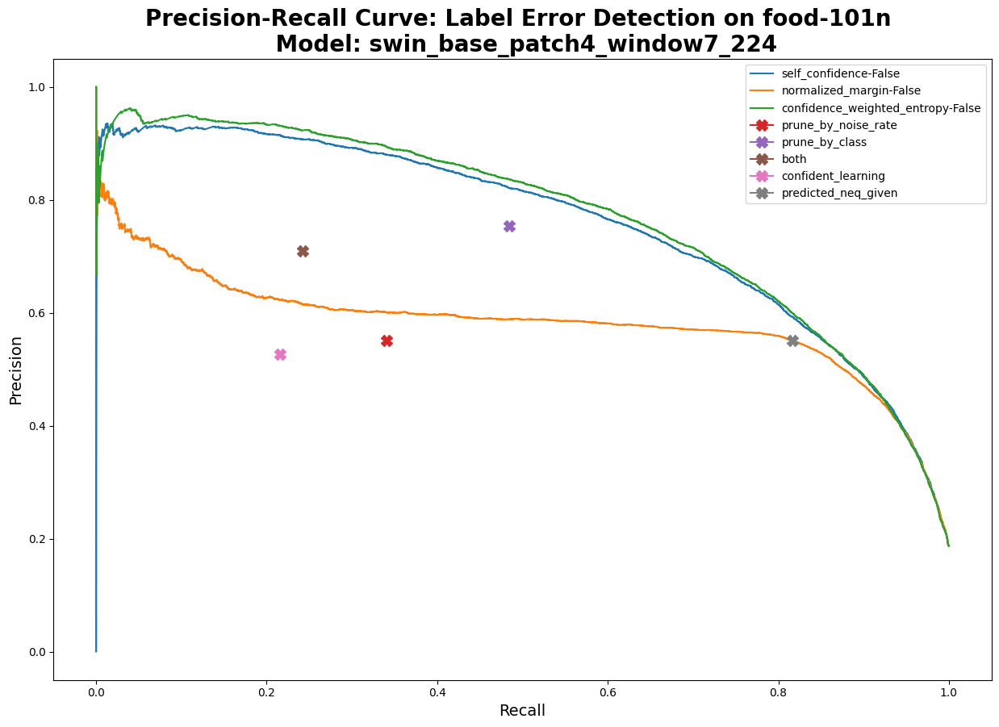

In [206]:
df = pd.DataFrame(experiments)
swin_food_results_xval = df.loc[df['model']=='swin_base_patch4_window7_224'].loc[df['dataset']=='food-101n'].iloc[0]

labels = swin_food_results_xval["labels"]
pred_probs = swin_food_results_xval["pred_probs"]
label_errors_target = swin_food_results_xval["label_errors_mask"]

plot_curve(labels, pred_probs, label_errors_target, marker="X", linestyle='solid')
plt.show()

In [207]:
swin_food_results = df.loc[df['model']=='swin_base_patch4_window7_224'].loc[df['dataset']=='food-101n'].iloc[1]

labels = swin_food_results["labels"]
pred_probs = swin_food_results["pred_probs"]
label_errors_target = swin_food_results["label_errors_mask"]

plot_curve(labels, pred_probs, label_errors_target, marker="o", linestyle='dotted')
plt.show()

IndexError: single positional indexer is out-of-bounds

In [ ]:
labels = swin_food_results_xval["labels"]
pred_probs = swin_food_results_xval["pred_probs"]
label_errors_target = swin_food_results_xval["label_errors_mask"]
plot_curve(labels, pred_probs, label_errors_target, marker="X", linestyle='solid')

labels = swin_food_results["labels"]
pred_probs = swin_food_results["pred_probs"]
label_errors_target = swin_food_results["label_errors_mask"]
plot_curve(labels, pred_probs, label_errors_target, marker="o", linestyle='dotted')
plt.show()

In [ ]:
df = pd.DataFrame(experiments)

models = ["resnet18","resnet50d","efficientnet_b1","twins_pcpvt_base","swin_base_patch4_window7_224"]
datasets = ['cifar-10', 'cifar-10n-aggregate', 'cifar-10n-worst', 'food-101n', 'roman-numeral']

for model in models:
    for dataset in datasets:
        swin_food_results_xval = df.loc[df['model']==model].loc[df['dataset']==dataset].iloc[0]
        labels = swin_food_results_xval["labels"]
        pred_probs = swin_food_results_xval["pred_probs"]
        label_errors_target = swin_food_results_xval["label_errors_mask"]
        plot_curve(labels, pred_probs, label_errors_target, model=model, dataset=dataset, marker="X", linestyle='solid')

        swin_food_results = df.loc[df['model']==model].loc[df['dataset']==dataset].iloc[1]
        labels = swin_food_results["labels"]
        pred_probs = swin_food_results["pred_probs"]
        label_errors_target = swin_food_results["label_errors_mask"]
        plot_curve(labels, pred_probs, label_errors_target, model=model, dataset=dataset, marker="o", linestyle='dotted')
        
        plt.savefig(f'./figs/prc-{model}-{dataset}-{len(swin_food_results_xval)*2}.png', dpi=300)
        plt.show()


#### Plot curves side by side for paper

In [ ]:
labels = swin_food_results_xval["labels"]
pred_probs = swin_food_results_xval["pred_probs"]
label_errors_target = swin_food_results_xval["label_errors_mask"]
marker = "o"
linestyle = "solid"

score_params = \
[
    ("self_confidence", False),
    # ("self_confidence", True),
    ("normalized_margin", False),
    # ("normalized_margin", True),
    ("confidence_weighted_entropy", False)
]

df_list = []

plt.rcParams["figure.figsize"] = (30, 10)
# plt.suptitle(f"Precision-Recall Curve: Label Error Detection on {dataset} \n Model: {model}")

for score_param in score_params:

    method, adjust_pred_probs = score_param
    label_quality_scores = get_label_quality_scores(labels, pred_probs, method=method, adjust_pred_probs=adjust_pred_probs)

    # compute accuracy of detecting label errors
    auroc = roc_auc_score(label_errors_target, 1 - label_quality_scores)

    # compute precision-recall curve
    precision, recall, thresholds = precision_recall_curve(label_errors_target, 1 - label_quality_scores)

    # save to DataFrame
    # ignore last precision, recall value because it's always 1, 0 respectively with no corresponding threshold
    # https://stackoverflow.com/questions/31639016/in-scikits-precision-recall-curve-why-does-thresholds-have-a-different-dimensi
    df_temp = pd.DataFrame({
        "precision": precision[:-1],
        "recall": recall[:-1],
        "thresholds": thresholds,
        "model": model,
        "method": method,
        "adjust_pred_probs": adjust_pred_probs
    })

    df_list.append(df_temp)

    # plot
    plt.subplot(1, 2, 1)
    plt.plot(recall, precision, label=f"{method}-{str(adjust_pred_probs)}", linestyle=linestyle)

# combine DataFrames
# df_all = pd.concat(df_list)
df_filter_by = get_df_filter_by(labels, pred_probs, label_errors_target)

# plot single dot (precision, recall) for each filter_by option
for index, row in df_filter_by.iterrows():
    filter_by = row["filter_by"]
    precision = row["precision"]
    recall = row["recall"]
    plt.plot(recall, precision, marker=marker, markersize=10, label=filter_by)
    plt.grid(visible=True, which='major', axis='both')


plt.xlabel("Recall", fontsize=14)
plt.ylabel("Precision", fontsize=14)
plt.title(f"Training: 5-fold Cross Validation", fontsize=20, fontweight="bold")
# plt.suptitle("")
plt.legend()

labels = swin_food_results["labels"]
pred_probs = swin_food_results["pred_probs"]
label_errors_target = swin_food_results["label_errors_mask"]
marker = "o"
linestyle = "solid"

df_list = []

for score_param in score_params:

    method, adjust_pred_probs = score_param
    label_quality_scores = get_label_quality_scores(labels, pred_probs, method=method, adjust_pred_probs=adjust_pred_probs)

    # compute accuracy of detecting label errors
    auroc = roc_auc_score(label_errors_target, 1 - label_quality_scores)

    # compute precision-recall curve
    precision, recall, thresholds = precision_recall_curve(label_errors_target, 1 - label_quality_scores)

    # save to DataFrame
    # ignore last precision, recall value because it's always 1, 0 respectively with no corresponding threshold
    # https://stackoverflow.com/questions/31639016/in-scikits-precision-recall-curve-why-does-thresholds-have-a-different-dimensi
    df_temp = pd.DataFrame({
        "precision": precision[:-1],
        "recall": recall[:-1],
        "thresholds": thresholds,
        "model": model,
        "method": method,
        "adjust_pred_probs": adjust_pred_probs
    })

    df_list.append(df_temp)

    # plot
    plt.subplot(1, 2, 2)
    plt.plot(recall, precision, label=f"{method}-{str(adjust_pred_probs)}", linestyle=linestyle)
    plt.grid(visible=True, which='major', axis='both')

# combine DataFrames
# df_all = pd.concat(df_list)
df_filter_by = get_df_filter_by(labels, pred_probs, label_errors_target)

# plot single dot (precision, recall) for each filter_by option
for index, row in df_filter_by.iterrows():
    filter_by = row["filter_by"]
    precision = row["precision"]
    recall = row["recall"]
    plt.plot(recall, precision, marker=marker, markersize=10, label=filter_by)

plt.xlabel("Recall", fontsize=14)
plt.ylabel("Precision", fontsize=14)
plt.title(f"Training: Single Pass", fontsize=20, fontweight="bold")
# plt.suptitle("")
plt.legend()

plt.savefig(f'./figs/prc-5fold-vs-single-pass.png', dpi=300)

plt.show()

## Generating DF filter-by S2 table plots

In [ ]:
models = ["swin_base_patch4_window7_224"]
datasets = ['roman-numeral', 'food-101n', 'cifar-10n-worst', 'cifar-10n-aggregate', 'cifar-10']

dfs = []
df = pd.DataFrame(experiments)

for model in models:
    for dataset in datasets:
        results = df.loc[df['model']==model].loc[df['dataset']==dataset].iloc[0]

        labels = results["labels"]
        pred_probs = results["pred_probs"]
        label_errors_target = results["label_errors_mask"]
        
        df_filter_by_xval = get_df_filter_by(labels, pred_probs, label_errors_target)
        df_filter_by_xval['model'] = model
        df_filter_by_xval['dataset'] = dataset
        
        results = df.loc[df['model']==model].loc[df['dataset']==dataset].iloc[1]

        labels = results["labels"]
        pred_probs = results["pred_probs"]
        label_errors_target = results["label_errors_mask"]
        
        df_filter_by = get_df_filter_by(labels, pred_probs, label_errors_target)
        
        delta_precision = np.round(df_filter_by["precision"].to_numpy() - df_filter_by_xval["precision"].to_numpy(),4)
        delta_recall = np.round(df_filter_by["recall"].to_numpy() - df_filter_by_xval["recall"].to_numpy(),4)
        delta_accuracy = np.round(df_filter_by["accuracy"].to_numpy() - df_filter_by_xval["accuracy"].to_numpy(),4)
        datasets = df_filter_by_xval['dataset'].tolist()
        filter_by = df_filter_by['filter_by'].tolist()
        
        df_filter = pd.DataFrame(zip(datasets,filter_by,delta_precision,delta_recall,delta_accuracy), columns=['dataset','filter_by','Δprecision', 'Δrecall', 'Δaccuracy'])
        dfs.append(df_filter)
        
dfs_filter_by = pd.concat(dfs)

In [ ]:
dfs_filter_by

## Method vs Metric scatterplots 
xval and nonxval between all models/datasets

In [382]:
import seaborn as sns

def scatterplot(evaluations, method, metric='auroc', hue='dataset'):
    plt.figure(figsize=(8,8))
    df = pd.DataFrame(evaluations)
    xval = df.loc[df['method']==method].loc[df['type_train']=='-xval'][metric].tolist()
    noxval = df.loc[df['method']==method].loc[df['type_train']==''][metric].tolist()
    hue_vals = df.loc[df['method']==method].loc[df['type_train']==''][hue].tolist()
    df = pd.DataFrame(zip(xval, noxval, hue_vals), columns=['xval','noxval',hue])
    
    plt.axline((0.5,0.5), slope=1)
    sns.scatterplot(x="xval", y="noxval", data=df, hue=hue)
    
    plt.title(f'{metric}-{method}')
    plt.savefig(f'./figs/scatter-{metric}-{method}-{len(df)}.png', dpi=300)
    plt.show()

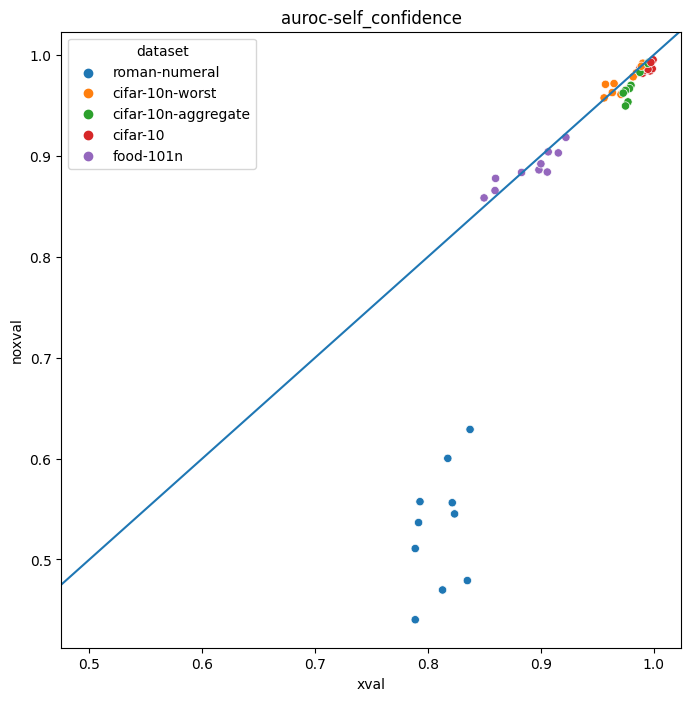

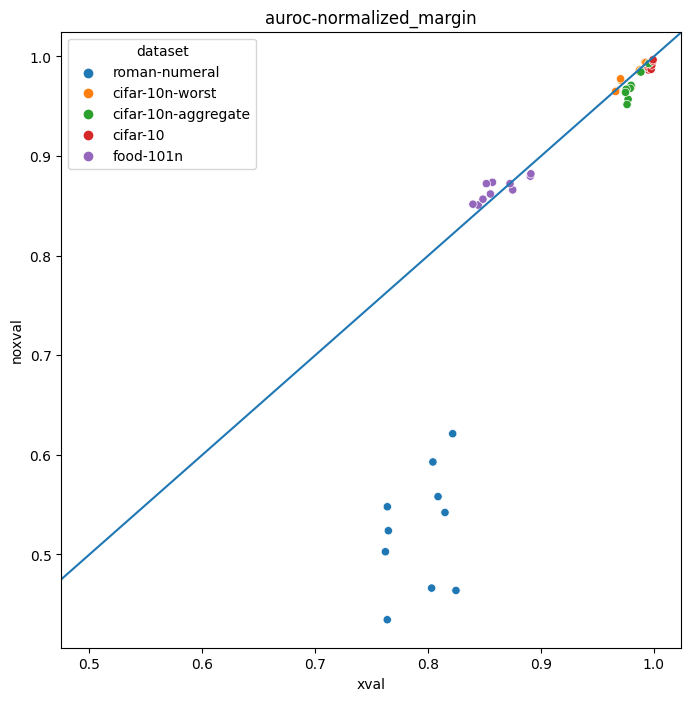

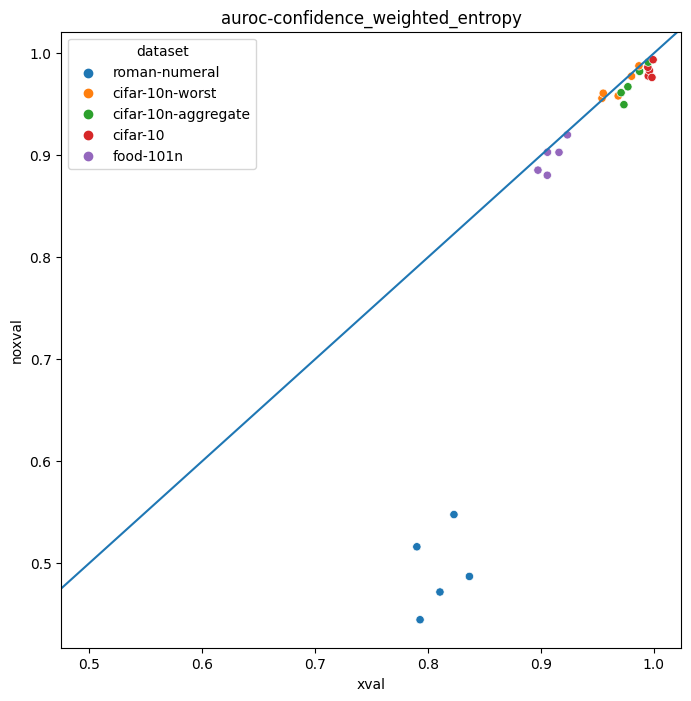

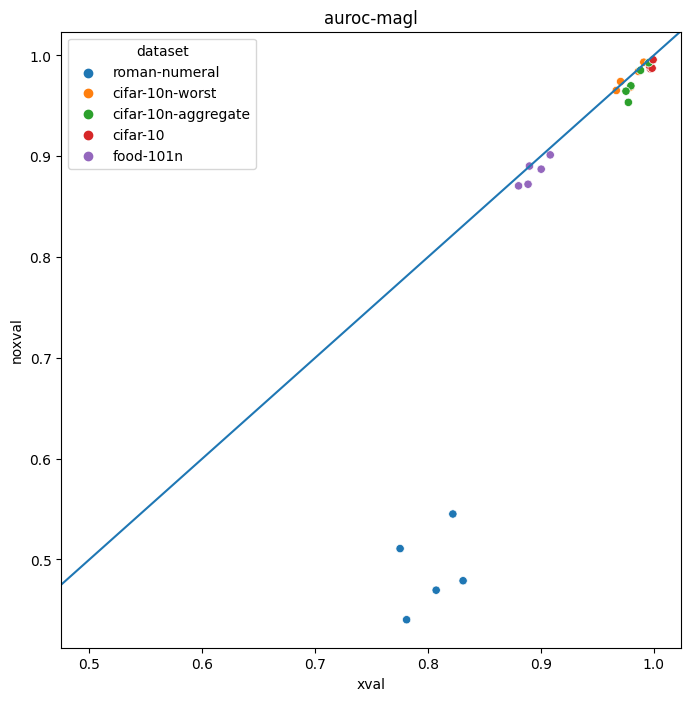

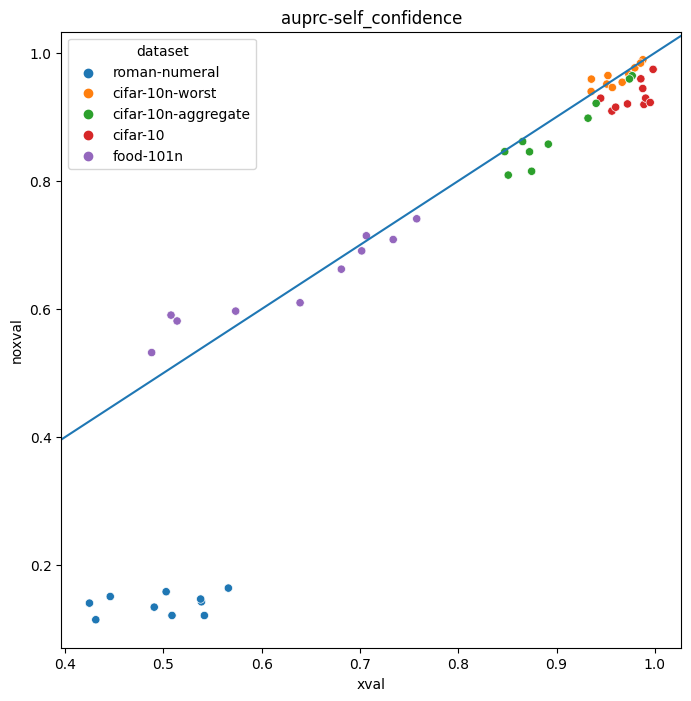

...

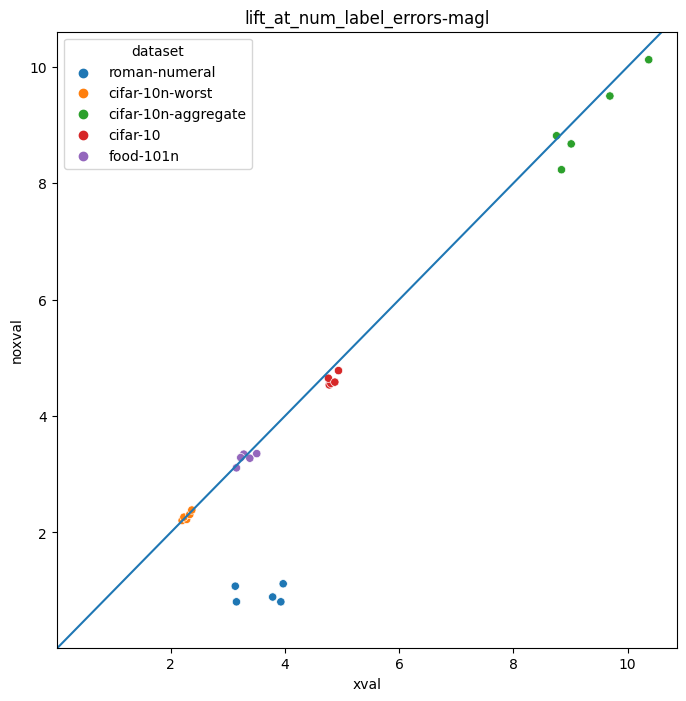

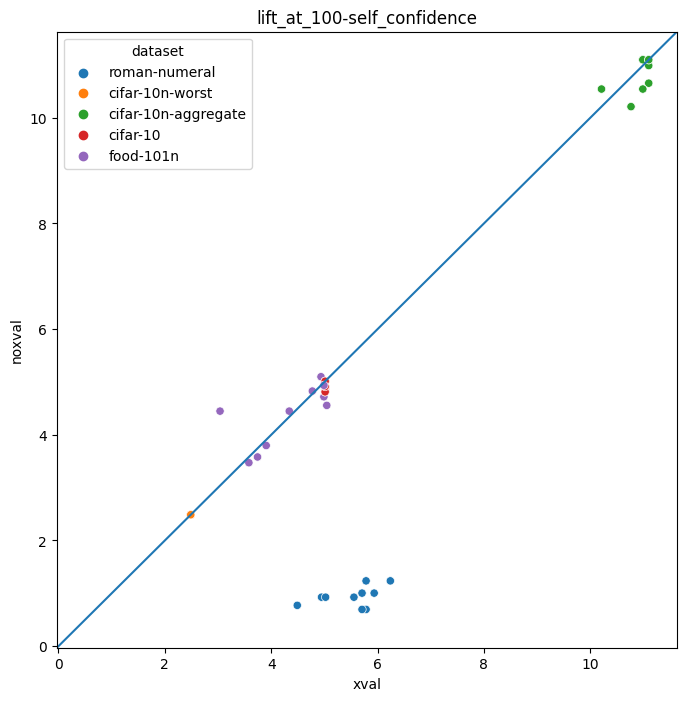

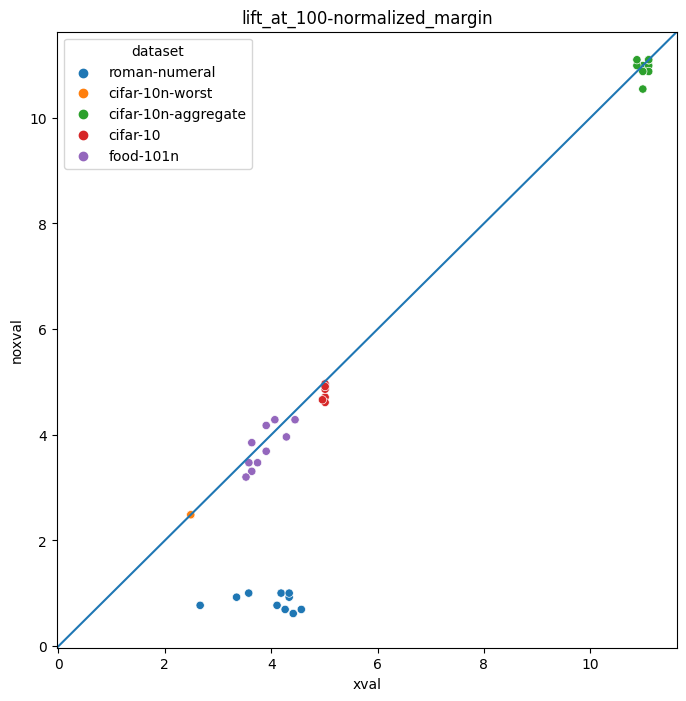

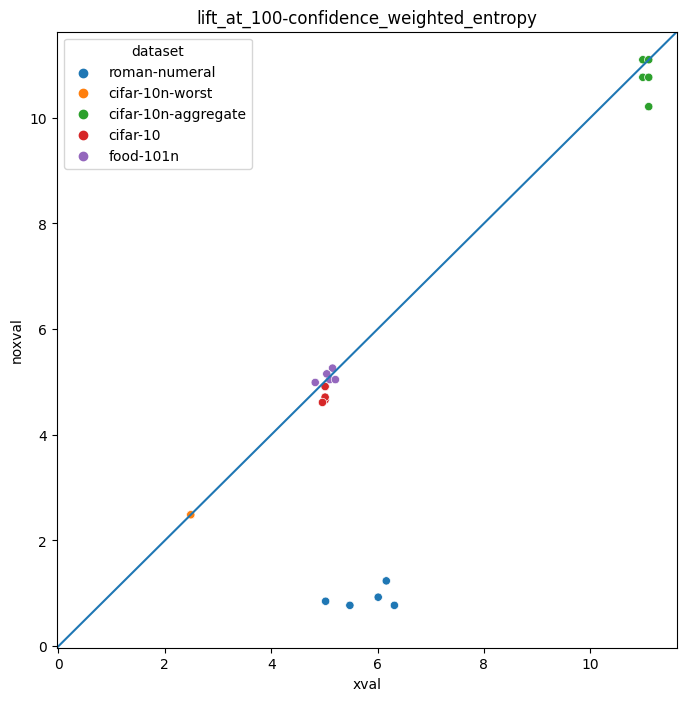

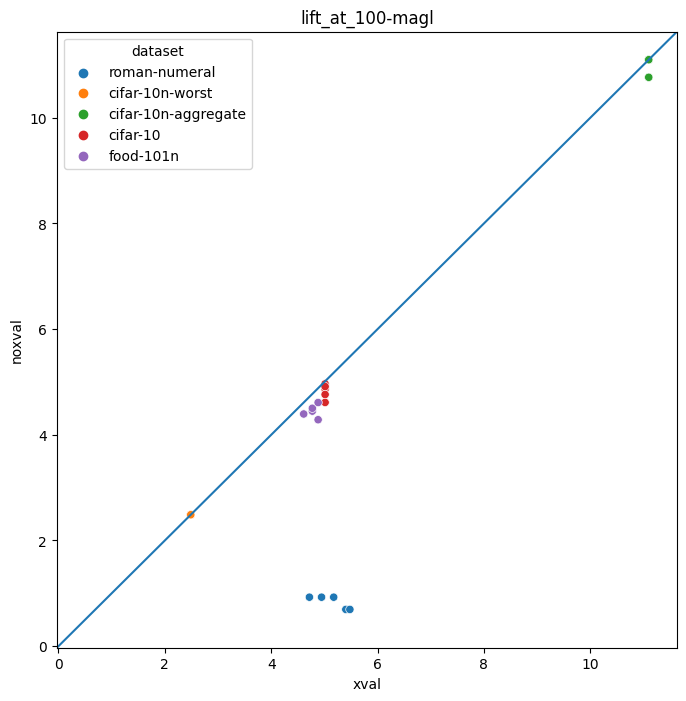

In [383]:
metrics = ['auroc','auprc','lift_at_num_label_errors','lift_at_100']
methods = ['self_confidence','normalized_margin','confidence_weighted_entropy','magl']
for metric in metrics:
    for method in methods:
        scatterplot(evaluations, method=method, metric=metric, hue='dataset')

# MAE for # of issues
(xvalidation will probably help)

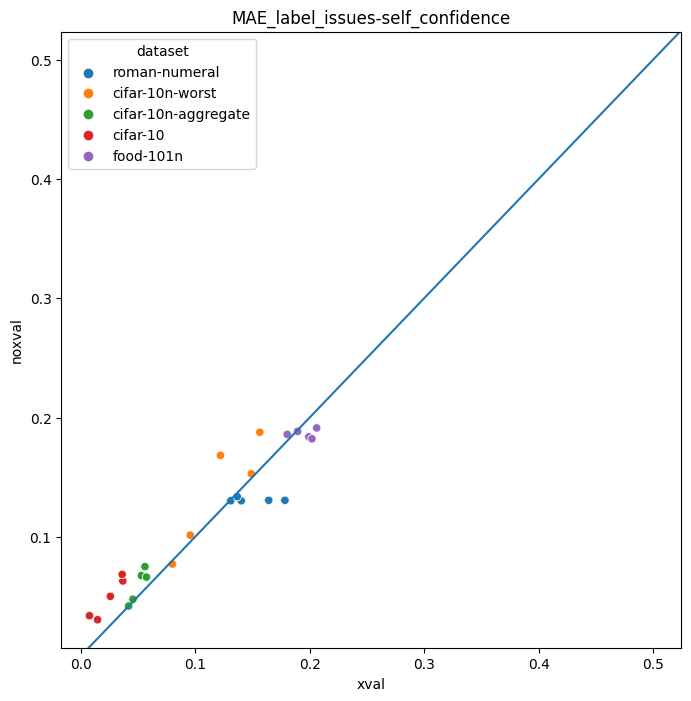

In [384]:
scatterplot(evaluations, method="self_confidence", metric="MAE_label_issues", hue='dataset')

## Evaluate results from ensemble models
### Prepare data

In [ ]:
%%time

dataset_model_output = {}

for i, experiment in enumerate(experiments):

    # experiment results
    dataset = experiment["dataset"]
    model = experiment["model"]
    pred_probs = experiment["pred_probs"]
    labels = experiment["labels"]
    images = experiment["images"]
    label_errors_target = experiment["label_errors_mask"]

    # check
    if dataset not in dataset_model_output.keys():

        # init list of pred_probs and labels
        dataset_model_output[dataset] = {}
        dataset_model_output[dataset]["pred_probs_list"] = []
        dataset_model_output[dataset]["labels_list"] = []
        dataset_model_output[dataset]["images_list"] = []
        dataset_model_output[dataset]["label_errors_target_list"] = []

    # store model output on dataset as key
    dataset_model_output[dataset]["pred_probs_list"].append(pred_probs)
    dataset_model_output[dataset]["labels_list"].append(labels)
    dataset_model_output[dataset]["images_list"].append(images)
    dataset_model_output[dataset]["label_errors_target_list"].append(
        label_errors_target
    )

### Evaluate ensemble models

In [ ]:
%%time

# args to pass to get_label_quality_scores()
score_params = \
[
    ("self_confidence", False),
    ("self_confidence", True),
    ("normalized_margin", False),
    ("normalized_margin", True),
    ("confidence_weighted_entropy", False)
]


ensemble_evaluations = []

dataset_best_weights = []

for dataset_key in dataset_model_output.keys():

    # get list of pred_probs, labels for dataset
    pred_probs_list = dataset_model_output[dataset_key]["pred_probs_list"]
    labels_list = dataset_model_output[dataset_key]["labels_list"]
    images_list = dataset_model_output[dataset_key]["images_list"]
    label_errors_target_list = dataset_model_output[dataset_key]["label_errors_target_list"]
    
    # use for sanity check (noisy labels and images from each model should be the same because they were generated from the same cross-val procedure
    for i, (labels_temp, images_temp) in enumerate(zip(labels_list, images_list)):

        if i == 0:
            labels_temp_previous = copy.deepcopy(labels_temp)
            images_temp_previous = copy.deepcopy(images_temp)       
        else:
            assert (labels_temp_previous == labels_temp).all()
            assert (images_temp_previous == images_temp).all()    
    
    # take the first (the others are the same)
    labels = labels_list[0]
    label_errors_target = label_errors_target_list[0]
    
    # compute accuracy
    accuracy_list = []
    for pred_probs in pred_probs_list:
        
        # accuracy of single model
        accuracy = (pred_probs.argmax(axis=1) == labels).mean()
        accuracy_list.append(accuracy)
        
    # accuracy weights
    acc_weights = np.array(accuracy_list) / sum(accuracy_list)    
    
    # average predictions
    pred_probs_avg = sum(pred_probs_list) / len(pred_probs_list)
    
    #### can refactor below to a function that accepts weights and pred_probs_list
    
    # accuracy-weighted predictions
    pred_probs_avg_acc_weighted = sum([acc_weights[i] * p for i, p in enumerate(pred_probs_list)])
    

    #### find best t in T for exp-log-loss weighting
    T = [1e-4, 1e-3, 1e-2, 1e-1, 1e0, 1e1, 1e2, 2e2]

    pred_probs_avg_log_loss_weighted = None
    inv_log_loss_weights = None
    best_eval_log_loss = float("inf")
    best_t = None

    for t in T:

        log_loss_list = []

        # pred_probs for each model
        for pred_probs in pred_probs_list:
            log_loss_ = np.exp(t * (-log_loss(labels, pred_probs)))
            log_loss_list.append(log_loss_)

        # weights using log loss
        inv_log_loss_weights_temp = np.array(log_loss_list) / sum(log_loss_list)

        # weighted average
        pred_probs_avg_log_loss_weighted_temp = sum([inv_log_loss_weights_temp[i] * p for i, p in enumerate(pred_probs_list)])

        # evaluate log_loss with this weighted average
        eval_log_loss = log_loss(labels, pred_probs_avg_log_loss_weighted_temp)

        # check if this is the best eval_log_loss so far
        if best_eval_log_loss > eval_log_loss:
            best_eval_log_loss = eval_log_loss
            best_t = t
            pred_probs_avg_log_loss_weighted = pred_probs_avg_log_loss_weighted_temp.copy()
            inv_log_loss_weights = inv_log_loss_weights_temp.copy()    

    df_temp = pd.DataFrame({
        "dataset": dataset_key,
        "models": models,
        "best_t": best_t,
        "best_eval_log_loss": best_eval_log_loss,
        "inv_log_loss_weights": inv_log_loss_weights,
    })
    
    # save the weights for analysis later
    dataset_best_weights.append(df_temp)
            
    print()
    print(dataset_key)
    print(best_eval_log_loss)
    print(inv_log_loss_weights)
    print(pred_probs_avg_log_loss_weighted)
    
    
    #### label quality scoring
    
    for score_param in score_params:
        
        # label quality scoring method
        method, adjust_pred_probs = score_param
    
        # compute scores
        
        # use average pred_probs
        label_quality_scores_avg = get_label_quality_scores(labels=labels, pred_probs=pred_probs_avg, method=method, adjust_pred_probs=adjust_pred_probs)
        
        # use average pred_probs weighted by accuracy
        label_quality_scores_avg_acc_weighted = get_label_quality_scores(labels=labels, pred_probs=pred_probs_avg_acc_weighted, method=method, adjust_pred_probs=adjust_pred_probs)
        
        # use average pred_probs weighted by log loss
        label_quality_scores_avg_log_loss_weighted = get_label_quality_scores(labels=labels, pred_probs=pred_probs_avg_log_loss_weighted, method=method, adjust_pred_probs=adjust_pred_probs)
        
        # use pred_probs_list (weighted by accuracy)
        label_quality_scores_agg_acc = get_label_quality_ensemble_scores_experimental(
            labels=labels, 
            pred_probs_list=pred_probs_list, 
            method=method, 
            adjust_pred_probs=adjust_pred_probs, 
            verbose=0,
            weight_ensemble_members_by="accuracy"
        )

        # use pred_probs_list (uniform_weights)
        label_quality_scores_agg_uni = get_label_quality_ensemble_scores_experimental(
            labels=labels, 
            pred_probs_list=pred_probs_list, 
            method=method, 
            adjust_pred_probs=adjust_pred_probs,
            verbose=0,
            weight_ensemble_members_by="uniform"
        )
        
        # use pred_probs_list (weight by inverse log loss)
        label_quality_scores_agg_log_loss = get_label_quality_ensemble_scores_experimental(
            labels=labels, 
            pred_probs_list=pred_probs_list, 
            method=method, 
            adjust_pred_probs=adjust_pred_probs,
            verbose=0, 
            weight_ensemble_members_by="custom",
            custom_weights=inv_log_loss_weights # custom weights!
        )        
        
        # compute accuracy of detecting label errors
        auroc_avg = roc_auc_score(label_errors_target, 1 - label_quality_scores_avg)
        auroc_avg_acc_weighted = roc_auc_score(label_errors_target, 1 - label_quality_scores_avg_acc_weighted)
        auroc_avg_log_loss_weighted = roc_auc_score(label_errors_target, 1 - label_quality_scores_avg_log_loss_weighted)        
        
        auroc_agg_acc = roc_auc_score(label_errors_target, 1 - label_quality_scores_agg_acc)
        auroc_agg_uni = roc_auc_score(label_errors_target, 1 - label_quality_scores_agg_uni)
        auroc_agg_log_loss = roc_auc_score(label_errors_target, 1 - label_quality_scores_agg_log_loss)        
        
        # lift at K where K = number of label errors
        lift_at_num_label_errors_avg = lift_at_k(label_errors_target, 1 - label_quality_scores_avg, k=label_errors_target.sum())
        lift_at_num_label_errors_avg_acc_weighted = lift_at_k(label_errors_target, 1 - label_quality_scores_avg_acc_weighted, k=label_errors_target.sum())
        lift_at_num_label_errors_avg_log_loss_weighted = lift_at_k(label_errors_target, 1 - label_quality_scores_avg_log_loss_weighted, k=label_errors_target.sum())
        
        lift_at_num_label_errors_agg_acc = lift_at_k(label_errors_target, 1 - label_quality_scores_agg_acc, k=label_errors_target.sum())
        lift_at_num_label_errors_agg_uni = lift_at_k(label_errors_target, 1 - label_quality_scores_agg_uni, k=label_errors_target.sum())
        lift_at_num_label_errors_agg_log_loss = lift_at_k(label_errors_target, 1 - label_quality_scores_agg_log_loss, k=label_errors_target.sum())        
        
        # lift at k=100
        lift_at_100_avg = lift_at_k(label_errors_target, 1 - label_quality_scores_avg, k=100)
        lift_at_100_avg_acc_weighted = lift_at_k(label_errors_target, 1 - label_quality_scores_avg_acc_weighted, k=100)
        lift_at_100_avg_log_loss_weighted = lift_at_k(label_errors_target, 1 - label_quality_scores_avg_log_loss_weighted, k=100)
        
        lift_at_100_agg_acc = lift_at_k(label_errors_target, 1 - label_quality_scores_agg_acc, k=100)
        lift_at_100_agg_uni = lift_at_k(label_errors_target, 1 - label_quality_scores_agg_uni, k=100)
        lift_at_100_agg_log_loss = lift_at_k(label_errors_target, 1 - label_quality_scores_agg_log_loss, k=100)

        ensemble_evaluation_results_avg = {
            "ensemble_method": "avg_pred_probs",
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset_key,
            "model": "ensemble",
            "dataset_num_samples": labels.shape[0],
            "dataset_num_label_errors": label_errors_target.sum(),
            "auroc": auroc_avg,
            "lift_at_num_label_errors": lift_at_num_label_errors_avg,
            "lift_at_100": lift_at_100_avg
        }
        
        ensemble_evaluation_results_avg_acc_weighted = {
            "ensemble_method": "avg_pred_probs_weighted_by_accuracy",
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset_key,
            "model": "ensemble",
            "dataset_num_samples": labels.shape[0],
            "dataset_num_label_errors": label_errors_target.sum(),
            "auroc": auroc_avg_acc_weighted,
            "lift_at_num_label_errors": lift_at_num_label_errors_avg_acc_weighted,
            "lift_at_100": lift_at_100_avg_acc_weighted
        }        
        
        ensemble_evaluation_results_avg_log_loss_weighted = {
            "ensemble_method": "avg_pred_probs_weighted_by_inv_log_loss",
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset_key,
            "model": "ensemble",
            "dataset_num_samples": labels.shape[0],
            "dataset_num_label_errors": label_errors_target.sum(),
            "auroc": auroc_avg_log_loss_weighted,
            "lift_at_num_label_errors": lift_at_num_label_errors_avg_log_loss_weighted,
            "lift_at_100": lift_at_100_avg_log_loss_weighted
        }                
        
        ensemble_evaluation_results_agg_acc = {
            "ensemble_method": "avg_scores_weighted_by_accuracy",
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset_key,
            "model": "ensemble",
            "dataset_num_samples": labels.shape[0],
            "dataset_num_label_errors": label_errors_target.sum(),
            "auroc": auroc_agg_acc,
            "lift_at_num_label_errors": lift_at_num_label_errors_agg_acc,
            "lift_at_100": lift_at_100_agg_acc
        }
        
        ensemble_evaluation_results_agg_uni = {
            "ensemble_method": "avg_scores",
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset_key,
            "model": "ensemble",
            "dataset_num_samples": labels.shape[0],
            "dataset_num_label_errors": label_errors_target.sum(),
            "auroc": auroc_agg_uni,
            "lift_at_num_label_errors": lift_at_num_label_errors_agg_uni,
            "lift_at_100": lift_at_100_agg_uni
        }
        
        ensemble_evaluation_results_agg_log_loss = {
            "ensemble_method": "avg_scores_weighted_by_inv_log_loss",
            "method": method,
            "adjust_pred_probs": adjust_pred_probs,
            "dataset": dataset_key,
            "model": "ensemble",
            "dataset_num_samples": labels.shape[0],
            "dataset_num_label_errors": label_errors_target.sum(),
            "auroc": auroc_agg_log_loss,
            "lift_at_num_label_errors": lift_at_num_label_errors_agg_log_loss,
            "lift_at_100": lift_at_100_agg_log_loss
        }
        
        # store evaluation results
        ensemble_evaluations.append(ensemble_evaluation_results_avg)
        ensemble_evaluations.append(ensemble_evaluation_results_avg_acc_weighted)
        ensemble_evaluations.append(ensemble_evaluation_results_avg_log_loss_weighted)
        
        ensemble_evaluations.append(ensemble_evaluation_results_agg_acc)
        ensemble_evaluations.append(ensemble_evaluation_results_agg_uni)
        ensemble_evaluations.append(ensemble_evaluation_results_agg_log_loss)

In [ ]:
df_evaluations_ensemble = pd.DataFrame(ensemble_evaluations)

df_evaluations_ensemble["method_adjust_pred_probs"] = (
    df_evaluations_ensemble.method
    + "-"
    + df_evaluations_ensemble.adjust_pred_probs.astype(str)
)
df_evaluations_ensemble["dataset_model"] = (
    df_evaluations_ensemble.dataset + " | " + df_evaluations_ensemble.model
)

df_evaluations_ensemble[
    "scoring_method"
] = df_evaluations_ensemble.method_adjust_pred_probs.map(
    lambda x: method_adjust_pred_probs_display_dict[x]
)

In [ ]:
df_evaluations_ensemble.head(3)

In [ ]:
df_evaluations_ensemble.groupby("ensemble_method")["ensemble_method"].count()

In [ ]:
df_evaluations_ensemble_pivot = pd.pivot_table(
    df_evaluations_ensemble,
    values="auroc",
    index=["scoring_method", "ensemble_method"],
    columns=["dataset"],
).reset_index()

In [ ]:
df_evaluations_ensemble_pivot.head(2)

In [ ]:
df_evaluations_ensemble_auroc = (
    pd.pivot_table(
        df_evaluations_ensemble,
        values="auroc",
        index=["dataset", "scoring_method"],
        columns=["ensemble_method"],
    )
    .reset_index()
    .sort_values(by=["dataset", "scoring_method"])
)

df_evaluations_ensemble_lift_at_num_errors = (
    pd.pivot_table(
        df_evaluations_ensemble,
        values="lift_at_num_label_errors",
        index=["dataset", "scoring_method"],
        columns=["ensemble_method"],
    )
    .reset_index()
    .sort_values(by=["dataset", "scoring_method"])
)

df_evaluations_ensemble_lift_at_100 = (
    pd.pivot_table(
        df_evaluations_ensemble,
        values="lift_at_100",
        index=["dataset", "scoring_method"],
        columns=["ensemble_method"],
    )
    .reset_index()
    .sort_values(by=["dataset", "scoring_method"])
)

df_evaluations_ensemble_auroc["dataset_scoring_method"] = \
    df_evaluations_ensemble_auroc.dataset + " | " + df_evaluations_ensemble_auroc.scoring_method

df_evaluations_ensemble_lift_at_num_errors["dataset_scoring_method"] = \
    df_evaluations_ensemble_lift_at_num_errors.dataset + " | " + df_evaluations_ensemble_lift_at_num_errors.scoring_method

df_evaluations_ensemble_lift_at_100["dataset_scoring_method"] = \
    df_evaluations_ensemble_lift_at_100.dataset + " | " + df_evaluations_ensemble_lift_at_100.scoring_method

df_evaluations_ensemble_lift_at_100.head()

In [ ]:
df_evaluations_ensemble_auroc.head(3)